# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [6]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [7]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:56, 3.21MB/s]                                                                             
SVHN Testing Set: 64.3MB [00:20, 3.12MB/s]                                                                             


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [8]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

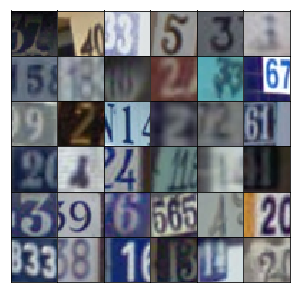

In [37]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [41]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [63]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [73]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [92]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        
        def leaky_relu(input_layer): 
            return tf.maximum(alpha * input_layer,input_layer)

        
        def fully_connected(input_layer, num_units):
  
            layer = tf.layers.dense(input_layer, num_units, use_bias=False, activation=None)
            layer = tf.layers.batch_normalization(layer, training=training, axis=-1)            
            layer = leaky_relu(layer)
 
            return layer
        
        def conv_transpose(input_layer, filters, kernel = 5, stride = 2, activation=leaky_relu):
      
            layer = tf.layers.conv2d_transpose(
                input_layer, 
                filters=filters, 
                kernel_size=kernel, 
                strides=stride, 
                padding='same', 
                activation=None, 
                use_bias=None)

            layer = tf.layers.batch_normalization(layer, training=training, axis=-1)
            
            if activation is not None:
                layer = activation(layer)
            
            return layer
        
        
        x = fully_connected(z, 4 * 4 * 512)
        x = tf.reshape(x,[-1, 4, 4, 512])  # 4x4x512 now
        
        x = conv_transpose(x, 256) # 8x8*256 now
        x = conv_transpose(x, 128) # 16*16*128 now
        
        out = tf.layers.conv2d_transpose(
            x, 
            filters=output_dim, 
            kernel_size=5, 
            strides=2, 
            padding='same', 
            activation=tf.tanh) #32*32*3 now
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [124]:
def discriminator(x, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('discriminator', reuse=reuse):
        
        def leaky_relu(input_layer): 
            return tf.maximum(alpha * input_layer,input_layer)

        
        def fully_connected(input_layer, num_units):
  
            layer = tf.layers.dense(input_layer, num_units, activation=None)
 
            return layer
        
        def conv(input_layer, filters, kernel = 5, stride = 2, activation=leaky_relu):
      
            layer = tf.layers.conv2d(
                input_layer, 
                filters=filters, 
                kernel_size=kernel, 
                strides=stride, 
                padding='same', 
                activation=None, 
                use_bias=None)

            layer = tf.layers.batch_normalization(layer, training=training, axis=-1)
            
            if activation is not None:
                layer = activation(layer)
            
            return layer
        
        
        # Input layer is 32x32x3
        x = tf.layers.conv2d(
                x, 
                filters=64, 
                kernel_size=5, 
                strides=2, 
                padding='same', 
                activation=leaky_relu, 
                use_bias=True) # 16x16x64 now

        x = conv(x,128) # 8x8x128 now
        x = conv(x,256) # 4x4x256 now
        x = tf.reshape(x,[-1, 4 * 4 * 256])
        
        logits = fully_connected(x,1)
        out = tf.nn.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [125]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [126]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [127]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [128]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [129]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [130]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.5157... Generator Loss: 0.5084
Epoch 1/25... Discriminator Loss: 0.3270... Generator Loss: 2.1384
Epoch 1/25... Discriminator Loss: 0.2786... Generator Loss: 1.7820
Epoch 1/25... Discriminator Loss: 0.1430... Generator Loss: 2.6889
Epoch 1/25... Discriminator Loss: 0.1416... Generator Loss: 2.9439
Epoch 1/25... Discriminator Loss: 0.0862... Generator Loss: 3.1825
Epoch 1/25... Discriminator Loss: 0.0815... Generator Loss: 3.3441
Epoch 1/25... Discriminator Loss: 0.1329... Generator Loss: 2.9758
Epoch 1/25... Discriminator Loss: 0.0793... Generator Loss: 3.7239
Epoch 1/25... Discriminator Loss: 0.1507... Generator Loss: 2.7744


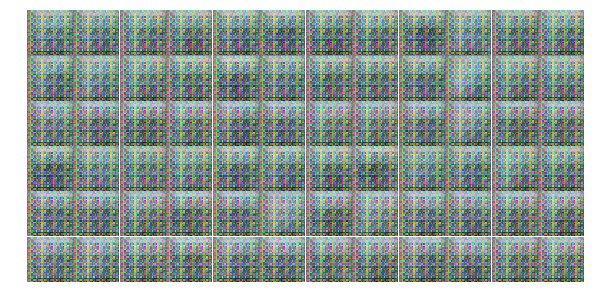

Epoch 1/25... Discriminator Loss: 0.2356... Generator Loss: 2.2990
Epoch 1/25... Discriminator Loss: 0.7062... Generator Loss: 1.9681
Epoch 1/25... Discriminator Loss: 0.6303... Generator Loss: 1.6880
Epoch 1/25... Discriminator Loss: 0.4821... Generator Loss: 1.7321
Epoch 1/25... Discriminator Loss: 0.5396... Generator Loss: 1.5366
Epoch 1/25... Discriminator Loss: 0.4275... Generator Loss: 2.3041
Epoch 1/25... Discriminator Loss: 0.3185... Generator Loss: 2.0211
Epoch 1/25... Discriminator Loss: 0.5693... Generator Loss: 2.5428
Epoch 1/25... Discriminator Loss: 0.4776... Generator Loss: 2.1921
Epoch 1/25... Discriminator Loss: 0.3444... Generator Loss: 4.0911


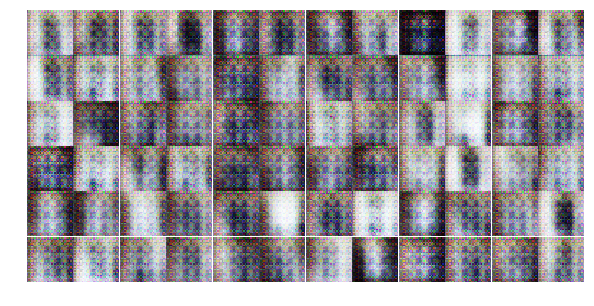

Epoch 1/25... Discriminator Loss: 0.1379... Generator Loss: 3.6282
Epoch 1/25... Discriminator Loss: 0.5339... Generator Loss: 1.3572
Epoch 1/25... Discriminator Loss: 0.5146... Generator Loss: 1.9094
Epoch 1/25... Discriminator Loss: 0.4304... Generator Loss: 2.8196
Epoch 1/25... Discriminator Loss: 0.2482... Generator Loss: 1.9755
Epoch 1/25... Discriminator Loss: 0.7149... Generator Loss: 2.1621
Epoch 1/25... Discriminator Loss: 1.1865... Generator Loss: 0.8827
Epoch 1/25... Discriminator Loss: 0.4899... Generator Loss: 2.1191
Epoch 1/25... Discriminator Loss: 0.6265... Generator Loss: 2.0902
Epoch 1/25... Discriminator Loss: 0.2450... Generator Loss: 2.4246


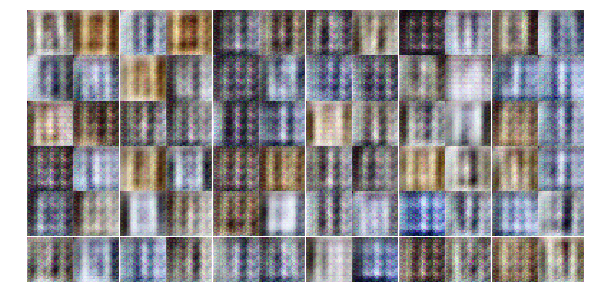

Epoch 1/25... Discriminator Loss: 1.1039... Generator Loss: 0.9682
Epoch 1/25... Discriminator Loss: 0.9910... Generator Loss: 1.2456
Epoch 1/25... Discriminator Loss: 0.7557... Generator Loss: 1.1729
Epoch 1/25... Discriminator Loss: 0.6736... Generator Loss: 1.2924
Epoch 1/25... Discriminator Loss: 1.3637... Generator Loss: 0.6080
Epoch 1/25... Discriminator Loss: 0.9136... Generator Loss: 1.1630
Epoch 1/25... Discriminator Loss: 0.7526... Generator Loss: 0.9687
Epoch 1/25... Discriminator Loss: 0.4119... Generator Loss: 2.1788
Epoch 1/25... Discriminator Loss: 0.3613... Generator Loss: 2.1355
Epoch 1/25... Discriminator Loss: 0.4935... Generator Loss: 1.9942


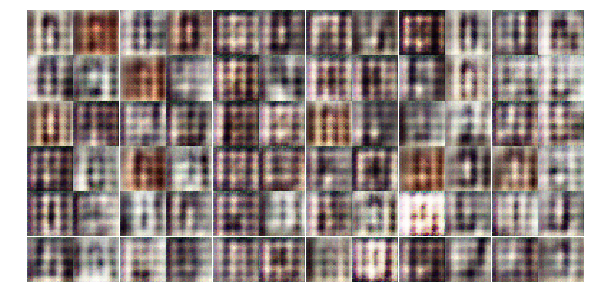

Epoch 1/25... Discriminator Loss: 0.9866... Generator Loss: 1.0016
Epoch 1/25... Discriminator Loss: 0.9359... Generator Loss: 1.0157
Epoch 1/25... Discriminator Loss: 0.8889... Generator Loss: 2.1780
Epoch 1/25... Discriminator Loss: 1.5324... Generator Loss: 0.4394
Epoch 1/25... Discriminator Loss: 0.4321... Generator Loss: 2.1189
Epoch 1/25... Discriminator Loss: 0.8306... Generator Loss: 0.9094
Epoch 1/25... Discriminator Loss: 0.5507... Generator Loss: 1.6274
Epoch 1/25... Discriminator Loss: 1.0110... Generator Loss: 2.0280
Epoch 1/25... Discriminator Loss: 1.0896... Generator Loss: 0.7047
Epoch 1/25... Discriminator Loss: 0.9165... Generator Loss: 1.1304


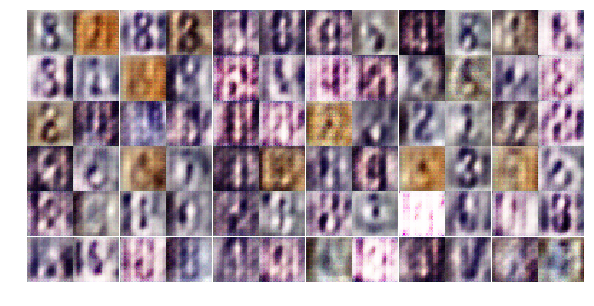

Epoch 1/25... Discriminator Loss: 0.8877... Generator Loss: 1.0235
Epoch 1/25... Discriminator Loss: 0.6702... Generator Loss: 1.4631
Epoch 1/25... Discriminator Loss: 0.6083... Generator Loss: 1.7491
Epoch 1/25... Discriminator Loss: 1.0186... Generator Loss: 0.7418
Epoch 1/25... Discriminator Loss: 0.5893... Generator Loss: 1.9994
Epoch 1/25... Discriminator Loss: 0.6093... Generator Loss: 1.4999
Epoch 1/25... Discriminator Loss: 0.8478... Generator Loss: 1.2408
Epoch 2/25... Discriminator Loss: 0.8075... Generator Loss: 1.4172
Epoch 2/25... Discriminator Loss: 0.5821... Generator Loss: 1.8122
Epoch 2/25... Discriminator Loss: 0.8553... Generator Loss: 1.0666


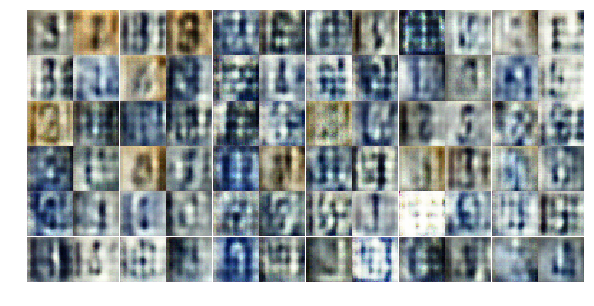

Epoch 2/25... Discriminator Loss: 0.7402... Generator Loss: 1.0689
Epoch 2/25... Discriminator Loss: 1.4087... Generator Loss: 0.6461
Epoch 2/25... Discriminator Loss: 1.4544... Generator Loss: 0.5885
Epoch 2/25... Discriminator Loss: 0.9154... Generator Loss: 1.2419
Epoch 2/25... Discriminator Loss: 0.7852... Generator Loss: 1.1149
Epoch 2/25... Discriminator Loss: 1.1921... Generator Loss: 0.9040
Epoch 2/25... Discriminator Loss: 0.9385... Generator Loss: 1.3015
Epoch 2/25... Discriminator Loss: 0.6807... Generator Loss: 1.2288
Epoch 2/25... Discriminator Loss: 2.0385... Generator Loss: 2.2839
Epoch 2/25... Discriminator Loss: 1.2124... Generator Loss: 0.7148


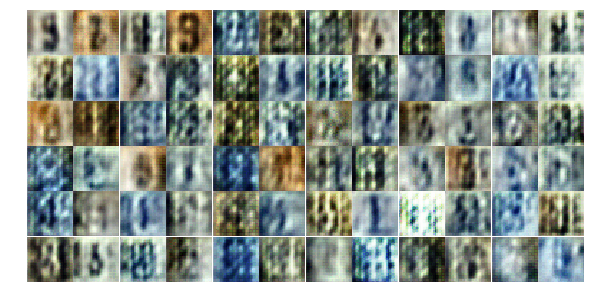

Epoch 2/25... Discriminator Loss: 1.0199... Generator Loss: 0.9664
Epoch 2/25... Discriminator Loss: 1.4070... Generator Loss: 1.2553
Epoch 2/25... Discriminator Loss: 0.9446... Generator Loss: 1.2041
Epoch 2/25... Discriminator Loss: 1.0636... Generator Loss: 0.8865
Epoch 2/25... Discriminator Loss: 0.9841... Generator Loss: 1.1969
Epoch 2/25... Discriminator Loss: 1.0347... Generator Loss: 0.8507
Epoch 2/25... Discriminator Loss: 1.4372... Generator Loss: 0.4493
Epoch 2/25... Discriminator Loss: 1.2993... Generator Loss: 0.5936
Epoch 2/25... Discriminator Loss: 0.9441... Generator Loss: 0.8311
Epoch 2/25... Discriminator Loss: 0.9825... Generator Loss: 1.0482


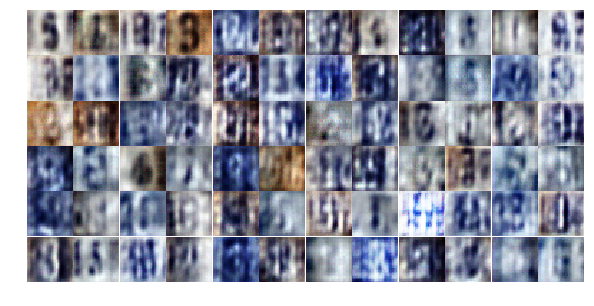

Epoch 2/25... Discriminator Loss: 1.0394... Generator Loss: 0.6429
Epoch 2/25... Discriminator Loss: 0.7590... Generator Loss: 1.3198
Epoch 2/25... Discriminator Loss: 0.8035... Generator Loss: 1.2443
Epoch 2/25... Discriminator Loss: 1.4680... Generator Loss: 2.0295
Epoch 2/25... Discriminator Loss: 1.1128... Generator Loss: 1.4283
Epoch 2/25... Discriminator Loss: 1.1265... Generator Loss: 1.5015
Epoch 2/25... Discriminator Loss: 1.2930... Generator Loss: 0.4779
Epoch 2/25... Discriminator Loss: 1.2162... Generator Loss: 0.6580
Epoch 2/25... Discriminator Loss: 0.9818... Generator Loss: 0.9117
Epoch 2/25... Discriminator Loss: 0.6424... Generator Loss: 1.4904


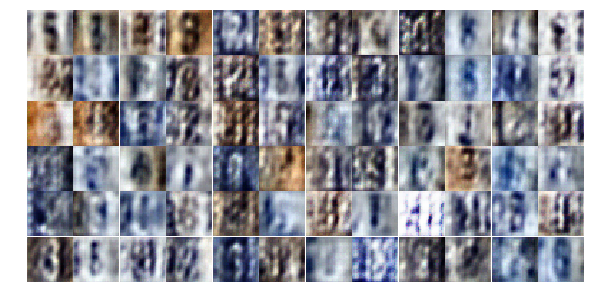

Epoch 2/25... Discriminator Loss: 0.7466... Generator Loss: 1.3583
Epoch 2/25... Discriminator Loss: 1.7075... Generator Loss: 0.2580
Epoch 2/25... Discriminator Loss: 0.6707... Generator Loss: 1.0537
Epoch 2/25... Discriminator Loss: 0.9771... Generator Loss: 2.5920
Epoch 2/25... Discriminator Loss: 0.4732... Generator Loss: 2.3074
Epoch 2/25... Discriminator Loss: 0.9247... Generator Loss: 1.0906
Epoch 2/25... Discriminator Loss: 1.1520... Generator Loss: 1.1275
Epoch 2/25... Discriminator Loss: 0.7626... Generator Loss: 1.8822
Epoch 2/25... Discriminator Loss: 1.7372... Generator Loss: 0.3267
Epoch 2/25... Discriminator Loss: 1.2257... Generator Loss: 0.8122


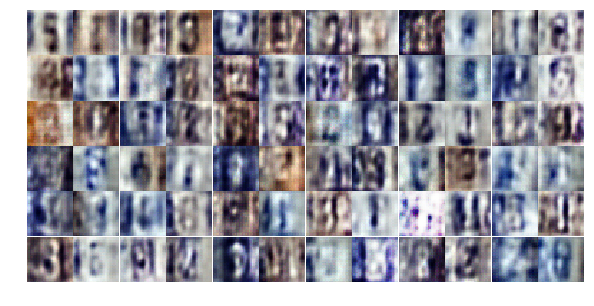

Epoch 2/25... Discriminator Loss: 0.7245... Generator Loss: 1.2517
Epoch 2/25... Discriminator Loss: 0.9591... Generator Loss: 0.9526
Epoch 2/25... Discriminator Loss: 0.7624... Generator Loss: 1.0549
Epoch 2/25... Discriminator Loss: 1.1419... Generator Loss: 0.5627
Epoch 2/25... Discriminator Loss: 1.1976... Generator Loss: 0.5849
Epoch 2/25... Discriminator Loss: 0.6953... Generator Loss: 1.8408
Epoch 2/25... Discriminator Loss: 1.0437... Generator Loss: 3.6808
Epoch 2/25... Discriminator Loss: 0.8709... Generator Loss: 1.1971
Epoch 2/25... Discriminator Loss: 0.5330... Generator Loss: 1.5473
Epoch 2/25... Discriminator Loss: 0.6309... Generator Loss: 1.5719


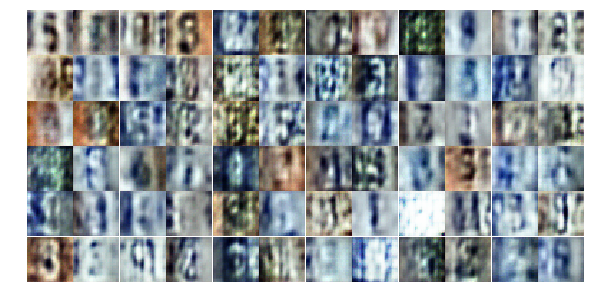

Epoch 2/25... Discriminator Loss: 0.8001... Generator Loss: 1.1073
Epoch 2/25... Discriminator Loss: 0.9385... Generator Loss: 1.0062
Epoch 2/25... Discriminator Loss: 1.1995... Generator Loss: 0.5781
Epoch 2/25... Discriminator Loss: 1.1644... Generator Loss: 0.5121
Epoch 3/25... Discriminator Loss: 0.5801... Generator Loss: 1.8952
Epoch 3/25... Discriminator Loss: 0.7790... Generator Loss: 1.8955
Epoch 3/25... Discriminator Loss: 1.2879... Generator Loss: 3.2783
Epoch 3/25... Discriminator Loss: 0.4934... Generator Loss: 1.5497
Epoch 3/25... Discriminator Loss: 1.1859... Generator Loss: 2.3144
Epoch 3/25... Discriminator Loss: 0.5155... Generator Loss: 1.7427


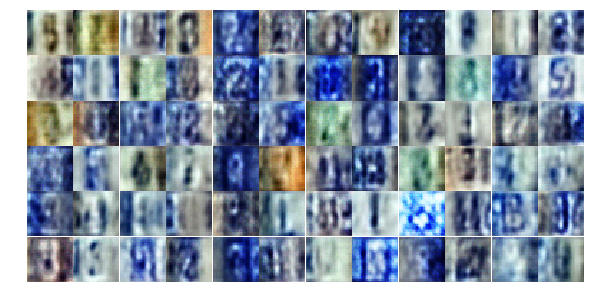

Epoch 3/25... Discriminator Loss: 0.7756... Generator Loss: 0.9620
Epoch 3/25... Discriminator Loss: 0.6459... Generator Loss: 1.2948
Epoch 3/25... Discriminator Loss: 0.6933... Generator Loss: 1.1590
Epoch 3/25... Discriminator Loss: 0.6398... Generator Loss: 1.1905
Epoch 3/25... Discriminator Loss: 1.4898... Generator Loss: 2.3814
Epoch 3/25... Discriminator Loss: 0.6199... Generator Loss: 1.5706
Epoch 3/25... Discriminator Loss: 0.8734... Generator Loss: 1.2648
Epoch 3/25... Discriminator Loss: 0.9465... Generator Loss: 0.7536
Epoch 3/25... Discriminator Loss: 0.5270... Generator Loss: 1.4690
Epoch 3/25... Discriminator Loss: 0.5075... Generator Loss: 1.6696


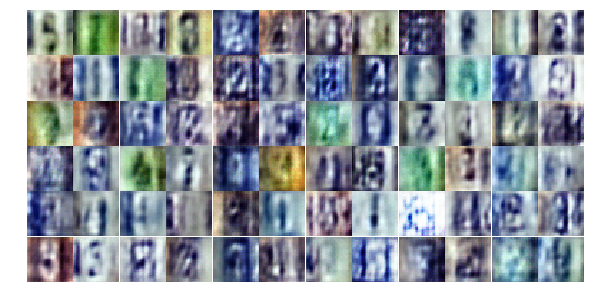

Epoch 3/25... Discriminator Loss: 0.9126... Generator Loss: 0.9944
Epoch 3/25... Discriminator Loss: 0.4539... Generator Loss: 1.9519
Epoch 3/25... Discriminator Loss: 0.3931... Generator Loss: 1.8326
Epoch 3/25... Discriminator Loss: 0.7850... Generator Loss: 3.1108
Epoch 3/25... Discriminator Loss: 0.5144... Generator Loss: 1.4341
Epoch 3/25... Discriminator Loss: 0.6406... Generator Loss: 1.1677
Epoch 3/25... Discriminator Loss: 1.2510... Generator Loss: 0.5419
Epoch 3/25... Discriminator Loss: 1.0947... Generator Loss: 1.4144
Epoch 3/25... Discriminator Loss: 0.6319... Generator Loss: 3.5568
Epoch 3/25... Discriminator Loss: 0.8888... Generator Loss: 0.8411


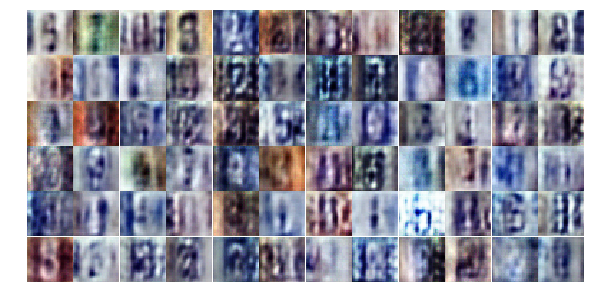

Epoch 3/25... Discriminator Loss: 0.5804... Generator Loss: 1.4360
Epoch 3/25... Discriminator Loss: 0.5602... Generator Loss: 2.1516
Epoch 3/25... Discriminator Loss: 0.8399... Generator Loss: 0.7721
Epoch 3/25... Discriminator Loss: 0.7339... Generator Loss: 1.2851
Epoch 3/25... Discriminator Loss: 0.7539... Generator Loss: 0.9486
Epoch 3/25... Discriminator Loss: 0.5835... Generator Loss: 1.4404
Epoch 3/25... Discriminator Loss: 1.4060... Generator Loss: 2.1175
Epoch 3/25... Discriminator Loss: 0.5018... Generator Loss: 2.7489
Epoch 3/25... Discriminator Loss: 0.6988... Generator Loss: 1.7780
Epoch 3/25... Discriminator Loss: 1.0116... Generator Loss: 3.3870


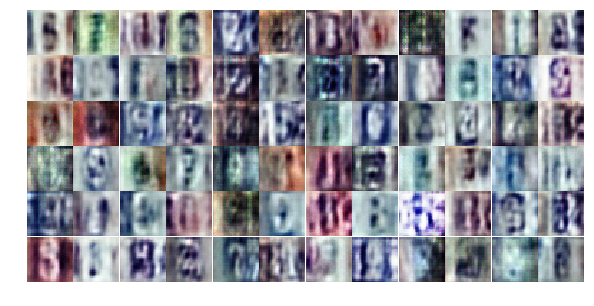

Epoch 3/25... Discriminator Loss: 1.0379... Generator Loss: 2.7038
Epoch 3/25... Discriminator Loss: 0.4514... Generator Loss: 2.7211
Epoch 3/25... Discriminator Loss: 0.8538... Generator Loss: 0.7784
Epoch 3/25... Discriminator Loss: 0.5876... Generator Loss: 1.1605
Epoch 3/25... Discriminator Loss: 0.6829... Generator Loss: 2.1243
Epoch 3/25... Discriminator Loss: 1.0729... Generator Loss: 1.6982
Epoch 3/25... Discriminator Loss: 0.5262... Generator Loss: 2.3747
Epoch 3/25... Discriminator Loss: 0.2719... Generator Loss: 2.2212
Epoch 3/25... Discriminator Loss: 0.7917... Generator Loss: 0.8251
Epoch 3/25... Discriminator Loss: 1.0513... Generator Loss: 2.7617


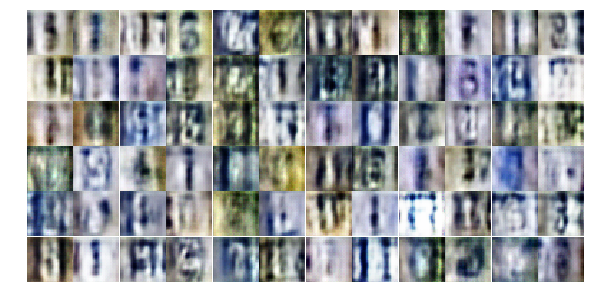

Epoch 3/25... Discriminator Loss: 1.4448... Generator Loss: 0.3928
Epoch 3/25... Discriminator Loss: 0.7845... Generator Loss: 1.3260
Epoch 3/25... Discriminator Loss: 0.9330... Generator Loss: 0.7332
Epoch 3/25... Discriminator Loss: 1.3458... Generator Loss: 0.4577
Epoch 3/25... Discriminator Loss: 1.2817... Generator Loss: 2.9493
Epoch 3/25... Discriminator Loss: 0.4967... Generator Loss: 1.7905
Epoch 3/25... Discriminator Loss: 0.6295... Generator Loss: 1.9211
Epoch 3/25... Discriminator Loss: 0.5248... Generator Loss: 1.7000
Epoch 3/25... Discriminator Loss: 0.7538... Generator Loss: 1.0822
Epoch 3/25... Discriminator Loss: 0.6933... Generator Loss: 1.0753


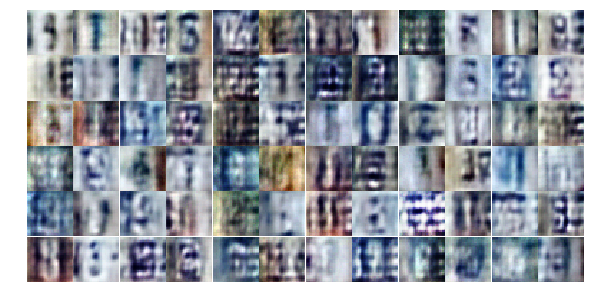

Epoch 3/25... Discriminator Loss: 1.0229... Generator Loss: 0.7836
Epoch 4/25... Discriminator Loss: 0.9702... Generator Loss: 0.6930
Epoch 4/25... Discriminator Loss: 0.7052... Generator Loss: 2.1185
Epoch 4/25... Discriminator Loss: 0.9574... Generator Loss: 0.7206
Epoch 4/25... Discriminator Loss: 0.6938... Generator Loss: 1.3244
Epoch 4/25... Discriminator Loss: 0.7128... Generator Loss: 1.0758
Epoch 4/25... Discriminator Loss: 1.5671... Generator Loss: 0.3188
Epoch 4/25... Discriminator Loss: 0.6600... Generator Loss: 1.3764
Epoch 4/25... Discriminator Loss: 0.4866... Generator Loss: 1.5967
Epoch 4/25... Discriminator Loss: 0.5239... Generator Loss: 1.2973


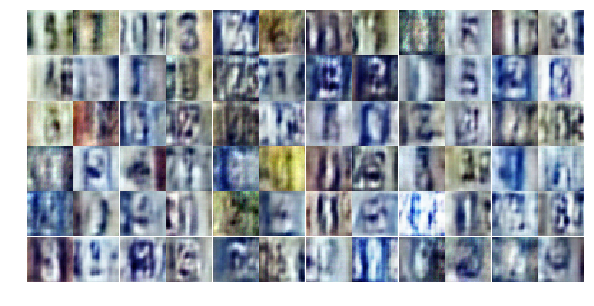

Epoch 4/25... Discriminator Loss: 0.3847... Generator Loss: 2.4427
Epoch 4/25... Discriminator Loss: 0.8569... Generator Loss: 0.7542
Epoch 4/25... Discriminator Loss: 1.0080... Generator Loss: 1.0458
Epoch 4/25... Discriminator Loss: 0.5974... Generator Loss: 1.2734
Epoch 4/25... Discriminator Loss: 0.5669... Generator Loss: 1.2251
Epoch 4/25... Discriminator Loss: 0.5090... Generator Loss: 1.7175
Epoch 4/25... Discriminator Loss: 1.6026... Generator Loss: 0.3621
Epoch 4/25... Discriminator Loss: 1.1511... Generator Loss: 0.5829
Epoch 4/25... Discriminator Loss: 0.7705... Generator Loss: 1.3561
Epoch 4/25... Discriminator Loss: 0.8973... Generator Loss: 2.6791


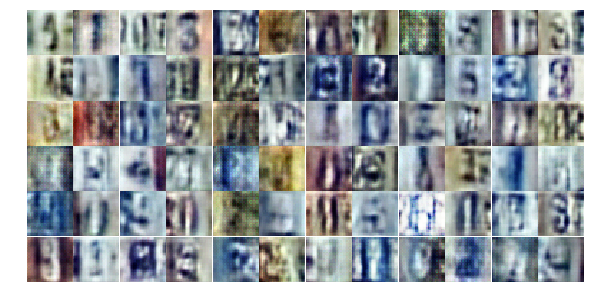

Epoch 4/25... Discriminator Loss: 0.6290... Generator Loss: 1.2449
Epoch 4/25... Discriminator Loss: 0.5051... Generator Loss: 2.1110
Epoch 4/25... Discriminator Loss: 0.6997... Generator Loss: 0.9191
Epoch 4/25... Discriminator Loss: 0.6044... Generator Loss: 1.2601
Epoch 4/25... Discriminator Loss: 0.4601... Generator Loss: 1.6746
Epoch 4/25... Discriminator Loss: 0.4097... Generator Loss: 1.7762
Epoch 4/25... Discriminator Loss: 0.7617... Generator Loss: 0.8057
Epoch 4/25... Discriminator Loss: 0.6779... Generator Loss: 1.2936
Epoch 4/25... Discriminator Loss: 0.6635... Generator Loss: 1.1692
Epoch 4/25... Discriminator Loss: 0.5039... Generator Loss: 1.4740


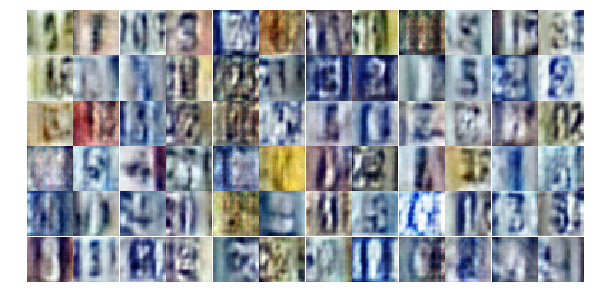

Epoch 4/25... Discriminator Loss: 0.7899... Generator Loss: 0.8636
Epoch 4/25... Discriminator Loss: 0.4721... Generator Loss: 1.6005
Epoch 4/25... Discriminator Loss: 0.4937... Generator Loss: 1.6476
Epoch 4/25... Discriminator Loss: 0.6783... Generator Loss: 0.9733
Epoch 4/25... Discriminator Loss: 0.6114... Generator Loss: 2.5482
Epoch 4/25... Discriminator Loss: 0.4780... Generator Loss: 1.6005
Epoch 4/25... Discriminator Loss: 0.5182... Generator Loss: 1.4434
Epoch 4/25... Discriminator Loss: 0.7740... Generator Loss: 2.9418
Epoch 4/25... Discriminator Loss: 0.5124... Generator Loss: 1.4376
Epoch 4/25... Discriminator Loss: 0.9319... Generator Loss: 0.7144


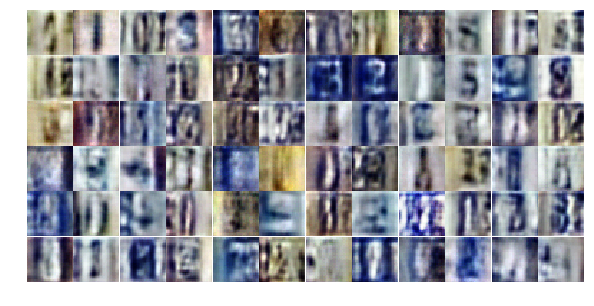

Epoch 4/25... Discriminator Loss: 0.5126... Generator Loss: 1.2741
Epoch 4/25... Discriminator Loss: 0.3018... Generator Loss: 2.1997
Epoch 4/25... Discriminator Loss: 0.5471... Generator Loss: 2.8227
Epoch 4/25... Discriminator Loss: 0.5254... Generator Loss: 1.2581
Epoch 4/25... Discriminator Loss: 0.2499... Generator Loss: 3.3075
Epoch 4/25... Discriminator Loss: 1.0772... Generator Loss: 1.1592
Epoch 4/25... Discriminator Loss: 1.0113... Generator Loss: 0.6540
Epoch 4/25... Discriminator Loss: 0.8254... Generator Loss: 1.6296
Epoch 4/25... Discriminator Loss: 0.5403... Generator Loss: 1.4267
Epoch 4/25... Discriminator Loss: 0.5581... Generator Loss: 1.5547


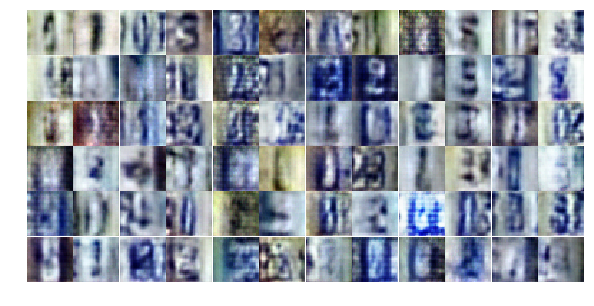

Epoch 4/25... Discriminator Loss: 0.5489... Generator Loss: 1.6390
Epoch 4/25... Discriminator Loss: 0.3852... Generator Loss: 1.7732
Epoch 4/25... Discriminator Loss: 0.3059... Generator Loss: 1.9875
Epoch 4/25... Discriminator Loss: 0.5736... Generator Loss: 2.5846
Epoch 4/25... Discriminator Loss: 0.5572... Generator Loss: 1.5086
Epoch 4/25... Discriminator Loss: 0.4272... Generator Loss: 1.6327
Epoch 4/25... Discriminator Loss: 0.4965... Generator Loss: 1.3448
Epoch 4/25... Discriminator Loss: 0.6173... Generator Loss: 1.0640
Epoch 4/25... Discriminator Loss: 0.3890... Generator Loss: 1.6499
Epoch 5/25... Discriminator Loss: 0.4494... Generator Loss: 1.3497


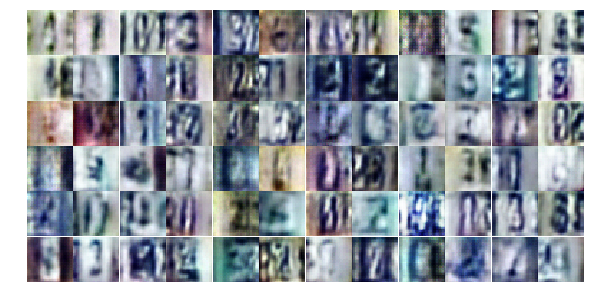

Epoch 5/25... Discriminator Loss: 1.0719... Generator Loss: 0.6241
Epoch 5/25... Discriminator Loss: 0.4745... Generator Loss: 2.2953
Epoch 5/25... Discriminator Loss: 0.3240... Generator Loss: 1.7682
Epoch 5/25... Discriminator Loss: 0.4236... Generator Loss: 3.1806
Epoch 5/25... Discriminator Loss: 0.8941... Generator Loss: 2.0613
Epoch 5/25... Discriminator Loss: 0.7991... Generator Loss: 0.9000
Epoch 5/25... Discriminator Loss: 0.6421... Generator Loss: 1.0522
Epoch 5/25... Discriminator Loss: 0.4679... Generator Loss: 1.3462
Epoch 5/25... Discriminator Loss: 0.5441... Generator Loss: 1.1835
Epoch 5/25... Discriminator Loss: 1.3010... Generator Loss: 0.4448


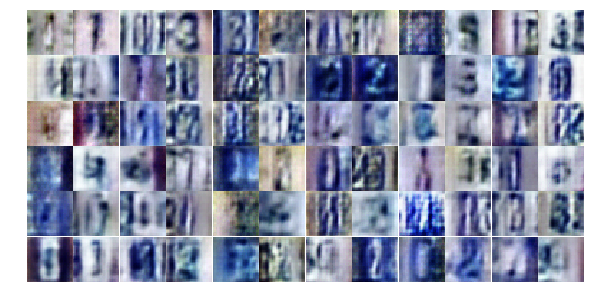

Epoch 5/25... Discriminator Loss: 0.4655... Generator Loss: 2.0811
Epoch 5/25... Discriminator Loss: 0.4974... Generator Loss: 2.1068
Epoch 5/25... Discriminator Loss: 0.3799... Generator Loss: 2.2520
Epoch 5/25... Discriminator Loss: 1.1924... Generator Loss: 0.5319
Epoch 5/25... Discriminator Loss: 0.9343... Generator Loss: 2.0159
Epoch 5/25... Discriminator Loss: 0.8383... Generator Loss: 0.9597
Epoch 5/25... Discriminator Loss: 0.4901... Generator Loss: 1.4887
Epoch 5/25... Discriminator Loss: 0.4605... Generator Loss: 1.8058
Epoch 5/25... Discriminator Loss: 0.3998... Generator Loss: 1.6964
Epoch 5/25... Discriminator Loss: 0.3855... Generator Loss: 2.0354


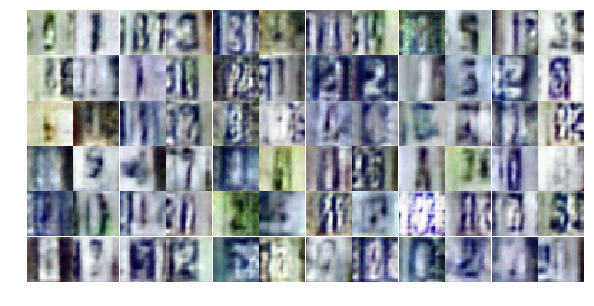

Epoch 5/25... Discriminator Loss: 0.2830... Generator Loss: 2.0353
Epoch 5/25... Discriminator Loss: 0.8433... Generator Loss: 0.7238
Epoch 5/25... Discriminator Loss: 0.7216... Generator Loss: 1.0057
Epoch 5/25... Discriminator Loss: 0.3416... Generator Loss: 1.7313
Epoch 5/25... Discriminator Loss: 0.9709... Generator Loss: 0.6149
Epoch 5/25... Discriminator Loss: 0.4526... Generator Loss: 1.4509
Epoch 5/25... Discriminator Loss: 0.7659... Generator Loss: 0.8396
Epoch 5/25... Discriminator Loss: 0.8297... Generator Loss: 1.1225
Epoch 5/25... Discriminator Loss: 0.5551... Generator Loss: 2.2073
Epoch 5/25... Discriminator Loss: 0.4894... Generator Loss: 1.4413


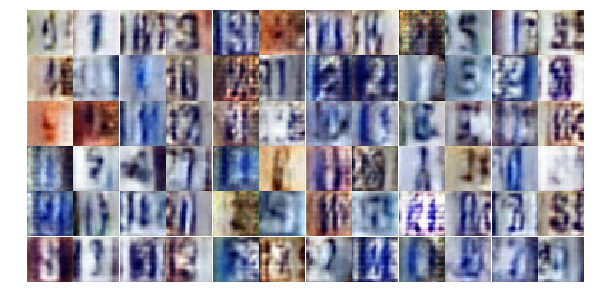

Epoch 5/25... Discriminator Loss: 0.5719... Generator Loss: 1.7572
Epoch 5/25... Discriminator Loss: 0.5213... Generator Loss: 1.3315
Epoch 5/25... Discriminator Loss: 0.4150... Generator Loss: 1.6452
Epoch 5/25... Discriminator Loss: 0.6488... Generator Loss: 1.0405
Epoch 5/25... Discriminator Loss: 1.5335... Generator Loss: 3.9337
Epoch 5/25... Discriminator Loss: 0.3964... Generator Loss: 1.8631
Epoch 5/25... Discriminator Loss: 0.6702... Generator Loss: 1.0300
Epoch 5/25... Discriminator Loss: 0.4765... Generator Loss: 1.3567
Epoch 5/25... Discriminator Loss: 0.5506... Generator Loss: 1.1947
Epoch 5/25... Discriminator Loss: 0.4567... Generator Loss: 1.5909


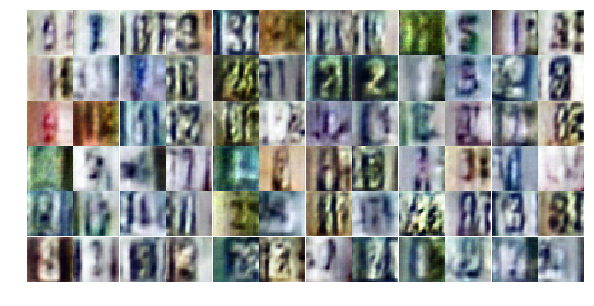

Epoch 5/25... Discriminator Loss: 0.3014... Generator Loss: 2.2252
Epoch 5/25... Discriminator Loss: 0.5035... Generator Loss: 1.1124
Epoch 5/25... Discriminator Loss: 1.0270... Generator Loss: 0.6378
Epoch 5/25... Discriminator Loss: 0.8136... Generator Loss: 1.2089
Epoch 5/25... Discriminator Loss: 0.9348... Generator Loss: 0.8889
Epoch 5/25... Discriminator Loss: 0.9278... Generator Loss: 0.6822
Epoch 5/25... Discriminator Loss: 0.6105... Generator Loss: 1.3319
Epoch 5/25... Discriminator Loss: 0.7088... Generator Loss: 1.0817
Epoch 5/25... Discriminator Loss: 0.5805... Generator Loss: 1.2136
Epoch 5/25... Discriminator Loss: 0.5220... Generator Loss: 1.2865


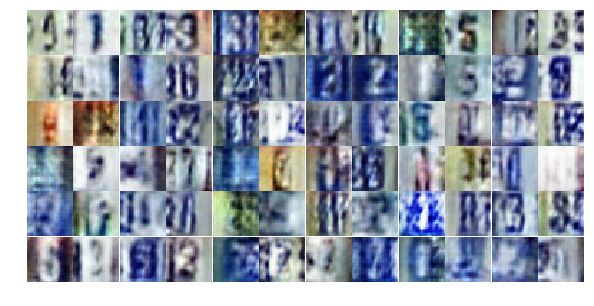

Epoch 5/25... Discriminator Loss: 0.4694... Generator Loss: 1.4356
Epoch 5/25... Discriminator Loss: 0.5842... Generator Loss: 1.1573
Epoch 5/25... Discriminator Loss: 0.4413... Generator Loss: 2.3631
Epoch 5/25... Discriminator Loss: 0.4525... Generator Loss: 1.4288
Epoch 5/25... Discriminator Loss: 0.5273... Generator Loss: 1.3337
Epoch 5/25... Discriminator Loss: 0.7101... Generator Loss: 0.9196
Epoch 6/25... Discriminator Loss: 0.4222... Generator Loss: 1.4483
Epoch 6/25... Discriminator Loss: 0.3676... Generator Loss: 1.6256
Epoch 6/25... Discriminator Loss: 0.4349... Generator Loss: 2.0461
Epoch 6/25... Discriminator Loss: 0.7518... Generator Loss: 1.8573


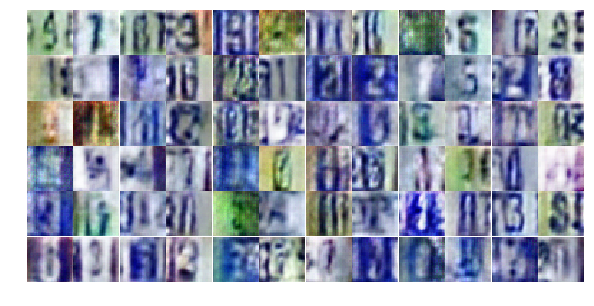

Epoch 6/25... Discriminator Loss: 0.6405... Generator Loss: 1.1768
Epoch 6/25... Discriminator Loss: 0.5392... Generator Loss: 1.5758
Epoch 6/25... Discriminator Loss: 0.5551... Generator Loss: 1.2650
Epoch 6/25... Discriminator Loss: 0.7748... Generator Loss: 0.8759
Epoch 6/25... Discriminator Loss: 0.8445... Generator Loss: 0.7422
Epoch 6/25... Discriminator Loss: 0.3182... Generator Loss: 1.7941
Epoch 6/25... Discriminator Loss: 0.4104... Generator Loss: 1.5700
Epoch 6/25... Discriminator Loss: 0.7591... Generator Loss: 1.8377
Epoch 6/25... Discriminator Loss: 0.9161... Generator Loss: 0.6702
Epoch 6/25... Discriminator Loss: 0.3757... Generator Loss: 1.9603


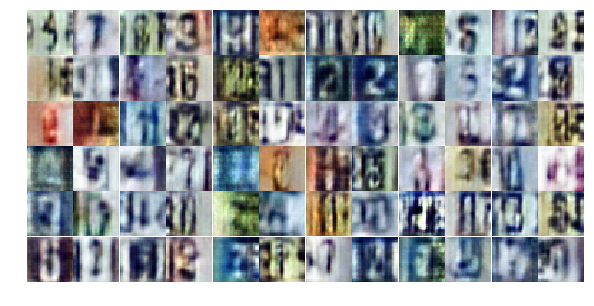

Epoch 6/25... Discriminator Loss: 0.7680... Generator Loss: 0.8875
Epoch 6/25... Discriminator Loss: 0.5265... Generator Loss: 1.9555
Epoch 6/25... Discriminator Loss: 1.2130... Generator Loss: 0.4305
Epoch 6/25... Discriminator Loss: 0.5417... Generator Loss: 1.9487
Epoch 6/25... Discriminator Loss: 0.7747... Generator Loss: 2.4921
Epoch 6/25... Discriminator Loss: 0.4041... Generator Loss: 1.8613
Epoch 6/25... Discriminator Loss: 0.5454... Generator Loss: 1.2650
Epoch 6/25... Discriminator Loss: 0.5727... Generator Loss: 1.1438
Epoch 6/25... Discriminator Loss: 0.5187... Generator Loss: 2.3251
Epoch 6/25... Discriminator Loss: 0.6146... Generator Loss: 1.1107


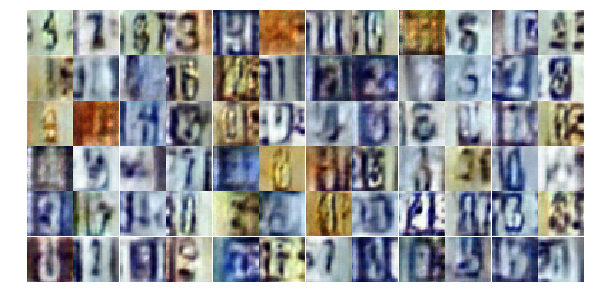

Epoch 6/25... Discriminator Loss: 0.9373... Generator Loss: 0.6533
Epoch 6/25... Discriminator Loss: 0.6765... Generator Loss: 2.7094
Epoch 6/25... Discriminator Loss: 1.6924... Generator Loss: 0.8937
Epoch 6/25... Discriminator Loss: 1.3939... Generator Loss: 0.3462
Epoch 6/25... Discriminator Loss: 0.5375... Generator Loss: 1.5288
Epoch 6/25... Discriminator Loss: 1.1965... Generator Loss: 0.5667
Epoch 6/25... Discriminator Loss: 0.6557... Generator Loss: 1.5061
Epoch 6/25... Discriminator Loss: 0.3740... Generator Loss: 1.5939
Epoch 6/25... Discriminator Loss: 0.3671... Generator Loss: 1.8274
Epoch 6/25... Discriminator Loss: 0.4704... Generator Loss: 1.5636


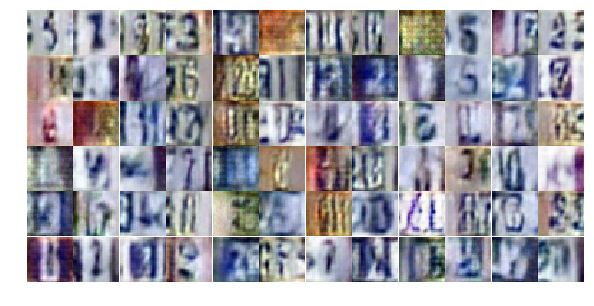

Epoch 6/25... Discriminator Loss: 0.8972... Generator Loss: 0.6852
Epoch 6/25... Discriminator Loss: 2.0000... Generator Loss: 4.2568
Epoch 6/25... Discriminator Loss: 0.7894... Generator Loss: 0.8942
Epoch 6/25... Discriminator Loss: 0.5434... Generator Loss: 1.2369
Epoch 6/25... Discriminator Loss: 0.8416... Generator Loss: 0.9384
Epoch 6/25... Discriminator Loss: 0.9288... Generator Loss: 0.7114
Epoch 6/25... Discriminator Loss: 0.4323... Generator Loss: 1.8049
Epoch 6/25... Discriminator Loss: 0.4612... Generator Loss: 1.7706
Epoch 6/25... Discriminator Loss: 0.6365... Generator Loss: 1.2048
Epoch 6/25... Discriminator Loss: 0.3976... Generator Loss: 1.4784


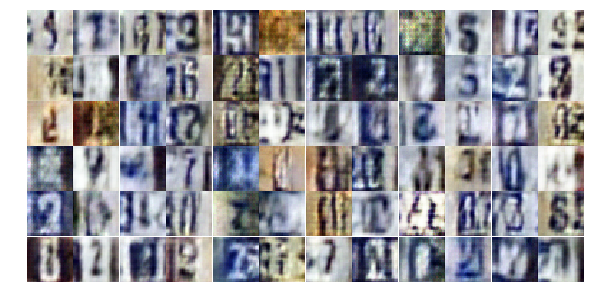

Epoch 6/25... Discriminator Loss: 1.0712... Generator Loss: 0.6728
Epoch 6/25... Discriminator Loss: 0.4769... Generator Loss: 1.7781
Epoch 6/25... Discriminator Loss: 0.6801... Generator Loss: 1.0574
Epoch 6/25... Discriminator Loss: 0.3918... Generator Loss: 2.3209
Epoch 6/25... Discriminator Loss: 0.3853... Generator Loss: 1.6151
Epoch 6/25... Discriminator Loss: 0.4961... Generator Loss: 1.3917
Epoch 6/25... Discriminator Loss: 0.5672... Generator Loss: 1.1352
Epoch 6/25... Discriminator Loss: 0.9920... Generator Loss: 0.6559
Epoch 6/25... Discriminator Loss: 1.7741... Generator Loss: 1.1308
Epoch 6/25... Discriminator Loss: 1.8080... Generator Loss: 0.2884


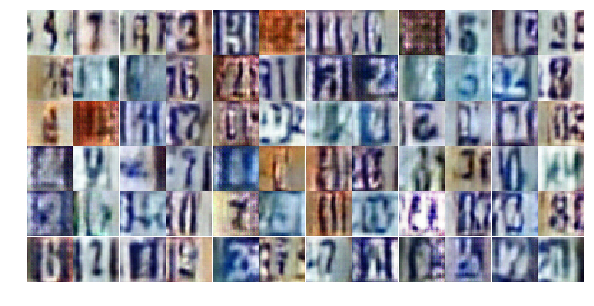

Epoch 6/25... Discriminator Loss: 0.7208... Generator Loss: 1.0124
Epoch 6/25... Discriminator Loss: 0.8570... Generator Loss: 0.7677
Epoch 6/25... Discriminator Loss: 0.5680... Generator Loss: 1.5224
Epoch 7/25... Discriminator Loss: 0.5206... Generator Loss: 1.5973
Epoch 7/25... Discriminator Loss: 0.4256... Generator Loss: 1.5197
Epoch 7/25... Discriminator Loss: 0.6748... Generator Loss: 1.0650
Epoch 7/25... Discriminator Loss: 0.6042... Generator Loss: 1.1545
Epoch 7/25... Discriminator Loss: 0.3814... Generator Loss: 1.6883
Epoch 7/25... Discriminator Loss: 0.3166... Generator Loss: 2.4766
Epoch 7/25... Discriminator Loss: 0.5237... Generator Loss: 1.2202


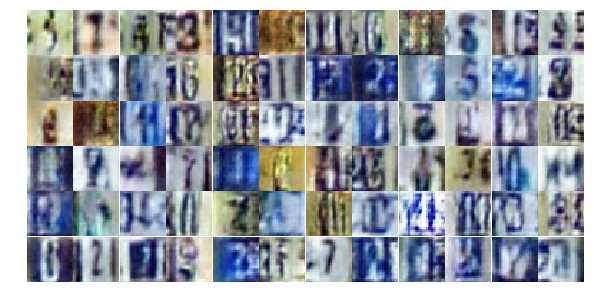

Epoch 7/25... Discriminator Loss: 1.1885... Generator Loss: 0.4741
Epoch 7/25... Discriminator Loss: 0.5371... Generator Loss: 1.2142
Epoch 7/25... Discriminator Loss: 0.4633... Generator Loss: 1.7611
Epoch 7/25... Discriminator Loss: 0.4750... Generator Loss: 1.3375
Epoch 7/25... Discriminator Loss: 0.4371... Generator Loss: 1.3563
Epoch 7/25... Discriminator Loss: 0.5754... Generator Loss: 1.1195
Epoch 7/25... Discriminator Loss: 0.8932... Generator Loss: 0.8245
Epoch 7/25... Discriminator Loss: 0.8703... Generator Loss: 2.4176
Epoch 7/25... Discriminator Loss: 0.5152... Generator Loss: 2.5047
Epoch 7/25... Discriminator Loss: 1.5287... Generator Loss: 0.4115


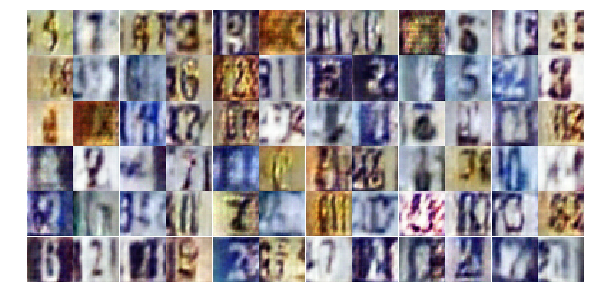

Epoch 7/25... Discriminator Loss: 0.9522... Generator Loss: 0.8146
Epoch 7/25... Discriminator Loss: 0.4207... Generator Loss: 1.7385
Epoch 7/25... Discriminator Loss: 0.7758... Generator Loss: 0.8148
Epoch 7/25... Discriminator Loss: 0.6406... Generator Loss: 1.2580
Epoch 7/25... Discriminator Loss: 0.4327... Generator Loss: 1.4522
Epoch 7/25... Discriminator Loss: 0.4079... Generator Loss: 1.9935
Epoch 7/25... Discriminator Loss: 0.4467... Generator Loss: 1.3800
Epoch 7/25... Discriminator Loss: 1.2687... Generator Loss: 0.4311
Epoch 7/25... Discriminator Loss: 0.2580... Generator Loss: 2.0611
Epoch 7/25... Discriminator Loss: 0.2881... Generator Loss: 2.7934


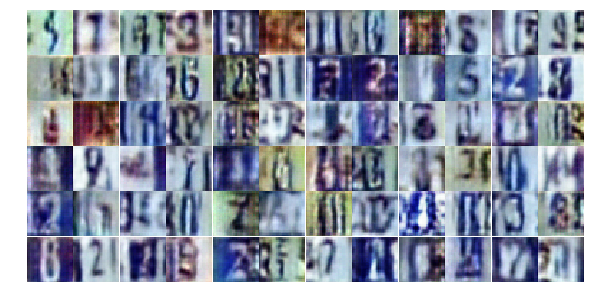

Epoch 7/25... Discriminator Loss: 1.2856... Generator Loss: 0.4255
Epoch 7/25... Discriminator Loss: 1.3722... Generator Loss: 0.4144
Epoch 7/25... Discriminator Loss: 0.6629... Generator Loss: 1.8433
Epoch 7/25... Discriminator Loss: 0.9035... Generator Loss: 0.6903
Epoch 7/25... Discriminator Loss: 0.9052... Generator Loss: 0.7153
Epoch 7/25... Discriminator Loss: 1.0049... Generator Loss: 0.6542
Epoch 7/25... Discriminator Loss: 0.9548... Generator Loss: 0.6599
Epoch 7/25... Discriminator Loss: 0.5429... Generator Loss: 1.4561
Epoch 7/25... Discriminator Loss: 0.9422... Generator Loss: 0.6777
Epoch 7/25... Discriminator Loss: 0.4972... Generator Loss: 1.8734


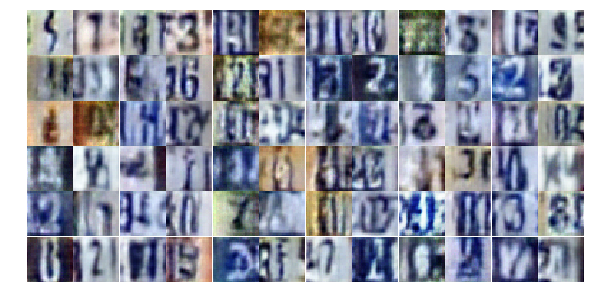

Epoch 7/25... Discriminator Loss: 1.1178... Generator Loss: 2.6465
Epoch 7/25... Discriminator Loss: 0.4117... Generator Loss: 1.5300
Epoch 7/25... Discriminator Loss: 0.4087... Generator Loss: 1.4571
Epoch 7/25... Discriminator Loss: 0.7299... Generator Loss: 0.8669
Epoch 7/25... Discriminator Loss: 0.3143... Generator Loss: 1.9843
Epoch 7/25... Discriminator Loss: 0.2029... Generator Loss: 2.6206
Epoch 7/25... Discriminator Loss: 0.3453... Generator Loss: 1.6258
Epoch 7/25... Discriminator Loss: 0.9143... Generator Loss: 0.7065
Epoch 7/25... Discriminator Loss: 0.3454... Generator Loss: 3.5645
Epoch 7/25... Discriminator Loss: 0.6813... Generator Loss: 1.0492


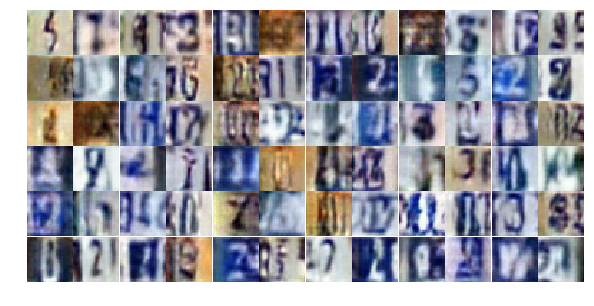

Epoch 7/25... Discriminator Loss: 0.3243... Generator Loss: 2.9118
Epoch 7/25... Discriminator Loss: 0.4057... Generator Loss: 1.5621
Epoch 7/25... Discriminator Loss: 0.8126... Generator Loss: 2.4799
Epoch 7/25... Discriminator Loss: 0.6685... Generator Loss: 0.9306
Epoch 7/25... Discriminator Loss: 0.9790... Generator Loss: 0.5991
Epoch 7/25... Discriminator Loss: 1.3918... Generator Loss: 0.4498
Epoch 7/25... Discriminator Loss: 0.8018... Generator Loss: 1.1334
Epoch 7/25... Discriminator Loss: 0.7042... Generator Loss: 1.3740
Epoch 7/25... Discriminator Loss: 0.6499... Generator Loss: 2.0959
Epoch 7/25... Discriminator Loss: 0.7536... Generator Loss: 0.8705


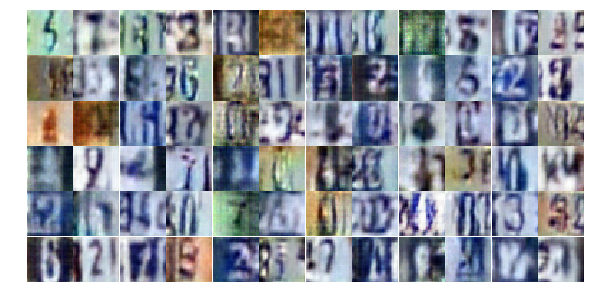

Epoch 7/25... Discriminator Loss: 0.2935... Generator Loss: 2.1842
Epoch 8/25... Discriminator Loss: 0.5035... Generator Loss: 1.3521
Epoch 8/25... Discriminator Loss: 0.8088... Generator Loss: 0.7793
Epoch 8/25... Discriminator Loss: 0.9217... Generator Loss: 0.6723
Epoch 8/25... Discriminator Loss: 0.8400... Generator Loss: 0.7136
Epoch 8/25... Discriminator Loss: 0.6762... Generator Loss: 0.9607
Epoch 8/25... Discriminator Loss: 0.7152... Generator Loss: 1.3165
Epoch 8/25... Discriminator Loss: 0.5005... Generator Loss: 2.6669
Epoch 8/25... Discriminator Loss: 0.7138... Generator Loss: 0.9281
Epoch 8/25... Discriminator Loss: 0.7344... Generator Loss: 0.9632


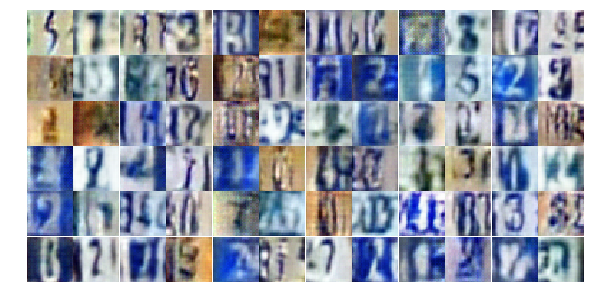

Epoch 8/25... Discriminator Loss: 0.3591... Generator Loss: 1.7984
Epoch 8/25... Discriminator Loss: 0.3354... Generator Loss: 1.7356
Epoch 8/25... Discriminator Loss: 0.4950... Generator Loss: 1.4070
Epoch 8/25... Discriminator Loss: 0.2936... Generator Loss: 1.9990
Epoch 8/25... Discriminator Loss: 0.6759... Generator Loss: 1.4562
Epoch 8/25... Discriminator Loss: 1.2108... Generator Loss: 3.0307
Epoch 8/25... Discriminator Loss: 0.5717... Generator Loss: 1.4590
Epoch 8/25... Discriminator Loss: 0.5488... Generator Loss: 1.3703
Epoch 8/25... Discriminator Loss: 0.6285... Generator Loss: 1.0352
Epoch 8/25... Discriminator Loss: 1.1095... Generator Loss: 0.5346


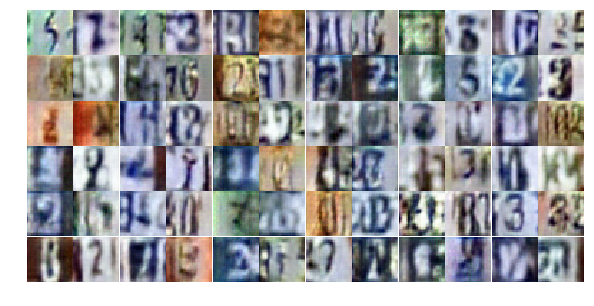

Epoch 8/25... Discriminator Loss: 0.3262... Generator Loss: 2.0819
Epoch 8/25... Discriminator Loss: 0.4321... Generator Loss: 1.5006
Epoch 8/25... Discriminator Loss: 0.7423... Generator Loss: 0.9056
Epoch 8/25... Discriminator Loss: 0.6028... Generator Loss: 1.2086
Epoch 8/25... Discriminator Loss: 0.3290... Generator Loss: 1.8663
Epoch 8/25... Discriminator Loss: 0.5087... Generator Loss: 1.2575
Epoch 8/25... Discriminator Loss: 0.5916... Generator Loss: 1.2282
Epoch 8/25... Discriminator Loss: 0.4700... Generator Loss: 1.4795
Epoch 8/25... Discriminator Loss: 0.5042... Generator Loss: 1.6688
Epoch 8/25... Discriminator Loss: 0.6420... Generator Loss: 1.0405


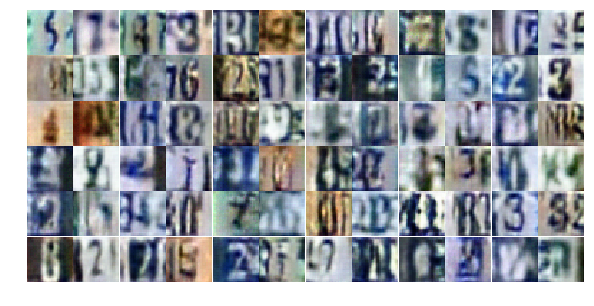

Epoch 8/25... Discriminator Loss: 0.4544... Generator Loss: 1.9575
Epoch 8/25... Discriminator Loss: 0.8796... Generator Loss: 0.6987
Epoch 8/25... Discriminator Loss: 0.4861... Generator Loss: 1.3211
Epoch 8/25... Discriminator Loss: 0.9229... Generator Loss: 0.6334
Epoch 8/25... Discriminator Loss: 0.5099... Generator Loss: 1.1801
Epoch 8/25... Discriminator Loss: 0.5558... Generator Loss: 1.1440
Epoch 8/25... Discriminator Loss: 0.8426... Generator Loss: 0.9195
Epoch 8/25... Discriminator Loss: 0.4637... Generator Loss: 1.6631
Epoch 8/25... Discriminator Loss: 0.5614... Generator Loss: 1.3129
Epoch 8/25... Discriminator Loss: 0.3586... Generator Loss: 2.5992


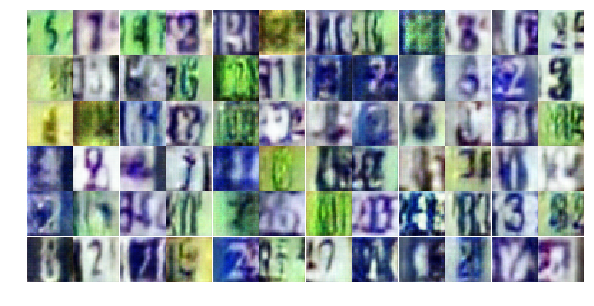

Epoch 8/25... Discriminator Loss: 0.3113... Generator Loss: 1.8499
Epoch 8/25... Discriminator Loss: 1.5121... Generator Loss: 0.3693
Epoch 8/25... Discriminator Loss: 0.7869... Generator Loss: 0.8406
Epoch 8/25... Discriminator Loss: 0.5432... Generator Loss: 1.2316
Epoch 8/25... Discriminator Loss: 2.0939... Generator Loss: 3.0340
Epoch 8/25... Discriminator Loss: 1.4597... Generator Loss: 0.3513
Epoch 8/25... Discriminator Loss: 0.5394... Generator Loss: 1.2056
Epoch 8/25... Discriminator Loss: 0.2995... Generator Loss: 1.8617
Epoch 8/25... Discriminator Loss: 0.4996... Generator Loss: 1.9759
Epoch 8/25... Discriminator Loss: 0.5227... Generator Loss: 1.3756


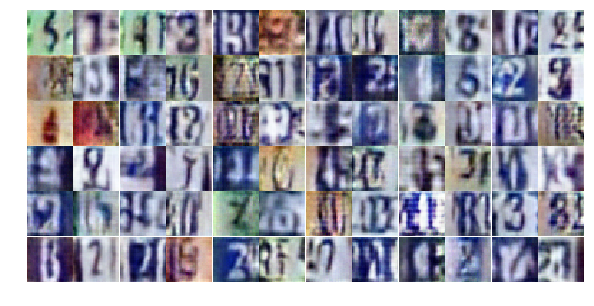

Epoch 8/25... Discriminator Loss: 0.4614... Generator Loss: 1.3363
Epoch 8/25... Discriminator Loss: 0.3584... Generator Loss: 1.6062
Epoch 8/25... Discriminator Loss: 0.4311... Generator Loss: 1.4386
Epoch 8/25... Discriminator Loss: 0.4888... Generator Loss: 1.2720
Epoch 8/25... Discriminator Loss: 0.3502... Generator Loss: 2.2821
Epoch 8/25... Discriminator Loss: 1.3659... Generator Loss: 0.4320
Epoch 8/25... Discriminator Loss: 0.3835... Generator Loss: 2.1874
Epoch 8/25... Discriminator Loss: 0.5456... Generator Loss: 1.8322
Epoch 9/25... Discriminator Loss: 0.6330... Generator Loss: 1.1113
Epoch 9/25... Discriminator Loss: 0.8645... Generator Loss: 0.7165


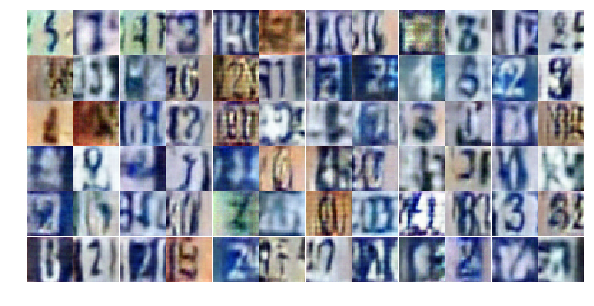

Epoch 9/25... Discriminator Loss: 0.7122... Generator Loss: 0.9046
Epoch 9/25... Discriminator Loss: 0.4228... Generator Loss: 1.7025
Epoch 9/25... Discriminator Loss: 0.9627... Generator Loss: 0.6709
Epoch 9/25... Discriminator Loss: 0.4100... Generator Loss: 1.6323
Epoch 9/25... Discriminator Loss: 1.5258... Generator Loss: 0.3399
Epoch 9/25... Discriminator Loss: 0.5694... Generator Loss: 2.5038
Epoch 9/25... Discriminator Loss: 0.8280... Generator Loss: 0.8181
Epoch 9/25... Discriminator Loss: 0.4530... Generator Loss: 1.4073
Epoch 9/25... Discriminator Loss: 0.7551... Generator Loss: 0.8828
Epoch 9/25... Discriminator Loss: 0.5919... Generator Loss: 1.2372


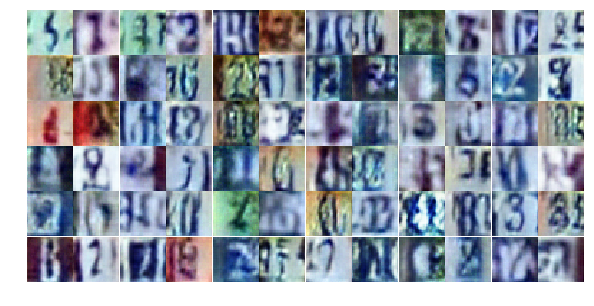

Epoch 9/25... Discriminator Loss: 0.5233... Generator Loss: 1.4995
Epoch 9/25... Discriminator Loss: 1.4507... Generator Loss: 0.3676
Epoch 9/25... Discriminator Loss: 0.8761... Generator Loss: 0.7121
Epoch 9/25... Discriminator Loss: 1.7187... Generator Loss: 0.3923
Epoch 9/25... Discriminator Loss: 0.6717... Generator Loss: 1.8419
Epoch 9/25... Discriminator Loss: 1.2637... Generator Loss: 0.4649
Epoch 9/25... Discriminator Loss: 0.5537... Generator Loss: 1.4230
Epoch 9/25... Discriminator Loss: 0.5349... Generator Loss: 1.2386
Epoch 9/25... Discriminator Loss: 0.7100... Generator Loss: 0.9717
Epoch 9/25... Discriminator Loss: 0.6775... Generator Loss: 0.9560


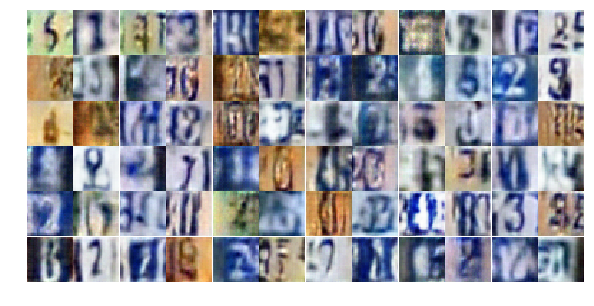

Epoch 9/25... Discriminator Loss: 0.9414... Generator Loss: 0.6947
Epoch 9/25... Discriminator Loss: 0.5858... Generator Loss: 1.1791
Epoch 9/25... Discriminator Loss: 0.3685... Generator Loss: 2.0905
Epoch 9/25... Discriminator Loss: 0.4973... Generator Loss: 1.2579
Epoch 9/25... Discriminator Loss: 0.3678... Generator Loss: 1.6418
Epoch 9/25... Discriminator Loss: 0.4944... Generator Loss: 1.2529
Epoch 9/25... Discriminator Loss: 0.5345... Generator Loss: 1.2998
Epoch 9/25... Discriminator Loss: 0.5662... Generator Loss: 2.9551
Epoch 9/25... Discriminator Loss: 0.4907... Generator Loss: 1.7165
Epoch 9/25... Discriminator Loss: 0.4562... Generator Loss: 1.7655


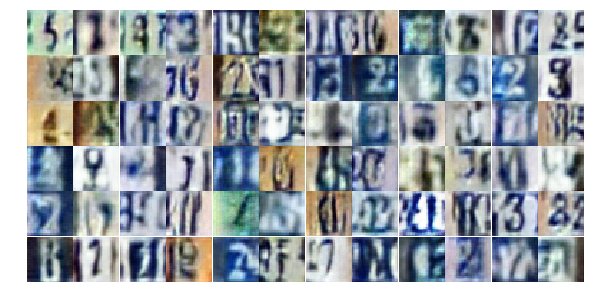

Epoch 9/25... Discriminator Loss: 0.6573... Generator Loss: 1.1456
Epoch 9/25... Discriminator Loss: 0.6055... Generator Loss: 1.2426
Epoch 9/25... Discriminator Loss: 0.8270... Generator Loss: 0.7448
Epoch 9/25... Discriminator Loss: 0.5209... Generator Loss: 1.3238
Epoch 9/25... Discriminator Loss: 0.7486... Generator Loss: 0.9437
Epoch 9/25... Discriminator Loss: 0.4676... Generator Loss: 1.4519
Epoch 9/25... Discriminator Loss: 0.3711... Generator Loss: 1.6547
Epoch 9/25... Discriminator Loss: 0.2292... Generator Loss: 2.0873
Epoch 9/25... Discriminator Loss: 0.7357... Generator Loss: 0.8676
Epoch 9/25... Discriminator Loss: 0.4174... Generator Loss: 1.4444


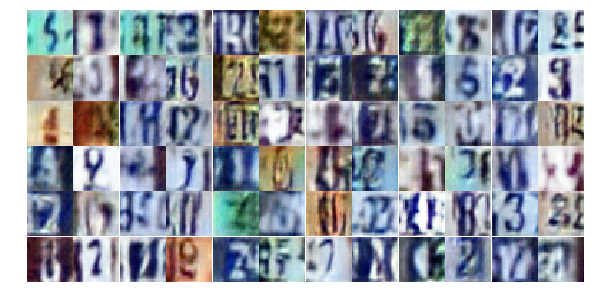

Epoch 9/25... Discriminator Loss: 0.4229... Generator Loss: 1.5170
Epoch 9/25... Discriminator Loss: 0.3859... Generator Loss: 1.6720
Epoch 9/25... Discriminator Loss: 0.3468... Generator Loss: 1.7781
Epoch 9/25... Discriminator Loss: 0.3590... Generator Loss: 1.8219
Epoch 9/25... Discriminator Loss: 0.7504... Generator Loss: 3.6513
Epoch 9/25... Discriminator Loss: 0.6718... Generator Loss: 0.9679
Epoch 9/25... Discriminator Loss: 0.5516... Generator Loss: 1.1746
Epoch 9/25... Discriminator Loss: 2.0791... Generator Loss: 0.1750
Epoch 9/25... Discriminator Loss: 0.9820... Generator Loss: 2.2513
Epoch 9/25... Discriminator Loss: 0.6883... Generator Loss: 2.3125


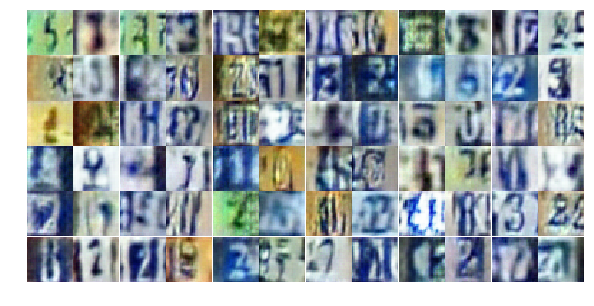

Epoch 9/25... Discriminator Loss: 0.6768... Generator Loss: 1.0118
Epoch 9/25... Discriminator Loss: 0.5109... Generator Loss: 2.3173
Epoch 9/25... Discriminator Loss: 0.4483... Generator Loss: 1.6519
Epoch 9/25... Discriminator Loss: 0.8716... Generator Loss: 0.7130
Epoch 9/25... Discriminator Loss: 0.4131... Generator Loss: 1.8856
Epoch 10/25... Discriminator Loss: 0.5642... Generator Loss: 1.1754
Epoch 10/25... Discriminator Loss: 0.3847... Generator Loss: 1.6555
Epoch 10/25... Discriminator Loss: 0.4989... Generator Loss: 1.2512
Epoch 10/25... Discriminator Loss: 0.5075... Generator Loss: 1.5489
Epoch 10/25... Discriminator Loss: 1.0647... Generator Loss: 0.5710


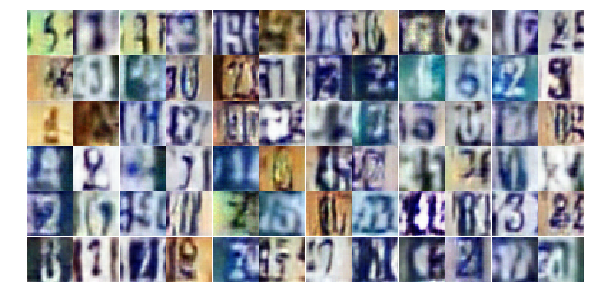

Epoch 10/25... Discriminator Loss: 0.6276... Generator Loss: 1.2261
Epoch 10/25... Discriminator Loss: 0.5863... Generator Loss: 1.2142
Epoch 10/25... Discriminator Loss: 0.9807... Generator Loss: 0.6838
Epoch 10/25... Discriminator Loss: 0.5289... Generator Loss: 1.4991
Epoch 10/25... Discriminator Loss: 0.4392... Generator Loss: 1.6169
Epoch 10/25... Discriminator Loss: 0.5710... Generator Loss: 1.1345
Epoch 10/25... Discriminator Loss: 0.5679... Generator Loss: 1.1352
Epoch 10/25... Discriminator Loss: 0.9661... Generator Loss: 0.8091
Epoch 10/25... Discriminator Loss: 0.6124... Generator Loss: 1.0984
Epoch 10/25... Discriminator Loss: 0.6622... Generator Loss: 1.1212


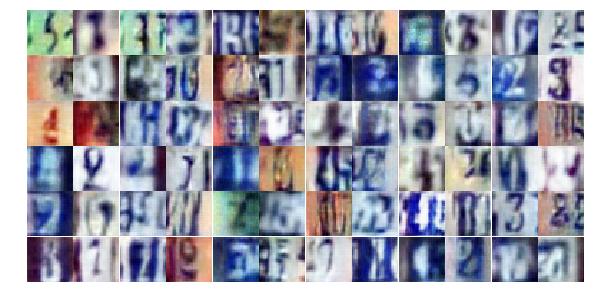

Epoch 10/25... Discriminator Loss: 0.7340... Generator Loss: 1.1153
Epoch 10/25... Discriminator Loss: 0.8433... Generator Loss: 0.8308
Epoch 10/25... Discriminator Loss: 0.5398... Generator Loss: 1.5501
Epoch 10/25... Discriminator Loss: 0.9327... Generator Loss: 0.7507
Epoch 10/25... Discriminator Loss: 0.5079... Generator Loss: 1.5009
Epoch 10/25... Discriminator Loss: 0.7767... Generator Loss: 0.8892
Epoch 10/25... Discriminator Loss: 0.8110... Generator Loss: 0.8291
Epoch 10/25... Discriminator Loss: 0.4037... Generator Loss: 1.7056
Epoch 10/25... Discriminator Loss: 0.6911... Generator Loss: 0.9479
Epoch 10/25... Discriminator Loss: 0.4168... Generator Loss: 3.1285


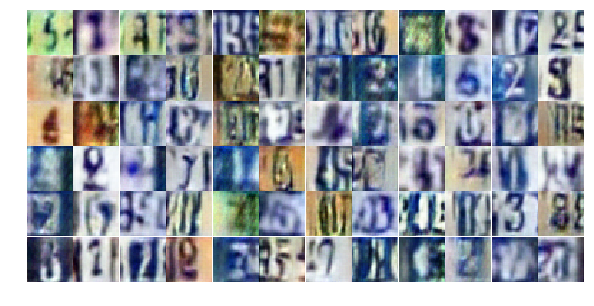

Epoch 10/25... Discriminator Loss: 0.4981... Generator Loss: 1.2783
Epoch 10/25... Discriminator Loss: 0.4809... Generator Loss: 1.4843
Epoch 10/25... Discriminator Loss: 0.3656... Generator Loss: 1.6547
Epoch 10/25... Discriminator Loss: 0.4077... Generator Loss: 1.4951
Epoch 10/25... Discriminator Loss: 1.5042... Generator Loss: 0.3149
Epoch 10/25... Discriminator Loss: 0.5976... Generator Loss: 1.2651
Epoch 10/25... Discriminator Loss: 0.2643... Generator Loss: 1.9071
Epoch 10/25... Discriminator Loss: 0.6094... Generator Loss: 2.5145
Epoch 10/25... Discriminator Loss: 0.5355... Generator Loss: 1.2046
Epoch 10/25... Discriminator Loss: 0.6491... Generator Loss: 1.9564


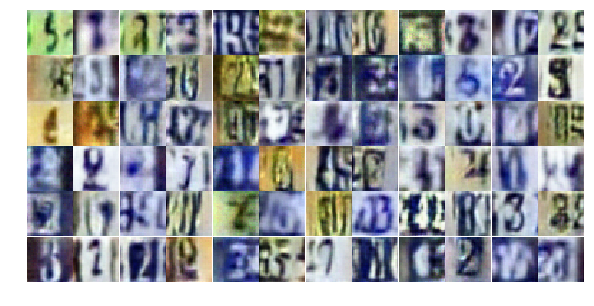

Epoch 10/25... Discriminator Loss: 0.4390... Generator Loss: 1.9238
Epoch 10/25... Discriminator Loss: 0.7057... Generator Loss: 0.8783
Epoch 10/25... Discriminator Loss: 0.6244... Generator Loss: 3.2026
Epoch 10/25... Discriminator Loss: 0.6550... Generator Loss: 2.2143
Epoch 10/25... Discriminator Loss: 0.5870... Generator Loss: 1.3549
Epoch 10/25... Discriminator Loss: 0.4424... Generator Loss: 1.4485
Epoch 10/25... Discriminator Loss: 0.5613... Generator Loss: 1.2696
Epoch 10/25... Discriminator Loss: 0.8271... Generator Loss: 0.8579
Epoch 10/25... Discriminator Loss: 0.5924... Generator Loss: 1.0685
Epoch 10/25... Discriminator Loss: 1.5923... Generator Loss: 0.4795


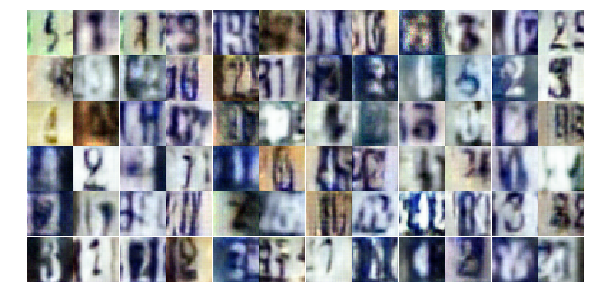

Epoch 10/25... Discriminator Loss: 1.0317... Generator Loss: 1.1553
Epoch 10/25... Discriminator Loss: 0.6850... Generator Loss: 2.5553
Epoch 10/25... Discriminator Loss: 0.6078... Generator Loss: 1.1571
Epoch 10/25... Discriminator Loss: 0.9937... Generator Loss: 0.6141
Epoch 10/25... Discriminator Loss: 0.4353... Generator Loss: 1.4783
Epoch 10/25... Discriminator Loss: 0.4465... Generator Loss: 1.3664
Epoch 10/25... Discriminator Loss: 0.4763... Generator Loss: 1.3507
Epoch 10/25... Discriminator Loss: 0.2928... Generator Loss: 2.0092
Epoch 10/25... Discriminator Loss: 0.7166... Generator Loss: 3.7012
Epoch 10/25... Discriminator Loss: 0.3395... Generator Loss: 2.1412


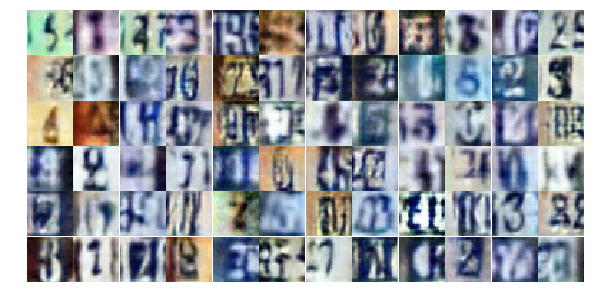

Epoch 10/25... Discriminator Loss: 0.6205... Generator Loss: 1.3161
Epoch 10/25... Discriminator Loss: 0.7576... Generator Loss: 0.9460
Epoch 10/25... Discriminator Loss: 0.3790... Generator Loss: 1.5944
Epoch 11/25... Discriminator Loss: 0.8802... Generator Loss: 0.7539
Epoch 11/25... Discriminator Loss: 0.6702... Generator Loss: 1.0121
Epoch 11/25... Discriminator Loss: 1.2089... Generator Loss: 0.5046
Epoch 11/25... Discriminator Loss: 0.5163... Generator Loss: 1.2651
Epoch 11/25... Discriminator Loss: 0.6113... Generator Loss: 1.1721
Epoch 11/25... Discriminator Loss: 1.7877... Generator Loss: 0.2653
Epoch 11/25... Discriminator Loss: 0.8052... Generator Loss: 1.1282


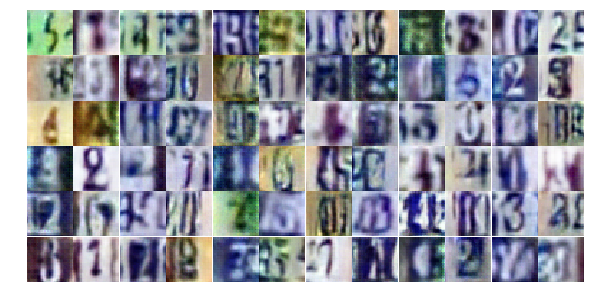

Epoch 11/25... Discriminator Loss: 0.4315... Generator Loss: 2.1369
Epoch 11/25... Discriminator Loss: 0.5835... Generator Loss: 1.2324
Epoch 11/25... Discriminator Loss: 0.2364... Generator Loss: 2.3677
Epoch 11/25... Discriminator Loss: 0.4436... Generator Loss: 1.5912
Epoch 11/25... Discriminator Loss: 0.6013... Generator Loss: 1.2024
Epoch 11/25... Discriminator Loss: 0.3918... Generator Loss: 1.8834
Epoch 11/25... Discriminator Loss: 0.5662... Generator Loss: 1.5354
Epoch 11/25... Discriminator Loss: 0.1586... Generator Loss: 2.9195
Epoch 11/25... Discriminator Loss: 0.3871... Generator Loss: 1.5541
Epoch 11/25... Discriminator Loss: 1.3203... Generator Loss: 0.5130


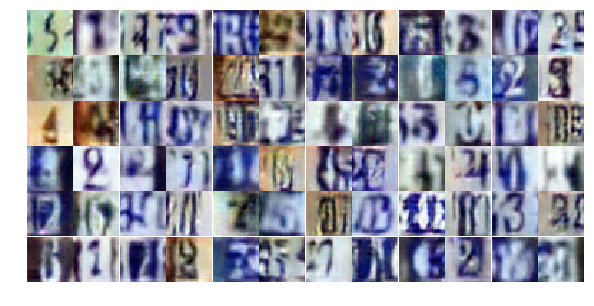

Epoch 11/25... Discriminator Loss: 0.8907... Generator Loss: 0.7521
Epoch 11/25... Discriminator Loss: 0.5025... Generator Loss: 2.4002
Epoch 11/25... Discriminator Loss: 0.5507... Generator Loss: 1.1396
Epoch 11/25... Discriminator Loss: 0.3970... Generator Loss: 1.5449
Epoch 11/25... Discriminator Loss: 0.1977... Generator Loss: 2.5054
Epoch 11/25... Discriminator Loss: 0.2586... Generator Loss: 2.1232
Epoch 11/25... Discriminator Loss: 0.3574... Generator Loss: 1.6148
Epoch 11/25... Discriminator Loss: 0.7742... Generator Loss: 0.8537
Epoch 11/25... Discriminator Loss: 0.0934... Generator Loss: 3.7692
Epoch 11/25... Discriminator Loss: 0.5725... Generator Loss: 1.1062


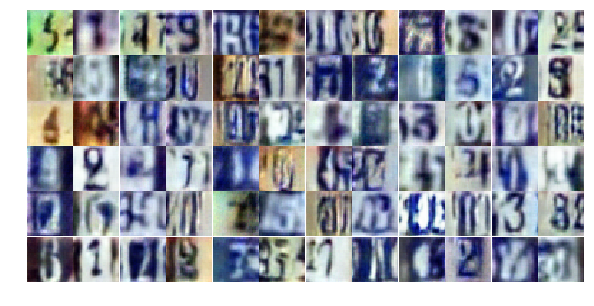

Epoch 11/25... Discriminator Loss: 0.4774... Generator Loss: 1.5619
Epoch 11/25... Discriminator Loss: 0.6523... Generator Loss: 1.7837
Epoch 11/25... Discriminator Loss: 0.4477... Generator Loss: 1.5460
Epoch 11/25... Discriminator Loss: 0.3921... Generator Loss: 1.4198
Epoch 11/25... Discriminator Loss: 0.5937... Generator Loss: 1.0988
Epoch 11/25... Discriminator Loss: 1.4853... Generator Loss: 0.3541
Epoch 11/25... Discriminator Loss: 1.4010... Generator Loss: 0.3934
Epoch 11/25... Discriminator Loss: 1.4211... Generator Loss: 0.3922
Epoch 11/25... Discriminator Loss: 0.4854... Generator Loss: 1.3484
Epoch 11/25... Discriminator Loss: 0.5206... Generator Loss: 1.5294


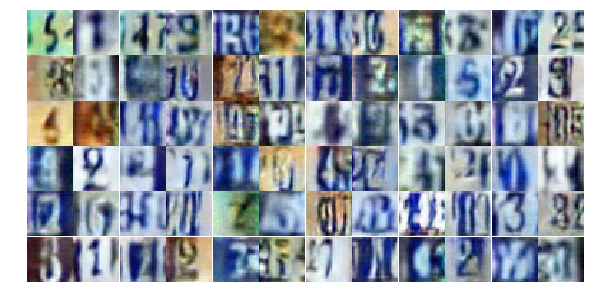

Epoch 11/25... Discriminator Loss: 0.2706... Generator Loss: 2.2584
Epoch 11/25... Discriminator Loss: 0.4056... Generator Loss: 1.4471
Epoch 11/25... Discriminator Loss: 0.3839... Generator Loss: 1.6535
Epoch 11/25... Discriminator Loss: 0.3487... Generator Loss: 1.9060
Epoch 11/25... Discriminator Loss: 0.7214... Generator Loss: 0.8610
Epoch 11/25... Discriminator Loss: 0.7565... Generator Loss: 0.8171
Epoch 11/25... Discriminator Loss: 0.2891... Generator Loss: 1.7208
Epoch 11/25... Discriminator Loss: 0.8637... Generator Loss: 1.7181
Epoch 11/25... Discriminator Loss: 1.6379... Generator Loss: 0.3173
Epoch 11/25... Discriminator Loss: 0.2628... Generator Loss: 2.0541


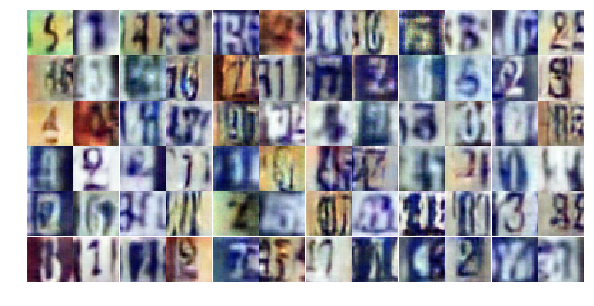

Epoch 11/25... Discriminator Loss: 0.4974... Generator Loss: 1.4442
Epoch 11/25... Discriminator Loss: 0.2143... Generator Loss: 2.7332
Epoch 11/25... Discriminator Loss: 0.4213... Generator Loss: 1.5669
Epoch 11/25... Discriminator Loss: 0.3195... Generator Loss: 1.8130
Epoch 11/25... Discriminator Loss: 0.8373... Generator Loss: 0.8109
Epoch 11/25... Discriminator Loss: 0.8490... Generator Loss: 0.7432
Epoch 11/25... Discriminator Loss: 0.9374... Generator Loss: 0.7604
Epoch 11/25... Discriminator Loss: 0.3137... Generator Loss: 2.1558
Epoch 11/25... Discriminator Loss: 0.8829... Generator Loss: 0.6784
Epoch 11/25... Discriminator Loss: 0.6059... Generator Loss: 1.1962


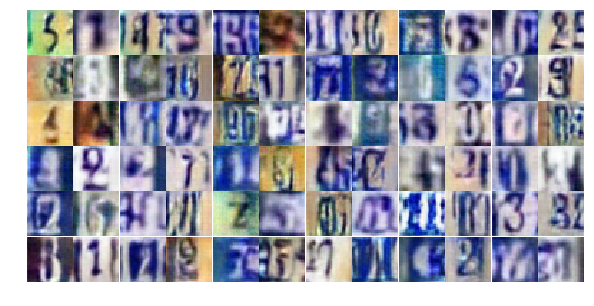

Epoch 12/25... Discriminator Loss: 0.8739... Generator Loss: 2.8459
Epoch 12/25... Discriminator Loss: 0.4184... Generator Loss: 1.5751
Epoch 12/25... Discriminator Loss: 0.9260... Generator Loss: 0.7000
Epoch 12/25... Discriminator Loss: 0.2313... Generator Loss: 2.6383
Epoch 12/25... Discriminator Loss: 0.2742... Generator Loss: 2.3761
Epoch 12/25... Discriminator Loss: 0.4944... Generator Loss: 1.3221
Epoch 12/25... Discriminator Loss: 0.5867... Generator Loss: 1.1769
Epoch 12/25... Discriminator Loss: 0.4926... Generator Loss: 1.3301
Epoch 12/25... Discriminator Loss: 0.3693... Generator Loss: 1.6985
Epoch 12/25... Discriminator Loss: 0.8484... Generator Loss: 0.7472


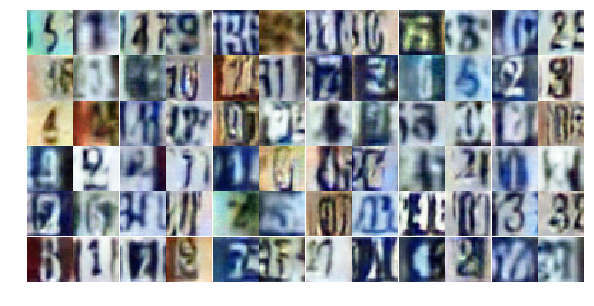

Epoch 12/25... Discriminator Loss: 0.4405... Generator Loss: 2.9777
Epoch 12/25... Discriminator Loss: 2.0273... Generator Loss: 0.2218
Epoch 12/25... Discriminator Loss: 1.1800... Generator Loss: 3.1143
Epoch 12/25... Discriminator Loss: 0.6392... Generator Loss: 1.5665
Epoch 12/25... Discriminator Loss: 0.4432... Generator Loss: 1.8788
Epoch 12/25... Discriminator Loss: 0.9226... Generator Loss: 0.7691
Epoch 12/25... Discriminator Loss: 1.6903... Generator Loss: 0.3308
Epoch 12/25... Discriminator Loss: 0.4843... Generator Loss: 1.9411
Epoch 12/25... Discriminator Loss: 0.4550... Generator Loss: 1.5017
Epoch 12/25... Discriminator Loss: 0.8749... Generator Loss: 0.7862


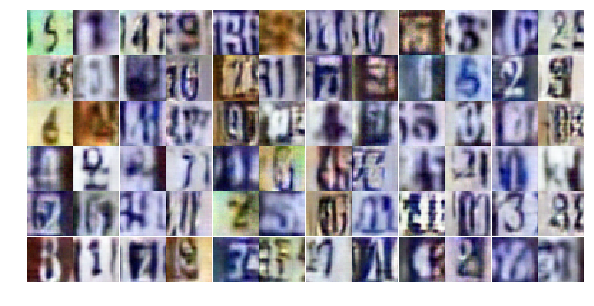

Epoch 12/25... Discriminator Loss: 0.2841... Generator Loss: 1.8014
Epoch 12/25... Discriminator Loss: 0.3908... Generator Loss: 1.5766
Epoch 12/25... Discriminator Loss: 0.4133... Generator Loss: 1.4528
Epoch 12/25... Discriminator Loss: 0.4155... Generator Loss: 1.7506
Epoch 12/25... Discriminator Loss: 0.3257... Generator Loss: 2.3575
Epoch 12/25... Discriminator Loss: 0.3990... Generator Loss: 1.4100
Epoch 12/25... Discriminator Loss: 0.4943... Generator Loss: 1.3318
Epoch 12/25... Discriminator Loss: 0.4434... Generator Loss: 1.4418
Epoch 12/25... Discriminator Loss: 0.2986... Generator Loss: 2.2161
Epoch 12/25... Discriminator Loss: 0.4844... Generator Loss: 1.4456


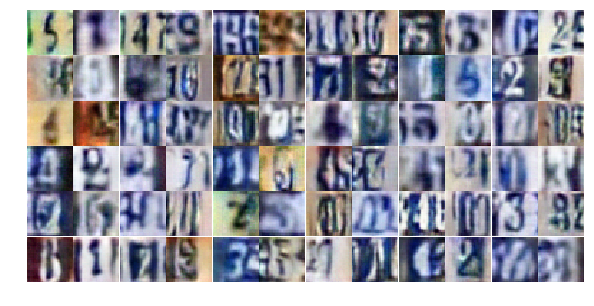

Epoch 12/25... Discriminator Loss: 0.4150... Generator Loss: 1.5106
Epoch 12/25... Discriminator Loss: 0.7854... Generator Loss: 0.8204
Epoch 12/25... Discriminator Loss: 0.5930... Generator Loss: 1.1164
Epoch 12/25... Discriminator Loss: 1.9518... Generator Loss: 0.2373
Epoch 12/25... Discriminator Loss: 0.5099... Generator Loss: 1.7116
Epoch 12/25... Discriminator Loss: 0.5433... Generator Loss: 1.2259
Epoch 12/25... Discriminator Loss: 0.9936... Generator Loss: 1.1321
Epoch 12/25... Discriminator Loss: 1.0037... Generator Loss: 0.6726
Epoch 12/25... Discriminator Loss: 0.4802... Generator Loss: 1.5672
Epoch 12/25... Discriminator Loss: 0.3132... Generator Loss: 1.7205


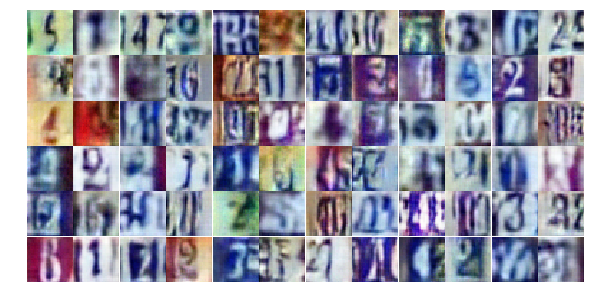

Epoch 12/25... Discriminator Loss: 0.4719... Generator Loss: 1.3473
Epoch 12/25... Discriminator Loss: 0.3876... Generator Loss: 1.4395
Epoch 12/25... Discriminator Loss: 0.4110... Generator Loss: 1.4009
Epoch 12/25... Discriminator Loss: 0.6217... Generator Loss: 1.0724
Epoch 12/25... Discriminator Loss: 0.4610... Generator Loss: 1.5238
Epoch 12/25... Discriminator Loss: 0.9941... Generator Loss: 0.6202
Epoch 12/25... Discriminator Loss: 0.7155... Generator Loss: 1.0942
Epoch 12/25... Discriminator Loss: 0.5400... Generator Loss: 1.3162
Epoch 12/25... Discriminator Loss: 0.4249... Generator Loss: 1.4914
Epoch 12/25... Discriminator Loss: 0.6204... Generator Loss: 1.1233


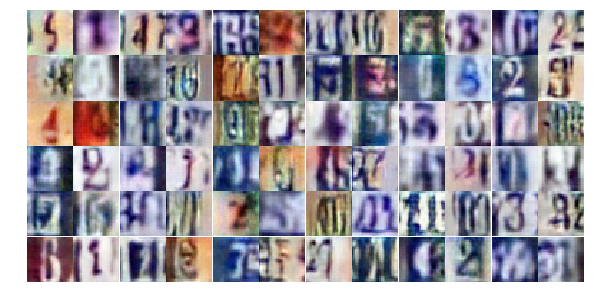

Epoch 12/25... Discriminator Loss: 0.9761... Generator Loss: 0.8066
Epoch 12/25... Discriminator Loss: 0.9568... Generator Loss: 0.7799
Epoch 12/25... Discriminator Loss: 1.0022... Generator Loss: 2.9437
Epoch 12/25... Discriminator Loss: 1.0524... Generator Loss: 0.7846
Epoch 12/25... Discriminator Loss: 0.3173... Generator Loss: 1.9517
Epoch 12/25... Discriminator Loss: 0.7066... Generator Loss: 2.1329
Epoch 12/25... Discriminator Loss: 1.2602... Generator Loss: 0.4525
Epoch 13/25... Discriminator Loss: 0.5319... Generator Loss: 1.2194
Epoch 13/25... Discriminator Loss: 0.3695... Generator Loss: 1.6674
Epoch 13/25... Discriminator Loss: 0.6572... Generator Loss: 0.9835


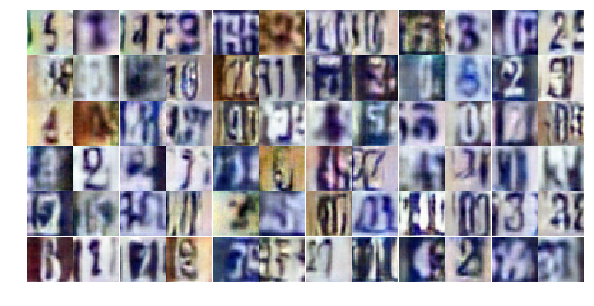

Epoch 13/25... Discriminator Loss: 0.5082... Generator Loss: 1.1978
Epoch 13/25... Discriminator Loss: 0.4570... Generator Loss: 1.3066
Epoch 13/25... Discriminator Loss: 0.9533... Generator Loss: 0.6475
Epoch 13/25... Discriminator Loss: 2.0418... Generator Loss: 0.2505
Epoch 13/25... Discriminator Loss: 0.6265... Generator Loss: 1.1661
Epoch 13/25... Discriminator Loss: 0.4244... Generator Loss: 1.8096
Epoch 13/25... Discriminator Loss: 0.3506... Generator Loss: 1.6249
Epoch 13/25... Discriminator Loss: 0.7484... Generator Loss: 0.8304
Epoch 13/25... Discriminator Loss: 0.4880... Generator Loss: 1.3108
Epoch 13/25... Discriminator Loss: 0.4737... Generator Loss: 1.3107


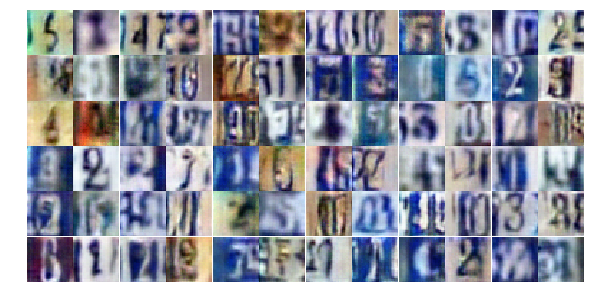

Epoch 13/25... Discriminator Loss: 0.5815... Generator Loss: 1.1471
Epoch 13/25... Discriminator Loss: 0.3641... Generator Loss: 1.6457
Epoch 13/25... Discriminator Loss: 0.7307... Generator Loss: 0.9423
Epoch 13/25... Discriminator Loss: 0.6722... Generator Loss: 0.9545
Epoch 13/25... Discriminator Loss: 0.5764... Generator Loss: 1.2426
Epoch 13/25... Discriminator Loss: 0.5312... Generator Loss: 1.3326
Epoch 13/25... Discriminator Loss: 0.5456... Generator Loss: 1.3063
Epoch 13/25... Discriminator Loss: 1.0328... Generator Loss: 0.6179
Epoch 13/25... Discriminator Loss: 0.5760... Generator Loss: 1.1766
Epoch 13/25... Discriminator Loss: 0.9134... Generator Loss: 0.7324


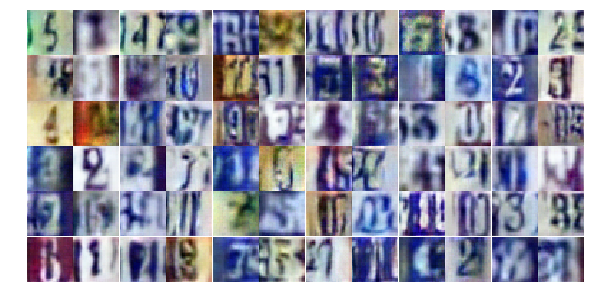

Epoch 13/25... Discriminator Loss: 0.4858... Generator Loss: 1.3646
Epoch 13/25... Discriminator Loss: 0.3284... Generator Loss: 1.8981
Epoch 13/25... Discriminator Loss: 0.3928... Generator Loss: 1.9932
Epoch 13/25... Discriminator Loss: 0.5500... Generator Loss: 1.1492
Epoch 13/25... Discriminator Loss: 0.4215... Generator Loss: 1.5137
Epoch 13/25... Discriminator Loss: 1.4559... Generator Loss: 0.4867
Epoch 13/25... Discriminator Loss: 0.5147... Generator Loss: 1.2742
Epoch 13/25... Discriminator Loss: 0.3446... Generator Loss: 1.9052
Epoch 13/25... Discriminator Loss: 0.3955... Generator Loss: 1.5327
Epoch 13/25... Discriminator Loss: 0.3645... Generator Loss: 1.9457


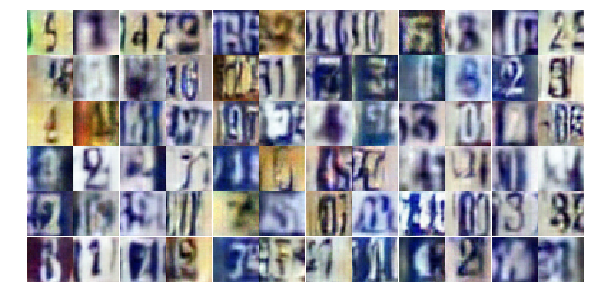

Epoch 13/25... Discriminator Loss: 0.6532... Generator Loss: 0.9961
Epoch 13/25... Discriminator Loss: 1.1887... Generator Loss: 0.5416
Epoch 13/25... Discriminator Loss: 1.5416... Generator Loss: 0.4329
Epoch 13/25... Discriminator Loss: 0.8356... Generator Loss: 0.8207
Epoch 13/25... Discriminator Loss: 0.4082... Generator Loss: 1.5455
Epoch 13/25... Discriminator Loss: 0.2627... Generator Loss: 2.1991
Epoch 13/25... Discriminator Loss: 0.2914... Generator Loss: 1.8428
Epoch 13/25... Discriminator Loss: 0.4286... Generator Loss: 1.5164
Epoch 13/25... Discriminator Loss: 0.4870... Generator Loss: 1.2383
Epoch 13/25... Discriminator Loss: 0.3790... Generator Loss: 1.5330


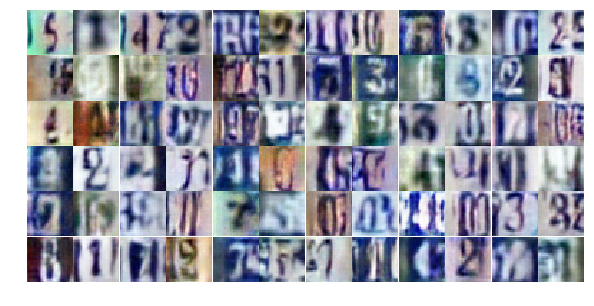

Epoch 13/25... Discriminator Loss: 0.3901... Generator Loss: 1.5940
Epoch 13/25... Discriminator Loss: 0.5630... Generator Loss: 2.0812
Epoch 13/25... Discriminator Loss: 0.6238... Generator Loss: 1.1291
Epoch 13/25... Discriminator Loss: 1.0129... Generator Loss: 0.6677
Epoch 13/25... Discriminator Loss: 0.7745... Generator Loss: 1.2953
Epoch 13/25... Discriminator Loss: 0.5028... Generator Loss: 1.8362
Epoch 13/25... Discriminator Loss: 0.3283... Generator Loss: 1.8636
Epoch 13/25... Discriminator Loss: 0.3857... Generator Loss: 1.5224
Epoch 13/25... Discriminator Loss: 1.1885... Generator Loss: 0.4814
Epoch 13/25... Discriminator Loss: 1.2091... Generator Loss: 0.5341


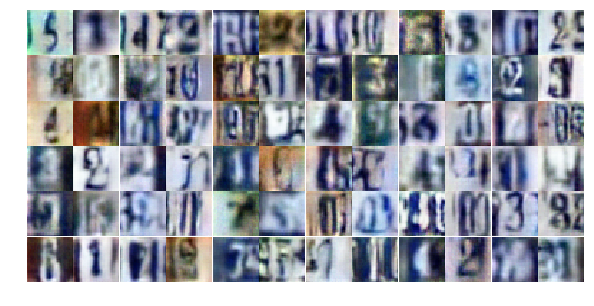

Epoch 13/25... Discriminator Loss: 0.5054... Generator Loss: 2.6882
Epoch 13/25... Discriminator Loss: 1.1493... Generator Loss: 0.5255
Epoch 13/25... Discriminator Loss: 0.7061... Generator Loss: 0.9832
Epoch 13/25... Discriminator Loss: 1.0337... Generator Loss: 0.6736
Epoch 14/25... Discriminator Loss: 1.2854... Generator Loss: 0.4542
Epoch 14/25... Discriminator Loss: 0.4923... Generator Loss: 1.3316
Epoch 14/25... Discriminator Loss: 0.7848... Generator Loss: 0.8881
Epoch 14/25... Discriminator Loss: 0.7341... Generator Loss: 2.1247
Epoch 14/25... Discriminator Loss: 0.5522... Generator Loss: 1.2877
Epoch 14/25... Discriminator Loss: 0.6629... Generator Loss: 2.0078


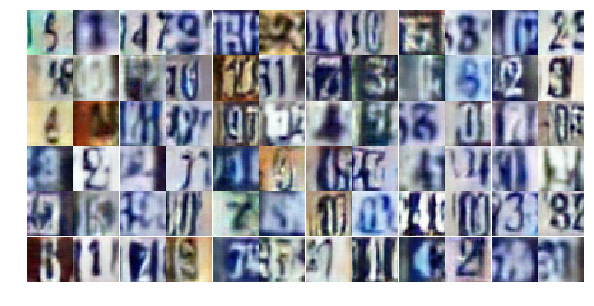

Epoch 14/25... Discriminator Loss: 0.5889... Generator Loss: 1.4638
Epoch 14/25... Discriminator Loss: 0.3738... Generator Loss: 1.5576
Epoch 14/25... Discriminator Loss: 0.3503... Generator Loss: 1.9574
Epoch 14/25... Discriminator Loss: 0.4293... Generator Loss: 1.5230
Epoch 14/25... Discriminator Loss: 1.5639... Generator Loss: 0.3170
Epoch 14/25... Discriminator Loss: 0.3137... Generator Loss: 1.6651
Epoch 14/25... Discriminator Loss: 0.2396... Generator Loss: 2.2753
Epoch 14/25... Discriminator Loss: 1.4376... Generator Loss: 0.3964
Epoch 14/25... Discriminator Loss: 1.0292... Generator Loss: 0.7299
Epoch 14/25... Discriminator Loss: 1.6298... Generator Loss: 0.3044


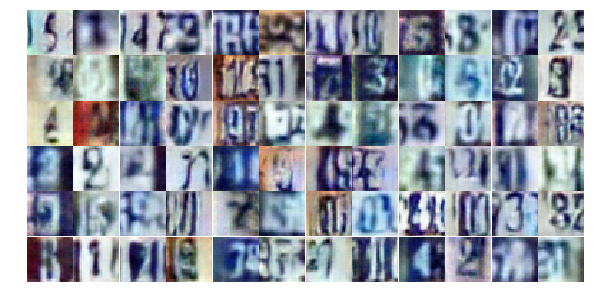

Epoch 14/25... Discriminator Loss: 0.3621... Generator Loss: 1.6273
Epoch 14/25... Discriminator Loss: 0.4906... Generator Loss: 1.3321
Epoch 14/25... Discriminator Loss: 1.3490... Generator Loss: 0.4373
Epoch 14/25... Discriminator Loss: 0.3082... Generator Loss: 2.1772
Epoch 14/25... Discriminator Loss: 0.8404... Generator Loss: 0.7963
Epoch 14/25... Discriminator Loss: 0.6266... Generator Loss: 1.0190
Epoch 14/25... Discriminator Loss: 0.5649... Generator Loss: 1.2269
Epoch 14/25... Discriminator Loss: 0.6311... Generator Loss: 0.9749
Epoch 14/25... Discriminator Loss: 0.4591... Generator Loss: 1.3230
Epoch 14/25... Discriminator Loss: 0.2197... Generator Loss: 2.5250


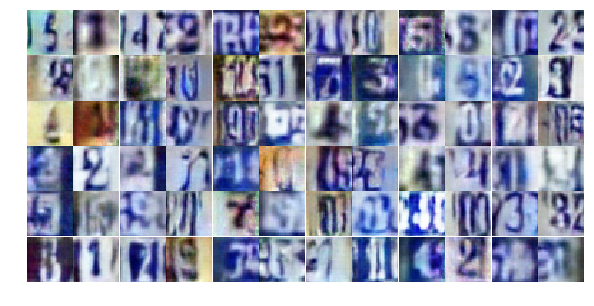

Epoch 14/25... Discriminator Loss: 1.4529... Generator Loss: 0.4251
Epoch 14/25... Discriminator Loss: 0.3564... Generator Loss: 2.1691
Epoch 14/25... Discriminator Loss: 0.3618... Generator Loss: 1.9634
Epoch 14/25... Discriminator Loss: 0.4742... Generator Loss: 1.3716
Epoch 14/25... Discriminator Loss: 0.4688... Generator Loss: 1.5455
Epoch 14/25... Discriminator Loss: 0.4499... Generator Loss: 1.6810
Epoch 14/25... Discriminator Loss: 0.5915... Generator Loss: 1.0905
Epoch 14/25... Discriminator Loss: 0.3120... Generator Loss: 1.8595
Epoch 14/25... Discriminator Loss: 0.3337... Generator Loss: 2.3432
Epoch 14/25... Discriminator Loss: 0.5405... Generator Loss: 1.5553


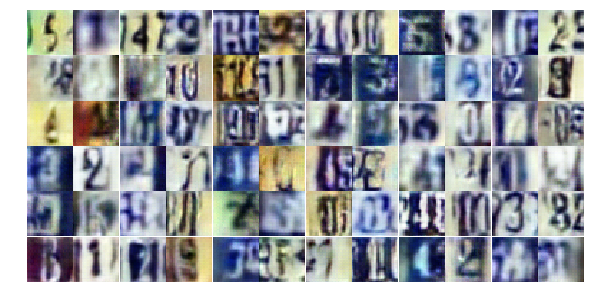

Epoch 14/25... Discriminator Loss: 1.1159... Generator Loss: 0.6398
Epoch 14/25... Discriminator Loss: 0.7884... Generator Loss: 0.8988
Epoch 14/25... Discriminator Loss: 0.5970... Generator Loss: 1.1623
Epoch 14/25... Discriminator Loss: 0.5603... Generator Loss: 1.1404
Epoch 14/25... Discriminator Loss: 0.7622... Generator Loss: 0.8479
Epoch 14/25... Discriminator Loss: 0.4727... Generator Loss: 1.2799
Epoch 14/25... Discriminator Loss: 0.7160... Generator Loss: 0.9784
Epoch 14/25... Discriminator Loss: 0.3869... Generator Loss: 1.6726
Epoch 14/25... Discriminator Loss: 0.5654... Generator Loss: 1.6068
Epoch 14/25... Discriminator Loss: 2.6784... Generator Loss: 0.1171


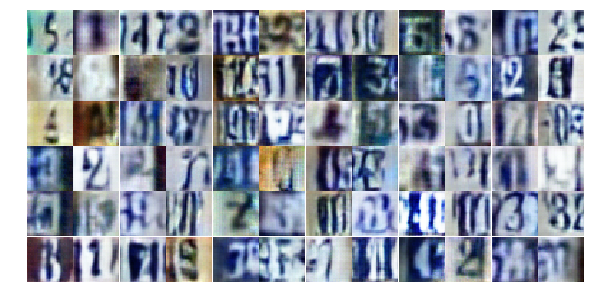

Epoch 14/25... Discriminator Loss: 1.1332... Generator Loss: 3.3688
Epoch 14/25... Discriminator Loss: 0.9887... Generator Loss: 0.6256
Epoch 14/25... Discriminator Loss: 0.7668... Generator Loss: 0.9523
Epoch 14/25... Discriminator Loss: 0.7429... Generator Loss: 0.8700
Epoch 14/25... Discriminator Loss: 0.5247... Generator Loss: 1.3367
Epoch 14/25... Discriminator Loss: 0.5823... Generator Loss: 1.2039
Epoch 14/25... Discriminator Loss: 0.4924... Generator Loss: 1.3249
Epoch 14/25... Discriminator Loss: 0.5966... Generator Loss: 1.0636
Epoch 14/25... Discriminator Loss: 0.7678... Generator Loss: 0.8763
Epoch 14/25... Discriminator Loss: 0.5876... Generator Loss: 1.0571


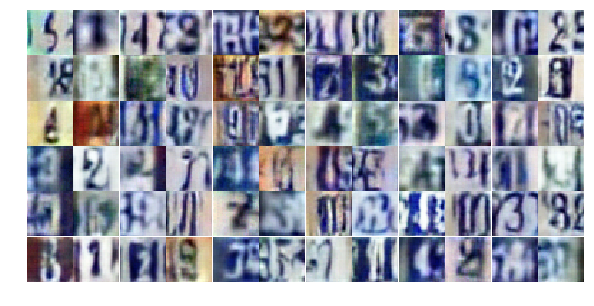

Epoch 14/25... Discriminator Loss: 0.5792... Generator Loss: 1.0865
Epoch 14/25... Discriminator Loss: 1.2309... Generator Loss: 0.5380
Epoch 15/25... Discriminator Loss: 0.7385... Generator Loss: 0.8701
Epoch 15/25... Discriminator Loss: 0.3591... Generator Loss: 1.6771
Epoch 15/25... Discriminator Loss: 0.4156... Generator Loss: 1.4742
Epoch 15/25... Discriminator Loss: 0.5817... Generator Loss: 1.1772
Epoch 15/25... Discriminator Loss: 0.5160... Generator Loss: 1.3041
Epoch 15/25... Discriminator Loss: 0.5657... Generator Loss: 1.1224
Epoch 15/25... Discriminator Loss: 2.3268... Generator Loss: 0.1529
Epoch 15/25... Discriminator Loss: 0.6185... Generator Loss: 1.3055


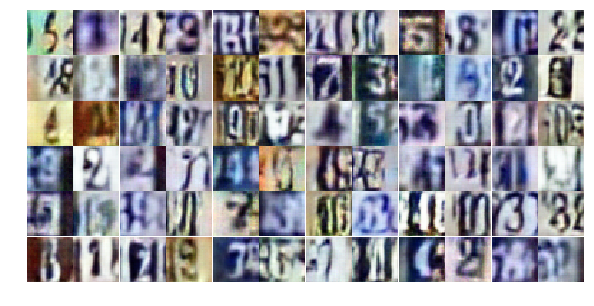

Epoch 15/25... Discriminator Loss: 0.5686... Generator Loss: 1.2022
Epoch 15/25... Discriminator Loss: 0.5527... Generator Loss: 1.7162
Epoch 15/25... Discriminator Loss: 0.5279... Generator Loss: 1.1778
Epoch 15/25... Discriminator Loss: 0.5414... Generator Loss: 1.1755
Epoch 15/25... Discriminator Loss: 0.9172... Generator Loss: 0.7416
Epoch 15/25... Discriminator Loss: 0.3999... Generator Loss: 1.6966
Epoch 15/25... Discriminator Loss: 0.8463... Generator Loss: 0.7258
Epoch 15/25... Discriminator Loss: 0.4133... Generator Loss: 1.6552
Epoch 15/25... Discriminator Loss: 0.2538... Generator Loss: 2.4169
Epoch 15/25... Discriminator Loss: 1.1726... Generator Loss: 0.5945


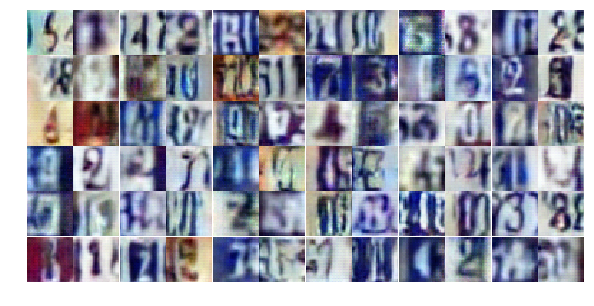

Epoch 15/25... Discriminator Loss: 0.6951... Generator Loss: 1.2580
Epoch 15/25... Discriminator Loss: 0.4972... Generator Loss: 1.3338
Epoch 15/25... Discriminator Loss: 0.3074... Generator Loss: 1.8271
Epoch 15/25... Discriminator Loss: 0.8577... Generator Loss: 0.7225
Epoch 15/25... Discriminator Loss: 1.4367... Generator Loss: 0.4012
Epoch 15/25... Discriminator Loss: 0.4844... Generator Loss: 1.3481
Epoch 15/25... Discriminator Loss: 1.2608... Generator Loss: 0.5415
Epoch 15/25... Discriminator Loss: 0.6542... Generator Loss: 0.9998
Epoch 15/25... Discriminator Loss: 0.3629... Generator Loss: 1.5808
Epoch 15/25... Discriminator Loss: 1.6093... Generator Loss: 0.3797


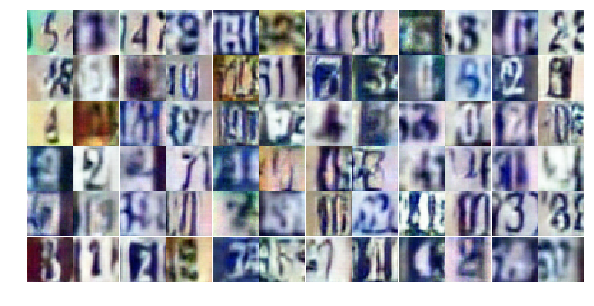

Epoch 15/25... Discriminator Loss: 0.5579... Generator Loss: 1.3144
Epoch 15/25... Discriminator Loss: 0.5286... Generator Loss: 1.2617
Epoch 15/25... Discriminator Loss: 0.4730... Generator Loss: 1.2511
Epoch 15/25... Discriminator Loss: 0.3931... Generator Loss: 1.6544
Epoch 15/25... Discriminator Loss: 0.4587... Generator Loss: 1.4292
Epoch 15/25... Discriminator Loss: 0.8212... Generator Loss: 1.1913
Epoch 15/25... Discriminator Loss: 0.6450... Generator Loss: 1.2147
Epoch 15/25... Discriminator Loss: 0.4525... Generator Loss: 1.5613
Epoch 15/25... Discriminator Loss: 0.6650... Generator Loss: 0.9756
Epoch 15/25... Discriminator Loss: 0.4849... Generator Loss: 1.2432


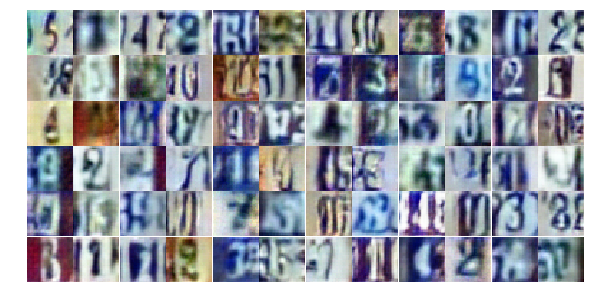

Epoch 15/25... Discriminator Loss: 0.5164... Generator Loss: 1.2918
Epoch 15/25... Discriminator Loss: 0.8157... Generator Loss: 0.8217
Epoch 15/25... Discriminator Loss: 0.5926... Generator Loss: 1.1019
Epoch 15/25... Discriminator Loss: 0.3389... Generator Loss: 1.6679
Epoch 15/25... Discriminator Loss: 0.4113... Generator Loss: 1.5935
Epoch 15/25... Discriminator Loss: 3.5101... Generator Loss: 3.9807
Epoch 15/25... Discriminator Loss: 2.6216... Generator Loss: 0.3531
Epoch 15/25... Discriminator Loss: 1.2917... Generator Loss: 0.6168
Epoch 15/25... Discriminator Loss: 0.7228... Generator Loss: 0.8947
Epoch 15/25... Discriminator Loss: 0.7464... Generator Loss: 0.9879


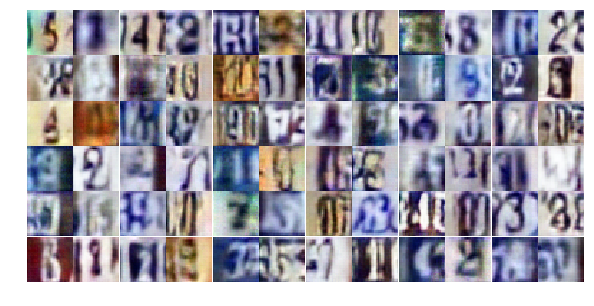

Epoch 15/25... Discriminator Loss: 0.8100... Generator Loss: 0.8692
Epoch 15/25... Discriminator Loss: 0.7702... Generator Loss: 0.9451
Epoch 15/25... Discriminator Loss: 0.4282... Generator Loss: 1.4408
Epoch 15/25... Discriminator Loss: 1.1626... Generator Loss: 0.5724
Epoch 15/25... Discriminator Loss: 0.4429... Generator Loss: 1.8853
Epoch 15/25... Discriminator Loss: 0.8323... Generator Loss: 0.8145
Epoch 15/25... Discriminator Loss: 0.5808... Generator Loss: 1.1043
Epoch 15/25... Discriminator Loss: 0.3893... Generator Loss: 1.8001
Epoch 15/25... Discriminator Loss: 1.3062... Generator Loss: 0.4893
Epoch 16/25... Discriminator Loss: 0.7749... Generator Loss: 0.8647


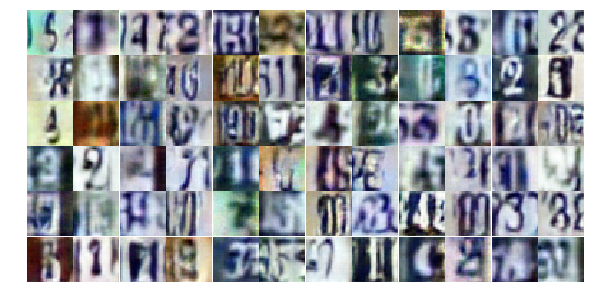

Epoch 16/25... Discriminator Loss: 0.4005... Generator Loss: 1.4809
Epoch 16/25... Discriminator Loss: 0.7831... Generator Loss: 0.8771
Epoch 16/25... Discriminator Loss: 0.8998... Generator Loss: 0.6937
Epoch 16/25... Discriminator Loss: 0.5414... Generator Loss: 1.4219
Epoch 16/25... Discriminator Loss: 0.4647... Generator Loss: 1.8441
Epoch 16/25... Discriminator Loss: 0.5933... Generator Loss: 2.0122
Epoch 16/25... Discriminator Loss: 1.4967... Generator Loss: 0.3492
Epoch 16/25... Discriminator Loss: 0.8605... Generator Loss: 0.7852
Epoch 16/25... Discriminator Loss: 0.3432... Generator Loss: 1.8151
Epoch 16/25... Discriminator Loss: 0.4167... Generator Loss: 1.5345


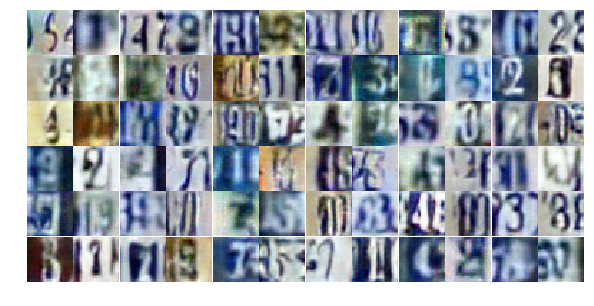

Epoch 16/25... Discriminator Loss: 0.7578... Generator Loss: 0.9188
Epoch 16/25... Discriminator Loss: 0.5429... Generator Loss: 1.2780
Epoch 16/25... Discriminator Loss: 1.1846... Generator Loss: 0.5723
Epoch 16/25... Discriminator Loss: 1.4145... Generator Loss: 0.3928
Epoch 16/25... Discriminator Loss: 0.3621... Generator Loss: 1.7852
Epoch 16/25... Discriminator Loss: 0.4900... Generator Loss: 1.3185
Epoch 16/25... Discriminator Loss: 0.6584... Generator Loss: 1.0829
Epoch 16/25... Discriminator Loss: 0.3938... Generator Loss: 1.3892
Epoch 16/25... Discriminator Loss: 0.2900... Generator Loss: 1.9145
Epoch 16/25... Discriminator Loss: 0.5303... Generator Loss: 1.1915


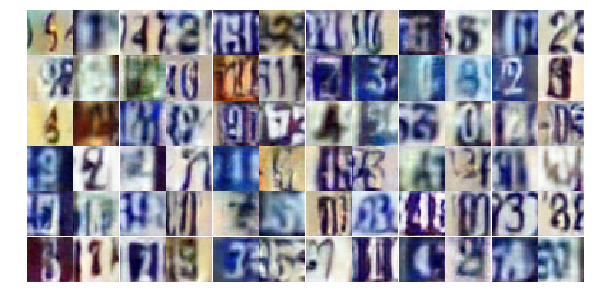

Epoch 16/25... Discriminator Loss: 0.4242... Generator Loss: 1.4648
Epoch 16/25... Discriminator Loss: 0.6401... Generator Loss: 1.0186
Epoch 16/25... Discriminator Loss: 0.6050... Generator Loss: 1.1675
Epoch 16/25... Discriminator Loss: 0.9016... Generator Loss: 0.7063
Epoch 16/25... Discriminator Loss: 0.5165... Generator Loss: 1.4666
Epoch 16/25... Discriminator Loss: 0.6965... Generator Loss: 1.0130
Epoch 16/25... Discriminator Loss: 0.4898... Generator Loss: 1.2349
Epoch 16/25... Discriminator Loss: 0.3308... Generator Loss: 1.8472
Epoch 16/25... Discriminator Loss: 0.9900... Generator Loss: 0.6693
Epoch 16/25... Discriminator Loss: 0.5603... Generator Loss: 1.1235


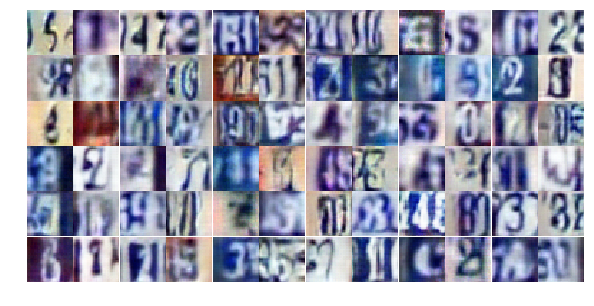

Epoch 16/25... Discriminator Loss: 0.5556... Generator Loss: 1.1635
Epoch 16/25... Discriminator Loss: 0.3286... Generator Loss: 1.8781
Epoch 16/25... Discriminator Loss: 0.5745... Generator Loss: 1.1613
Epoch 16/25... Discriminator Loss: 0.6740... Generator Loss: 2.5024
Epoch 16/25... Discriminator Loss: 0.7806... Generator Loss: 1.8021
Epoch 16/25... Discriminator Loss: 1.0408... Generator Loss: 3.5722
Epoch 16/25... Discriminator Loss: 0.6594... Generator Loss: 1.1629
Epoch 16/25... Discriminator Loss: 1.5165... Generator Loss: 0.3798
Epoch 16/25... Discriminator Loss: 0.6852... Generator Loss: 0.9674
Epoch 16/25... Discriminator Loss: 0.4793... Generator Loss: 2.7354


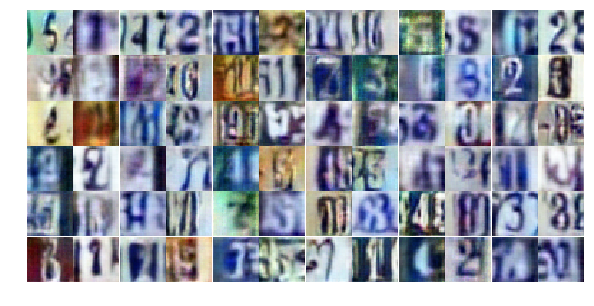

Epoch 16/25... Discriminator Loss: 0.6217... Generator Loss: 1.0620
Epoch 16/25... Discriminator Loss: 0.5412... Generator Loss: 1.1847
Epoch 16/25... Discriminator Loss: 1.0670... Generator Loss: 0.6118
Epoch 16/25... Discriminator Loss: 5.9841... Generator Loss: 0.2029
Epoch 16/25... Discriminator Loss: 1.7311... Generator Loss: 1.2105
Epoch 16/25... Discriminator Loss: 1.4769... Generator Loss: 0.7554
Epoch 16/25... Discriminator Loss: 1.4739... Generator Loss: 0.6570
Epoch 16/25... Discriminator Loss: 1.5648... Generator Loss: 1.0302
Epoch 16/25... Discriminator Loss: 1.3539... Generator Loss: 0.8958
Epoch 16/25... Discriminator Loss: 1.4719... Generator Loss: 0.6660


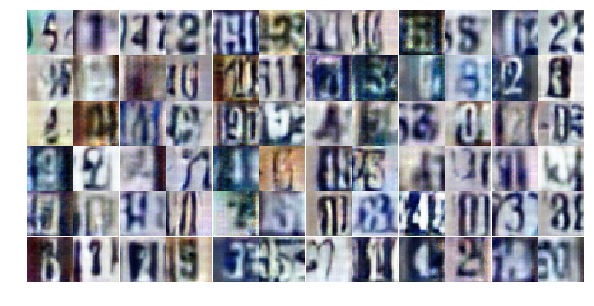

Epoch 16/25... Discriminator Loss: 1.4183... Generator Loss: 0.7717
Epoch 16/25... Discriminator Loss: 1.3716... Generator Loss: 0.7889
Epoch 16/25... Discriminator Loss: 1.3956... Generator Loss: 0.6348
Epoch 16/25... Discriminator Loss: 1.2902... Generator Loss: 0.8211
Epoch 16/25... Discriminator Loss: 1.3134... Generator Loss: 0.9191
Epoch 16/25... Discriminator Loss: 1.3326... Generator Loss: 0.8771
Epoch 17/25... Discriminator Loss: 1.2729... Generator Loss: 0.7365
Epoch 17/25... Discriminator Loss: 1.3422... Generator Loss: 0.7905
Epoch 17/25... Discriminator Loss: 1.1806... Generator Loss: 0.8568
Epoch 17/25... Discriminator Loss: 1.5510... Generator Loss: 0.7333


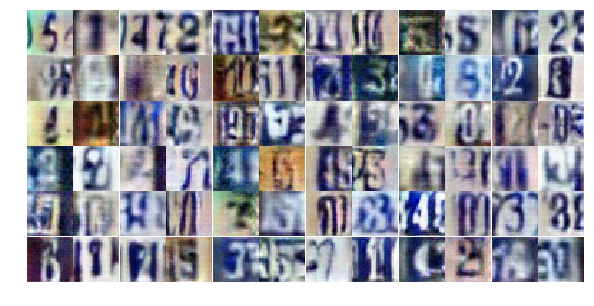

Epoch 17/25... Discriminator Loss: 1.2741... Generator Loss: 0.7896
Epoch 17/25... Discriminator Loss: 1.2794... Generator Loss: 0.7572
Epoch 17/25... Discriminator Loss: 1.2329... Generator Loss: 0.8594
Epoch 17/25... Discriminator Loss: 1.3541... Generator Loss: 0.6479
Epoch 17/25... Discriminator Loss: 1.3623... Generator Loss: 0.9296
Epoch 17/25... Discriminator Loss: 1.2968... Generator Loss: 0.7649
Epoch 17/25... Discriminator Loss: 1.5323... Generator Loss: 0.7956
Epoch 17/25... Discriminator Loss: 1.1919... Generator Loss: 0.7015
Epoch 17/25... Discriminator Loss: 0.9042... Generator Loss: 1.1810
Epoch 17/25... Discriminator Loss: 1.2208... Generator Loss: 1.4450


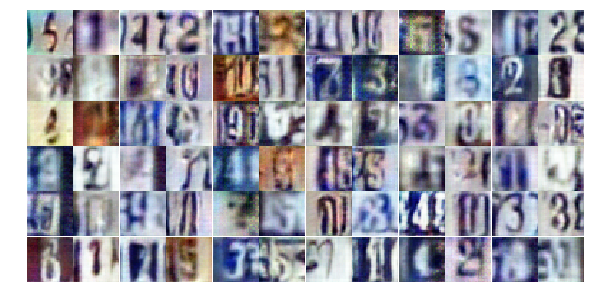

Epoch 17/25... Discriminator Loss: 1.6943... Generator Loss: 2.4392
Epoch 17/25... Discriminator Loss: 1.2054... Generator Loss: 1.8346
Epoch 17/25... Discriminator Loss: 0.7818... Generator Loss: 1.0744
Epoch 17/25... Discriminator Loss: 1.3445... Generator Loss: 0.4773
Epoch 17/25... Discriminator Loss: 0.4959... Generator Loss: 1.4947
Epoch 17/25... Discriminator Loss: 1.0610... Generator Loss: 0.6310
Epoch 17/25... Discriminator Loss: 0.6619... Generator Loss: 1.1808
Epoch 17/25... Discriminator Loss: 0.6099... Generator Loss: 1.1398
Epoch 17/25... Discriminator Loss: 0.6319... Generator Loss: 1.0448
Epoch 17/25... Discriminator Loss: 0.6885... Generator Loss: 1.0562


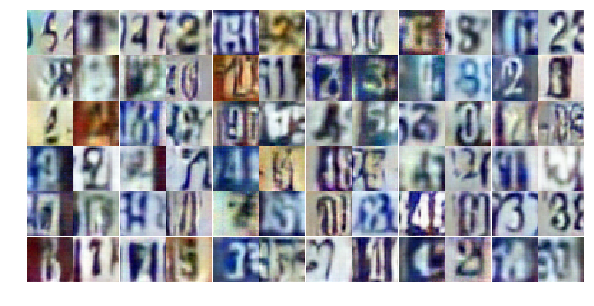

Epoch 17/25... Discriminator Loss: 1.6336... Generator Loss: 0.3075
Epoch 17/25... Discriminator Loss: 0.3294... Generator Loss: 2.0454
Epoch 17/25... Discriminator Loss: 0.5305... Generator Loss: 1.2507
Epoch 17/25... Discriminator Loss: 0.9229... Generator Loss: 0.7637
Epoch 17/25... Discriminator Loss: 0.9321... Generator Loss: 0.7593
Epoch 17/25... Discriminator Loss: 0.3651... Generator Loss: 1.5358
Epoch 17/25... Discriminator Loss: 0.6738... Generator Loss: 1.0143
Epoch 17/25... Discriminator Loss: 0.7967... Generator Loss: 0.8520
Epoch 17/25... Discriminator Loss: 0.7648... Generator Loss: 0.8378
Epoch 17/25... Discriminator Loss: 0.5716... Generator Loss: 1.2834


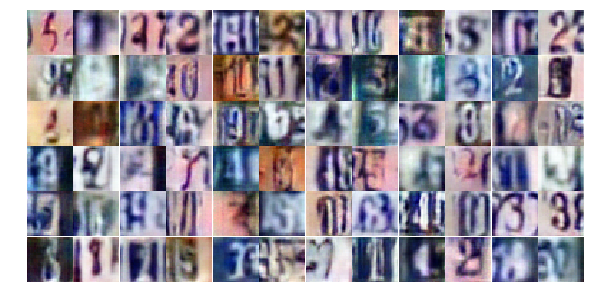

Epoch 17/25... Discriminator Loss: 0.6532... Generator Loss: 1.1122
Epoch 17/25... Discriminator Loss: 1.2318... Generator Loss: 0.4725
Epoch 17/25... Discriminator Loss: 0.6165... Generator Loss: 1.1010
Epoch 17/25... Discriminator Loss: 0.6896... Generator Loss: 0.9370
Epoch 17/25... Discriminator Loss: 1.1095... Generator Loss: 0.5456
Epoch 17/25... Discriminator Loss: 0.5550... Generator Loss: 1.3336
Epoch 17/25... Discriminator Loss: 0.6694... Generator Loss: 1.0945
Epoch 17/25... Discriminator Loss: 0.3376... Generator Loss: 1.9393
Epoch 17/25... Discriminator Loss: 0.3961... Generator Loss: 1.4877
Epoch 17/25... Discriminator Loss: 0.6491... Generator Loss: 0.9962


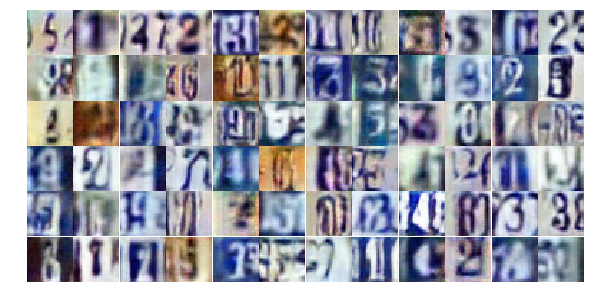

Epoch 17/25... Discriminator Loss: 1.1988... Generator Loss: 1.1007
Epoch 17/25... Discriminator Loss: 0.2020... Generator Loss: 2.0974
Epoch 17/25... Discriminator Loss: 0.8410... Generator Loss: 0.8976
Epoch 17/25... Discriminator Loss: 0.4425... Generator Loss: 1.3601
Epoch 17/25... Discriminator Loss: 0.7036... Generator Loss: 0.9880
Epoch 17/25... Discriminator Loss: 0.7545... Generator Loss: 0.9320
Epoch 17/25... Discriminator Loss: 1.0541... Generator Loss: 0.5971
Epoch 17/25... Discriminator Loss: 0.4447... Generator Loss: 1.3773
Epoch 17/25... Discriminator Loss: 0.9815... Generator Loss: 3.5397
Epoch 17/25... Discriminator Loss: 1.8114... Generator Loss: 0.3174


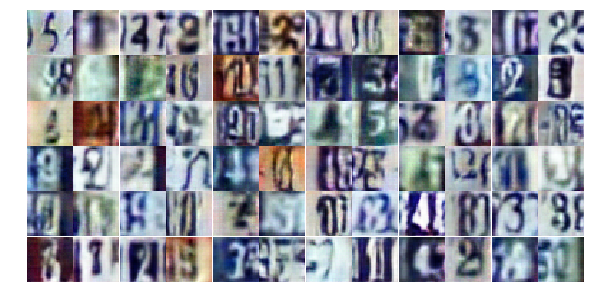

Epoch 17/25... Discriminator Loss: 0.6316... Generator Loss: 1.3761
Epoch 17/25... Discriminator Loss: 1.1462... Generator Loss: 0.5118
Epoch 17/25... Discriminator Loss: 0.4584... Generator Loss: 1.3014
Epoch 17/25... Discriminator Loss: 0.4422... Generator Loss: 1.6203
Epoch 18/25... Discriminator Loss: 0.9797... Generator Loss: 0.6641
Epoch 18/25... Discriminator Loss: 0.4825... Generator Loss: 1.2739
Epoch 18/25... Discriminator Loss: 0.5388... Generator Loss: 1.3337
Epoch 18/25... Discriminator Loss: 0.5113... Generator Loss: 1.1999
Epoch 18/25... Discriminator Loss: 1.3052... Generator Loss: 0.4785
Epoch 18/25... Discriminator Loss: 0.5602... Generator Loss: 1.1830


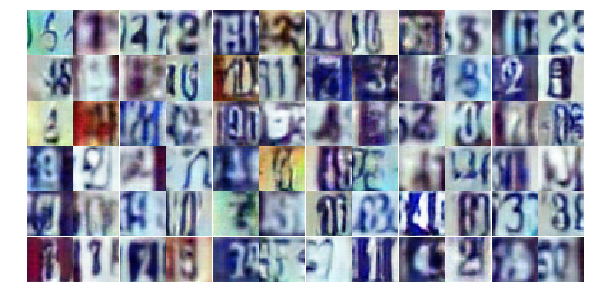

Epoch 18/25... Discriminator Loss: 0.3517... Generator Loss: 1.7923
Epoch 18/25... Discriminator Loss: 1.0341... Generator Loss: 0.6254
Epoch 18/25... Discriminator Loss: 0.7765... Generator Loss: 0.8679
Epoch 18/25... Discriminator Loss: 0.3102... Generator Loss: 2.0730
Epoch 18/25... Discriminator Loss: 0.5300... Generator Loss: 2.1648
Epoch 18/25... Discriminator Loss: 0.5694... Generator Loss: 1.2889
Epoch 18/25... Discriminator Loss: 0.4638... Generator Loss: 1.4022
Epoch 18/25... Discriminator Loss: 1.0066... Generator Loss: 0.6501
Epoch 18/25... Discriminator Loss: 0.5868... Generator Loss: 1.1991
Epoch 18/25... Discriminator Loss: 0.3092... Generator Loss: 1.7640


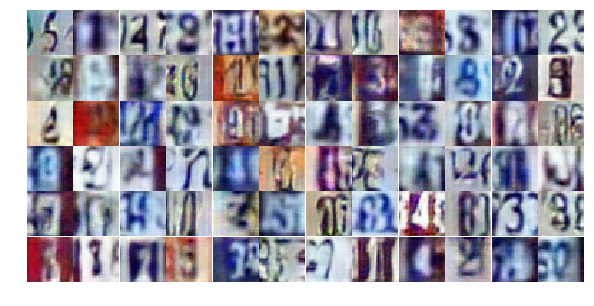

Epoch 18/25... Discriminator Loss: 0.6380... Generator Loss: 1.2361
Epoch 18/25... Discriminator Loss: 0.4750... Generator Loss: 1.4066
Epoch 18/25... Discriminator Loss: 1.3490... Generator Loss: 0.4803
Epoch 18/25... Discriminator Loss: 0.3369... Generator Loss: 1.6980
Epoch 18/25... Discriminator Loss: 0.9044... Generator Loss: 0.7315
Epoch 18/25... Discriminator Loss: 3.1357... Generator Loss: 4.7628
Epoch 18/25... Discriminator Loss: 1.5731... Generator Loss: 0.4312
Epoch 18/25... Discriminator Loss: 0.6135... Generator Loss: 1.1181
Epoch 18/25... Discriminator Loss: 0.6454... Generator Loss: 1.0374
Epoch 18/25... Discriminator Loss: 0.6150... Generator Loss: 1.0499


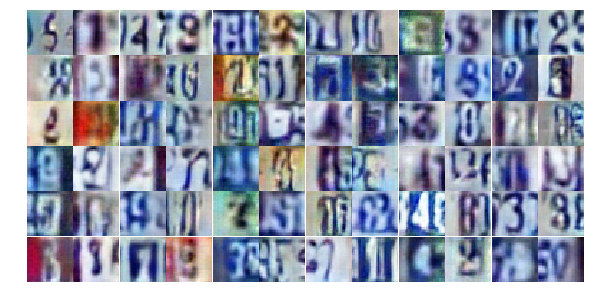

Epoch 18/25... Discriminator Loss: 0.4235... Generator Loss: 1.4085
Epoch 18/25... Discriminator Loss: 0.5945... Generator Loss: 1.3305
Epoch 18/25... Discriminator Loss: 0.5721... Generator Loss: 1.1619
Epoch 18/25... Discriminator Loss: 1.0417... Generator Loss: 0.6194
Epoch 18/25... Discriminator Loss: 1.2988... Generator Loss: 0.5181
Epoch 18/25... Discriminator Loss: 0.5787... Generator Loss: 1.2106
Epoch 18/25... Discriminator Loss: 0.5584... Generator Loss: 1.1998
Epoch 18/25... Discriminator Loss: 0.3883... Generator Loss: 1.8481
Epoch 18/25... Discriminator Loss: 0.5352... Generator Loss: 1.1966
Epoch 18/25... Discriminator Loss: 0.6749... Generator Loss: 1.0159


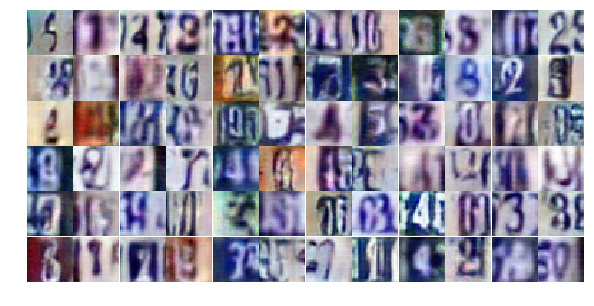

Epoch 18/25... Discriminator Loss: 0.4320... Generator Loss: 1.4598
Epoch 18/25... Discriminator Loss: 0.5021... Generator Loss: 1.3527
Epoch 18/25... Discriminator Loss: 0.4821... Generator Loss: 1.2707
Epoch 18/25... Discriminator Loss: 0.5670... Generator Loss: 1.1173
Epoch 18/25... Discriminator Loss: 1.0000... Generator Loss: 0.6210
Epoch 18/25... Discriminator Loss: 0.2681... Generator Loss: 1.8535
Epoch 18/25... Discriminator Loss: 0.8078... Generator Loss: 0.7829
Epoch 18/25... Discriminator Loss: 1.4531... Generator Loss: 3.4139
Epoch 18/25... Discriminator Loss: 0.4987... Generator Loss: 1.3940
Epoch 18/25... Discriminator Loss: 0.2788... Generator Loss: 2.1208


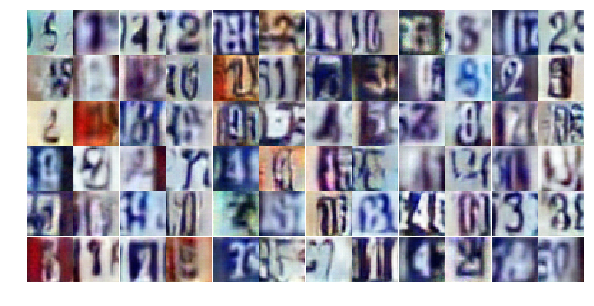

Epoch 18/25... Discriminator Loss: 0.8321... Generator Loss: 0.8171
Epoch 18/25... Discriminator Loss: 0.4740... Generator Loss: 1.3594
Epoch 18/25... Discriminator Loss: 0.6673... Generator Loss: 2.3260
Epoch 18/25... Discriminator Loss: 2.6356... Generator Loss: 3.5088
Epoch 18/25... Discriminator Loss: 1.5135... Generator Loss: 0.4185
Epoch 18/25... Discriminator Loss: 0.6652... Generator Loss: 1.1101
Epoch 18/25... Discriminator Loss: 0.5754... Generator Loss: 1.2504
Epoch 18/25... Discriminator Loss: 0.3787... Generator Loss: 1.5735
Epoch 18/25... Discriminator Loss: 1.3750... Generator Loss: 0.4213
Epoch 18/25... Discriminator Loss: 0.5797... Generator Loss: 1.0973


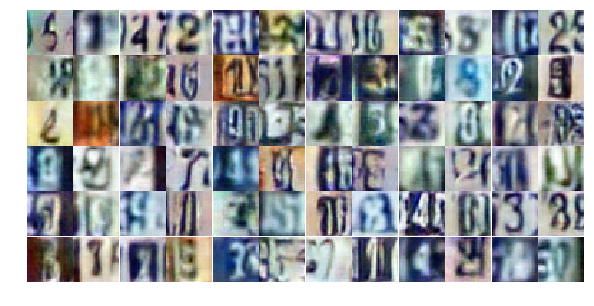

Epoch 18/25... Discriminator Loss: 0.6477... Generator Loss: 1.0636
Epoch 19/25... Discriminator Loss: 0.8435... Generator Loss: 0.8966
Epoch 19/25... Discriminator Loss: 0.7464... Generator Loss: 0.8793
Epoch 19/25... Discriminator Loss: 0.7079... Generator Loss: 1.0331
Epoch 19/25... Discriminator Loss: 0.5596... Generator Loss: 1.1500
Epoch 19/25... Discriminator Loss: 0.9029... Generator Loss: 0.7626
Epoch 19/25... Discriminator Loss: 0.3982... Generator Loss: 1.5809
Epoch 19/25... Discriminator Loss: 1.0276... Generator Loss: 0.7911
Epoch 19/25... Discriminator Loss: 0.4456... Generator Loss: 2.1184
Epoch 19/25... Discriminator Loss: 0.8527... Generator Loss: 0.7799


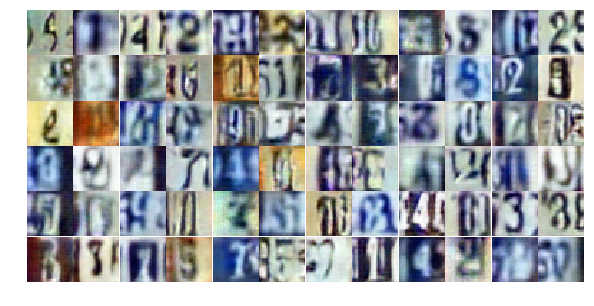

Epoch 19/25... Discriminator Loss: 0.4119... Generator Loss: 1.4987
Epoch 19/25... Discriminator Loss: 0.6987... Generator Loss: 0.9326
Epoch 19/25... Discriminator Loss: 0.6686... Generator Loss: 1.0885
Epoch 19/25... Discriminator Loss: 0.7593... Generator Loss: 0.8458
Epoch 19/25... Discriminator Loss: 0.8771... Generator Loss: 0.7637
Epoch 19/25... Discriminator Loss: 0.5179... Generator Loss: 1.4629
Epoch 19/25... Discriminator Loss: 0.6728... Generator Loss: 2.5927
Epoch 19/25... Discriminator Loss: 0.6141... Generator Loss: 1.1127
Epoch 19/25... Discriminator Loss: 0.7487... Generator Loss: 1.0598
Epoch 19/25... Discriminator Loss: 1.1455... Generator Loss: 0.5698


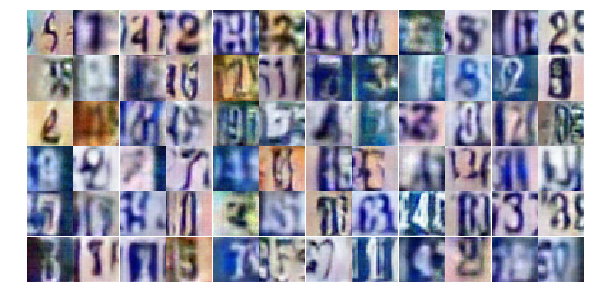

Epoch 19/25... Discriminator Loss: 0.4806... Generator Loss: 1.3233
Epoch 19/25... Discriminator Loss: 0.9447... Generator Loss: 1.0268
Epoch 19/25... Discriminator Loss: 1.0463... Generator Loss: 0.6253
Epoch 19/25... Discriminator Loss: 0.6391... Generator Loss: 1.0976
Epoch 19/25... Discriminator Loss: 1.2524... Generator Loss: 0.4691
Epoch 19/25... Discriminator Loss: 0.5538... Generator Loss: 1.7537
Epoch 19/25... Discriminator Loss: 0.5784... Generator Loss: 1.2346
Epoch 19/25... Discriminator Loss: 0.4203... Generator Loss: 1.4646
Epoch 19/25... Discriminator Loss: 0.6220... Generator Loss: 1.0074
Epoch 19/25... Discriminator Loss: 1.1477... Generator Loss: 0.6675


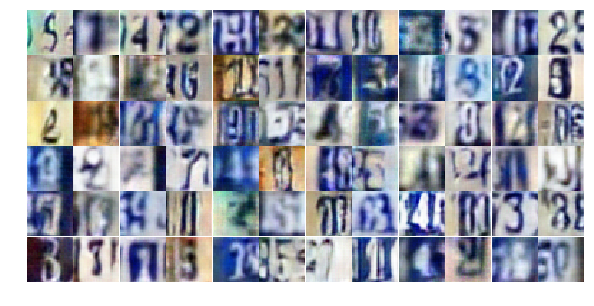

Epoch 19/25... Discriminator Loss: 0.4737... Generator Loss: 1.4281
Epoch 19/25... Discriminator Loss: 0.4535... Generator Loss: 1.3295
Epoch 19/25... Discriminator Loss: 0.8298... Generator Loss: 0.7661
Epoch 19/25... Discriminator Loss: 0.5907... Generator Loss: 1.1828
Epoch 19/25... Discriminator Loss: 0.4593... Generator Loss: 1.4298
Epoch 19/25... Discriminator Loss: 1.2835... Generator Loss: 1.2916
Epoch 19/25... Discriminator Loss: 1.2044... Generator Loss: 0.4886
Epoch 19/25... Discriminator Loss: 0.4873... Generator Loss: 1.4187
Epoch 19/25... Discriminator Loss: 0.7125... Generator Loss: 0.9554
Epoch 19/25... Discriminator Loss: 0.5146... Generator Loss: 1.1575


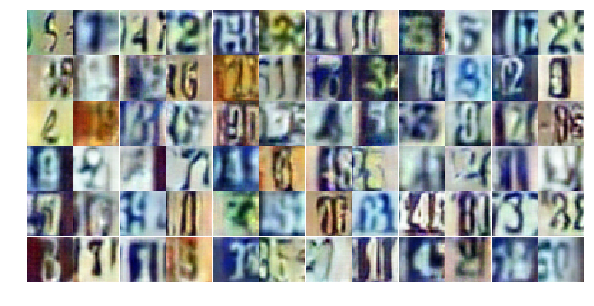

Epoch 19/25... Discriminator Loss: 0.4680... Generator Loss: 1.3149
Epoch 19/25... Discriminator Loss: 0.7371... Generator Loss: 0.9435
Epoch 19/25... Discriminator Loss: 0.5069... Generator Loss: 1.2768
Epoch 19/25... Discriminator Loss: 0.6190... Generator Loss: 1.1665
Epoch 19/25... Discriminator Loss: 0.4885... Generator Loss: 1.3212
Epoch 19/25... Discriminator Loss: 0.5497... Generator Loss: 1.2799
Epoch 19/25... Discriminator Loss: 0.4420... Generator Loss: 1.6311
Epoch 19/25... Discriminator Loss: 0.4670... Generator Loss: 1.2538
Epoch 19/25... Discriminator Loss: 0.4341... Generator Loss: 1.6072
Epoch 19/25... Discriminator Loss: 0.7557... Generator Loss: 0.9344


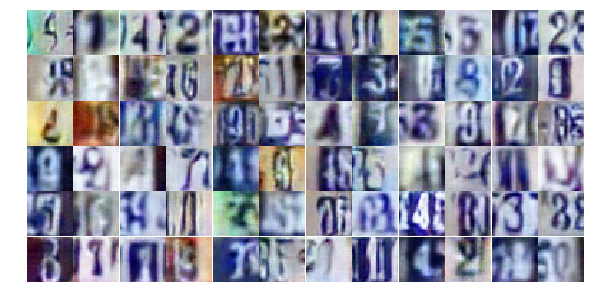

Epoch 19/25... Discriminator Loss: 0.4864... Generator Loss: 1.3830
Epoch 19/25... Discriminator Loss: 0.7248... Generator Loss: 0.8742
Epoch 19/25... Discriminator Loss: 0.4948... Generator Loss: 2.2134
Epoch 19/25... Discriminator Loss: 0.4850... Generator Loss: 1.5339
Epoch 19/25... Discriminator Loss: 0.7802... Generator Loss: 3.3398
Epoch 19/25... Discriminator Loss: 0.8991... Generator Loss: 0.7337
Epoch 19/25... Discriminator Loss: 1.5402... Generator Loss: 0.3684
Epoch 19/25... Discriminator Loss: 0.6352... Generator Loss: 1.1028
Epoch 20/25... Discriminator Loss: 0.4978... Generator Loss: 1.3437
Epoch 20/25... Discriminator Loss: 0.5899... Generator Loss: 1.1298


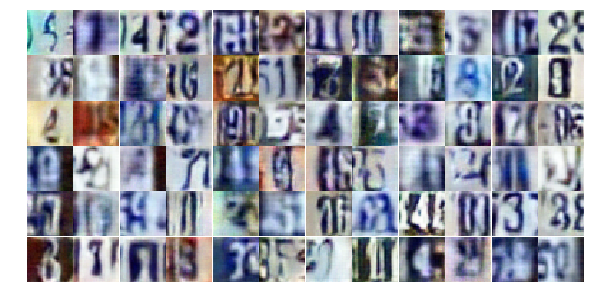

Epoch 20/25... Discriminator Loss: 0.4416... Generator Loss: 1.4248
Epoch 20/25... Discriminator Loss: 0.4948... Generator Loss: 1.5079
Epoch 20/25... Discriminator Loss: 2.0287... Generator Loss: 0.2491
Epoch 20/25... Discriminator Loss: 0.7043... Generator Loss: 1.3346
Epoch 20/25... Discriminator Loss: 0.5588... Generator Loss: 1.3913
Epoch 20/25... Discriminator Loss: 0.8177... Generator Loss: 1.0157
Epoch 20/25... Discriminator Loss: 0.6252... Generator Loss: 1.2998
Epoch 20/25... Discriminator Loss: 0.6255... Generator Loss: 1.1875
Epoch 20/25... Discriminator Loss: 0.6483... Generator Loss: 1.0959
Epoch 20/25... Discriminator Loss: 0.7487... Generator Loss: 0.8752


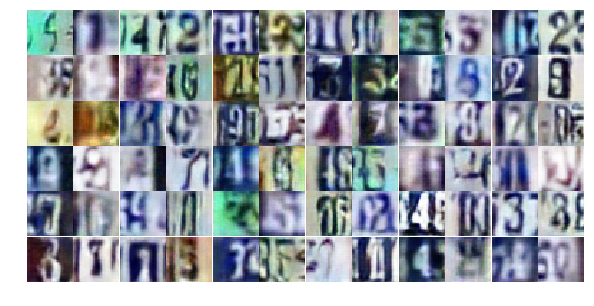

Epoch 20/25... Discriminator Loss: 0.9628... Generator Loss: 0.6922
Epoch 20/25... Discriminator Loss: 1.2299... Generator Loss: 0.4901
Epoch 20/25... Discriminator Loss: 0.7424... Generator Loss: 0.9353
Epoch 20/25... Discriminator Loss: 0.7546... Generator Loss: 0.8981
Epoch 20/25... Discriminator Loss: 0.9233... Generator Loss: 0.7408
Epoch 20/25... Discriminator Loss: 1.0153... Generator Loss: 0.6418
Epoch 20/25... Discriminator Loss: 0.8385... Generator Loss: 0.8491
Epoch 20/25... Discriminator Loss: 0.5500... Generator Loss: 1.1809
Epoch 20/25... Discriminator Loss: 0.4065... Generator Loss: 1.5996
Epoch 20/25... Discriminator Loss: 0.7181... Generator Loss: 0.9385


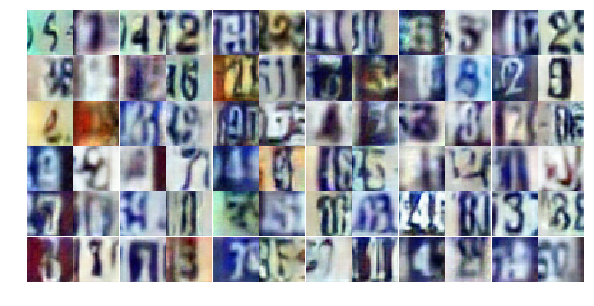

Epoch 20/25... Discriminator Loss: 0.4886... Generator Loss: 1.4319
Epoch 20/25... Discriminator Loss: 0.6117... Generator Loss: 1.2066
Epoch 20/25... Discriminator Loss: 0.2040... Generator Loss: 3.7062
Epoch 20/25... Discriminator Loss: 1.8157... Generator Loss: 0.2958
Epoch 20/25... Discriminator Loss: 1.2959... Generator Loss: 0.4980
Epoch 20/25... Discriminator Loss: 0.4784... Generator Loss: 1.3564
Epoch 20/25... Discriminator Loss: 0.7760... Generator Loss: 0.9968
Epoch 20/25... Discriminator Loss: 1.3504... Generator Loss: 0.4356
Epoch 20/25... Discriminator Loss: 0.9227... Generator Loss: 0.7499
Epoch 20/25... Discriminator Loss: 0.3971... Generator Loss: 1.4723


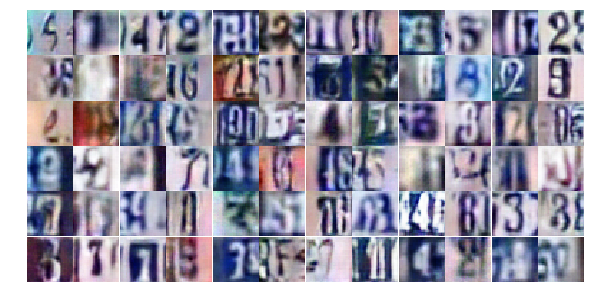

Epoch 20/25... Discriminator Loss: 0.7255... Generator Loss: 0.8795
Epoch 20/25... Discriminator Loss: 0.6664... Generator Loss: 0.9675
Epoch 20/25... Discriminator Loss: 0.7648... Generator Loss: 1.2296
Epoch 20/25... Discriminator Loss: 0.6474... Generator Loss: 1.0672
Epoch 20/25... Discriminator Loss: 0.7041... Generator Loss: 1.0216
Epoch 20/25... Discriminator Loss: 0.3896... Generator Loss: 1.8128
Epoch 20/25... Discriminator Loss: 0.4471... Generator Loss: 1.5012
Epoch 20/25... Discriminator Loss: 0.9591... Generator Loss: 0.7240
Epoch 20/25... Discriminator Loss: 0.5311... Generator Loss: 1.4545
Epoch 20/25... Discriminator Loss: 0.4764... Generator Loss: 1.5321


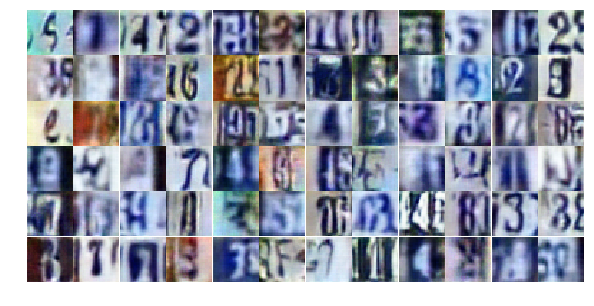

Epoch 20/25... Discriminator Loss: 0.4960... Generator Loss: 1.2433
Epoch 20/25... Discriminator Loss: 0.9377... Generator Loss: 0.6731
Epoch 20/25... Discriminator Loss: 2.8156... Generator Loss: 4.2506
Epoch 20/25... Discriminator Loss: 2.1610... Generator Loss: 0.2330
Epoch 20/25... Discriminator Loss: 1.0343... Generator Loss: 0.7892
Epoch 20/25... Discriminator Loss: 1.0261... Generator Loss: 0.7504
Epoch 20/25... Discriminator Loss: 0.7938... Generator Loss: 0.9234
Epoch 20/25... Discriminator Loss: 0.3594... Generator Loss: 1.6715
Epoch 20/25... Discriminator Loss: 0.6200... Generator Loss: 1.1080
Epoch 20/25... Discriminator Loss: 0.7435... Generator Loss: 0.9269


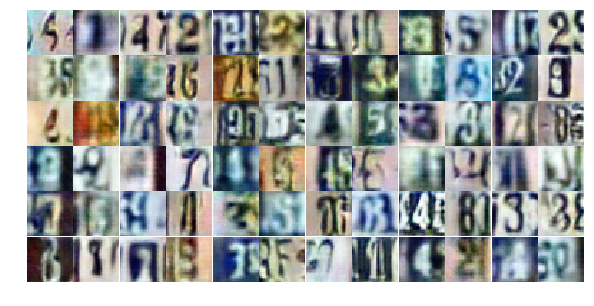

Epoch 20/25... Discriminator Loss: 0.4400... Generator Loss: 1.6149
Epoch 20/25... Discriminator Loss: 0.6522... Generator Loss: 1.2663
Epoch 20/25... Discriminator Loss: 0.3875... Generator Loss: 1.8933
Epoch 20/25... Discriminator Loss: 0.7701... Generator Loss: 0.9453
Epoch 20/25... Discriminator Loss: 0.5549... Generator Loss: 1.2001
Epoch 20/25... Discriminator Loss: 0.5969... Generator Loss: 1.0439
Epoch 21/25... Discriminator Loss: 0.6499... Generator Loss: 1.6602
Epoch 21/25... Discriminator Loss: 0.7730... Generator Loss: 0.8385
Epoch 21/25... Discriminator Loss: 1.3542... Generator Loss: 0.4040
Epoch 21/25... Discriminator Loss: 0.9728... Generator Loss: 0.7519


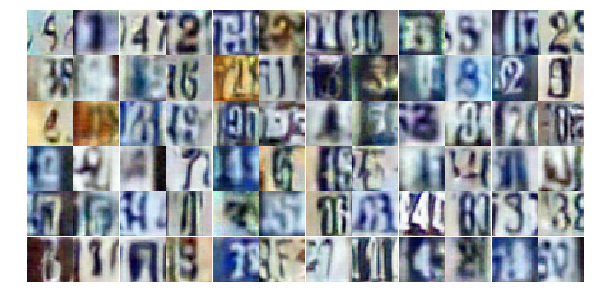

Epoch 21/25... Discriminator Loss: 0.5685... Generator Loss: 1.4573
Epoch 21/25... Discriminator Loss: 1.4890... Generator Loss: 0.4069
Epoch 21/25... Discriminator Loss: 0.3471... Generator Loss: 1.8247
Epoch 21/25... Discriminator Loss: 0.3707... Generator Loss: 1.5922
Epoch 21/25... Discriminator Loss: 0.8705... Generator Loss: 0.7375
Epoch 21/25... Discriminator Loss: 0.5194... Generator Loss: 1.2236
Epoch 21/25... Discriminator Loss: 0.4918... Generator Loss: 1.3431
Epoch 21/25... Discriminator Loss: 0.7031... Generator Loss: 1.1947
Epoch 21/25... Discriminator Loss: 0.4385... Generator Loss: 1.4075
Epoch 21/25... Discriminator Loss: 1.2445... Generator Loss: 0.5183


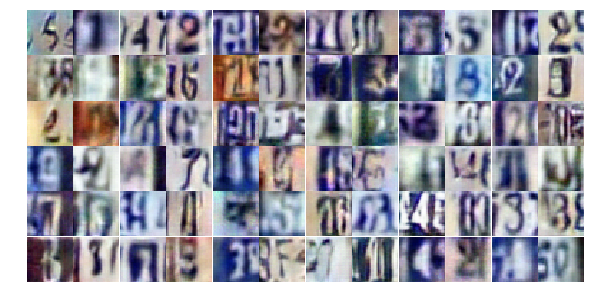

Epoch 21/25... Discriminator Loss: 0.2800... Generator Loss: 1.7824
Epoch 21/25... Discriminator Loss: 0.8524... Generator Loss: 0.8151
Epoch 21/25... Discriminator Loss: 1.6170... Generator Loss: 0.3576
Epoch 21/25... Discriminator Loss: 0.6386... Generator Loss: 1.3186
Epoch 21/25... Discriminator Loss: 0.3917... Generator Loss: 1.6616
Epoch 21/25... Discriminator Loss: 0.7715... Generator Loss: 1.0455
Epoch 21/25... Discriminator Loss: 0.8028... Generator Loss: 0.8753
Epoch 21/25... Discriminator Loss: 0.4097... Generator Loss: 1.5037
Epoch 21/25... Discriminator Loss: 0.4178... Generator Loss: 1.5960
Epoch 21/25... Discriminator Loss: 0.7378... Generator Loss: 0.9493


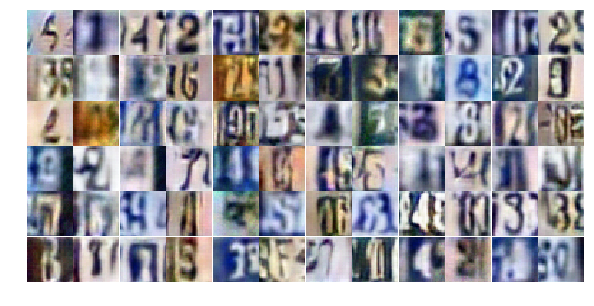

Epoch 21/25... Discriminator Loss: 1.1548... Generator Loss: 0.5646
Epoch 21/25... Discriminator Loss: 0.3279... Generator Loss: 1.6319
Epoch 21/25... Discriminator Loss: 1.6784... Generator Loss: 0.3002
Epoch 21/25... Discriminator Loss: 0.7659... Generator Loss: 0.8821
Epoch 21/25... Discriminator Loss: 0.8084... Generator Loss: 0.8052
Epoch 21/25... Discriminator Loss: 0.9395... Generator Loss: 0.6885
Epoch 21/25... Discriminator Loss: 0.3960... Generator Loss: 1.4061
Epoch 21/25... Discriminator Loss: 0.9853... Generator Loss: 0.6951
Epoch 21/25... Discriminator Loss: 0.8702... Generator Loss: 0.7768
Epoch 21/25... Discriminator Loss: 1.3285... Generator Loss: 0.6391


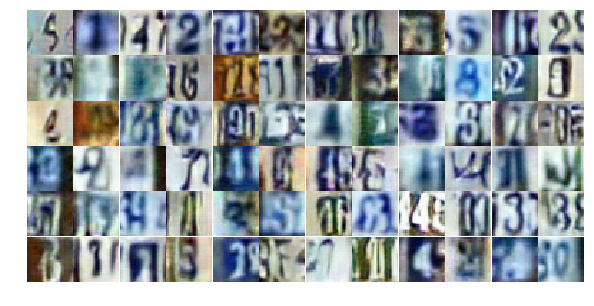

Epoch 21/25... Discriminator Loss: 1.2693... Generator Loss: 0.4679
Epoch 21/25... Discriminator Loss: 0.6708... Generator Loss: 1.0552
Epoch 21/25... Discriminator Loss: 0.9729... Generator Loss: 0.7234
Epoch 21/25... Discriminator Loss: 0.4646... Generator Loss: 1.7596
Epoch 21/25... Discriminator Loss: 0.4508... Generator Loss: 1.4313
Epoch 21/25... Discriminator Loss: 0.6179... Generator Loss: 1.0288
Epoch 21/25... Discriminator Loss: 0.4925... Generator Loss: 1.2404
Epoch 21/25... Discriminator Loss: 1.2299... Generator Loss: 0.5084
Epoch 21/25... Discriminator Loss: 0.7232... Generator Loss: 0.8551
Epoch 21/25... Discriminator Loss: 0.2116... Generator Loss: 2.9526


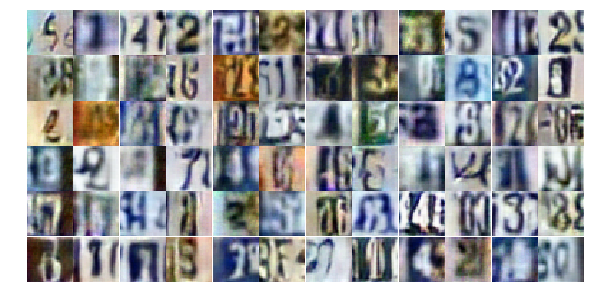

Epoch 21/25... Discriminator Loss: 0.6920... Generator Loss: 1.0519
Epoch 21/25... Discriminator Loss: 0.6292... Generator Loss: 1.1477
Epoch 21/25... Discriminator Loss: 0.6153... Generator Loss: 1.1405
Epoch 21/25... Discriminator Loss: 0.6560... Generator Loss: 1.0554
Epoch 21/25... Discriminator Loss: 0.2341... Generator Loss: 2.1313
Epoch 21/25... Discriminator Loss: 0.4517... Generator Loss: 1.4024
Epoch 21/25... Discriminator Loss: 0.7480... Generator Loss: 0.9189
Epoch 21/25... Discriminator Loss: 1.8869... Generator Loss: 0.2675
Epoch 21/25... Discriminator Loss: 2.3628... Generator Loss: 0.1662
Epoch 21/25... Discriminator Loss: 0.8394... Generator Loss: 1.0626


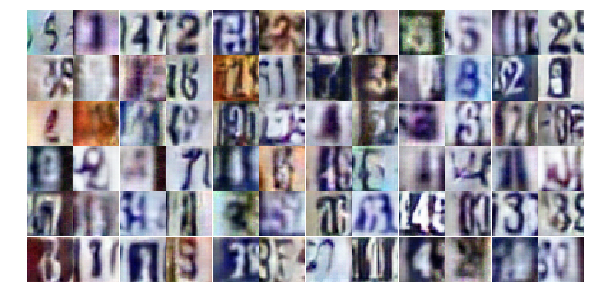

Epoch 21/25... Discriminator Loss: 0.5850... Generator Loss: 1.7051
Epoch 21/25... Discriminator Loss: 0.8959... Generator Loss: 0.8331
Epoch 21/25... Discriminator Loss: 0.4789... Generator Loss: 1.7618
Epoch 22/25... Discriminator Loss: 0.8376... Generator Loss: 1.7859
Epoch 22/25... Discriminator Loss: 1.0155... Generator Loss: 0.6829
Epoch 22/25... Discriminator Loss: 0.6071... Generator Loss: 1.1009
Epoch 22/25... Discriminator Loss: 0.4050... Generator Loss: 1.7815
Epoch 22/25... Discriminator Loss: 0.3547... Generator Loss: 1.6436
Epoch 22/25... Discriminator Loss: 1.2064... Generator Loss: 0.5353
Epoch 22/25... Discriminator Loss: 0.6677... Generator Loss: 1.1507


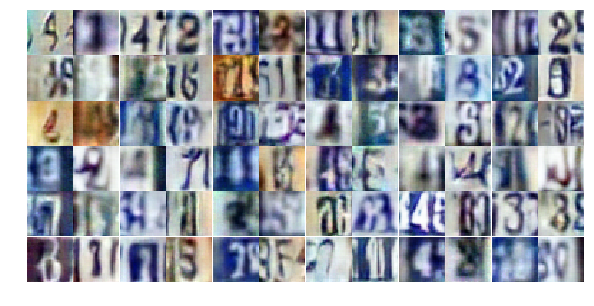

Epoch 22/25... Discriminator Loss: 0.4607... Generator Loss: 1.5208
Epoch 22/25... Discriminator Loss: 0.9672... Generator Loss: 0.8432
Epoch 22/25... Discriminator Loss: 1.2496... Generator Loss: 0.5171
Epoch 22/25... Discriminator Loss: 0.6896... Generator Loss: 0.9999
Epoch 22/25... Discriminator Loss: 0.5720... Generator Loss: 1.2949
Epoch 22/25... Discriminator Loss: 0.4770... Generator Loss: 1.4139
Epoch 22/25... Discriminator Loss: 0.6128... Generator Loss: 1.0651
Epoch 22/25... Discriminator Loss: 0.4153... Generator Loss: 1.5244
Epoch 22/25... Discriminator Loss: 0.7874... Generator Loss: 0.9641
Epoch 22/25... Discriminator Loss: 1.4841... Generator Loss: 0.4251


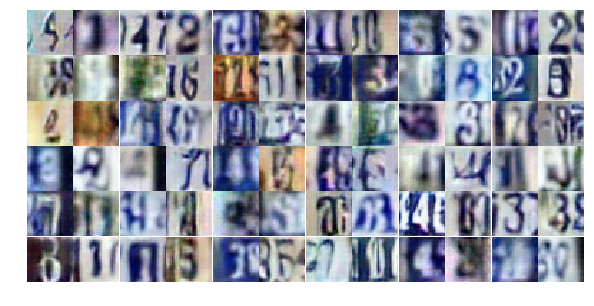

Epoch 22/25... Discriminator Loss: 0.3706... Generator Loss: 1.6271
Epoch 22/25... Discriminator Loss: 0.4859... Generator Loss: 1.2348
Epoch 22/25... Discriminator Loss: 0.8110... Generator Loss: 0.7955
Epoch 22/25... Discriminator Loss: 0.2990... Generator Loss: 2.4010
Epoch 22/25... Discriminator Loss: 0.4841... Generator Loss: 1.2274
Epoch 22/25... Discriminator Loss: 0.4628... Generator Loss: 1.3367
Epoch 22/25... Discriminator Loss: 0.2795... Generator Loss: 1.8353
Epoch 22/25... Discriminator Loss: 0.4868... Generator Loss: 1.2316
Epoch 22/25... Discriminator Loss: 0.4786... Generator Loss: 1.2557
Epoch 22/25... Discriminator Loss: 1.6111... Generator Loss: 0.3478


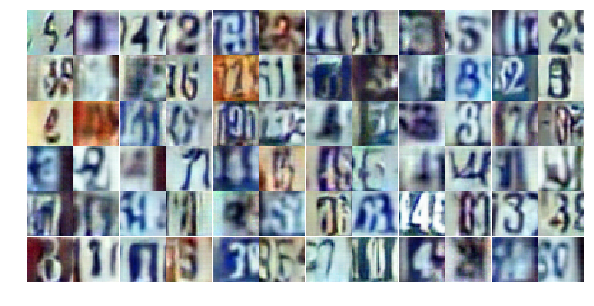

Epoch 22/25... Discriminator Loss: 0.2271... Generator Loss: 2.3764
Epoch 22/25... Discriminator Loss: 0.5243... Generator Loss: 1.4671
Epoch 22/25... Discriminator Loss: 0.6122... Generator Loss: 1.3116
Epoch 22/25... Discriminator Loss: 0.8557... Generator Loss: 0.8485
Epoch 22/25... Discriminator Loss: 0.8426... Generator Loss: 0.8276
Epoch 22/25... Discriminator Loss: 0.7675... Generator Loss: 0.9674
Epoch 22/25... Discriminator Loss: 1.1900... Generator Loss: 0.5089
Epoch 22/25... Discriminator Loss: 0.5694... Generator Loss: 1.1473
Epoch 22/25... Discriminator Loss: 0.5359... Generator Loss: 1.3851
Epoch 22/25... Discriminator Loss: 0.6208... Generator Loss: 1.1090


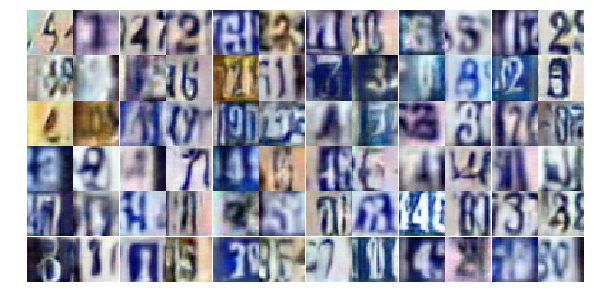

Epoch 22/25... Discriminator Loss: 0.7951... Generator Loss: 0.8877
Epoch 22/25... Discriminator Loss: 0.3050... Generator Loss: 1.8360
Epoch 22/25... Discriminator Loss: 0.6788... Generator Loss: 0.9794
Epoch 22/25... Discriminator Loss: 0.7071... Generator Loss: 0.9769
Epoch 22/25... Discriminator Loss: 0.5102... Generator Loss: 1.1747
Epoch 22/25... Discriminator Loss: 0.3499... Generator Loss: 1.5171
Epoch 22/25... Discriminator Loss: 0.6555... Generator Loss: 1.0517
Epoch 22/25... Discriminator Loss: 0.5291... Generator Loss: 1.2894
Epoch 22/25... Discriminator Loss: 1.6270... Generator Loss: 0.7608
Epoch 22/25... Discriminator Loss: 1.1912... Generator Loss: 0.5755


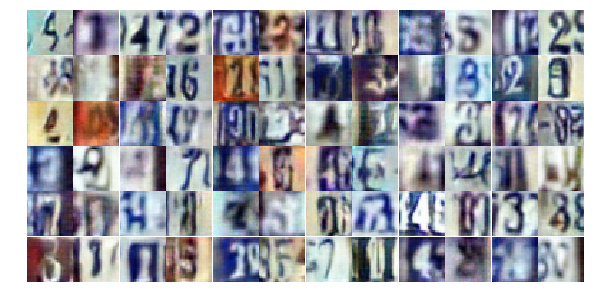

Epoch 22/25... Discriminator Loss: 0.7828... Generator Loss: 0.8724
Epoch 22/25... Discriminator Loss: 0.3982... Generator Loss: 1.7127
Epoch 22/25... Discriminator Loss: 0.6499... Generator Loss: 1.0746
Epoch 22/25... Discriminator Loss: 0.9299... Generator Loss: 0.8388
Epoch 22/25... Discriminator Loss: 0.8152... Generator Loss: 0.8232
Epoch 22/25... Discriminator Loss: 0.7632... Generator Loss: 0.9950
Epoch 22/25... Discriminator Loss: 0.7909... Generator Loss: 0.8829
Epoch 22/25... Discriminator Loss: 0.3275... Generator Loss: 1.6289
Epoch 22/25... Discriminator Loss: 0.7058... Generator Loss: 1.5042
Epoch 22/25... Discriminator Loss: 0.6939... Generator Loss: 0.9867


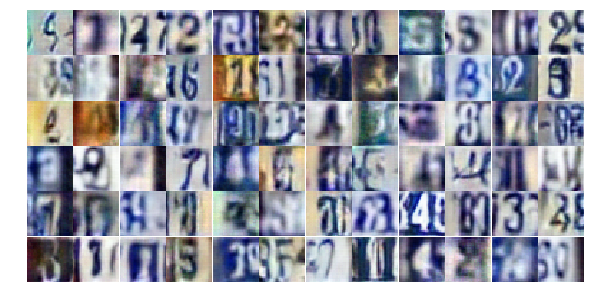

Epoch 23/25... Discriminator Loss: 0.4965... Generator Loss: 1.2737
Epoch 23/25... Discriminator Loss: 0.2618... Generator Loss: 1.9835
Epoch 23/25... Discriminator Loss: 0.9937... Generator Loss: 0.7657
Epoch 23/25... Discriminator Loss: 0.4411... Generator Loss: 1.6375
Epoch 23/25... Discriminator Loss: 0.7141... Generator Loss: 0.9202
Epoch 23/25... Discriminator Loss: 1.1911... Generator Loss: 0.5861
Epoch 23/25... Discriminator Loss: 0.6121... Generator Loss: 1.1925
Epoch 23/25... Discriminator Loss: 0.5639... Generator Loss: 1.1211
Epoch 23/25... Discriminator Loss: 0.5739... Generator Loss: 1.3550
Epoch 23/25... Discriminator Loss: 0.3504... Generator Loss: 1.7288


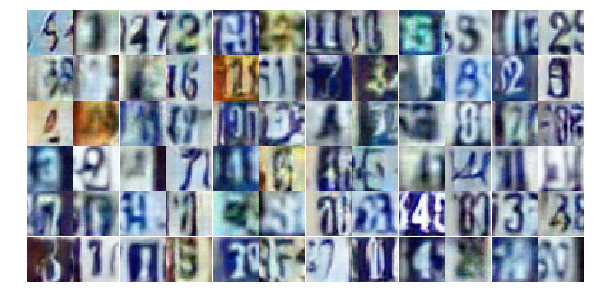

Epoch 23/25... Discriminator Loss: 0.6950... Generator Loss: 0.9590
Epoch 23/25... Discriminator Loss: 0.8169... Generator Loss: 0.7727
Epoch 23/25... Discriminator Loss: 0.4112... Generator Loss: 3.1817
Epoch 23/25... Discriminator Loss: 1.1894... Generator Loss: 4.2195
Epoch 23/25... Discriminator Loss: 0.6988... Generator Loss: 1.0476
Epoch 23/25... Discriminator Loss: 0.9271... Generator Loss: 0.7162
Epoch 23/25... Discriminator Loss: 1.0871... Generator Loss: 0.5876
Epoch 23/25... Discriminator Loss: 0.5810... Generator Loss: 1.2140
Epoch 23/25... Discriminator Loss: 0.6215... Generator Loss: 1.2560
Epoch 23/25... Discriminator Loss: 0.9185... Generator Loss: 0.7844


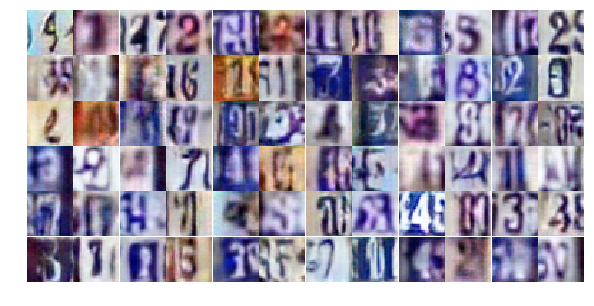

Epoch 23/25... Discriminator Loss: 0.9277... Generator Loss: 0.7627
Epoch 23/25... Discriminator Loss: 0.5343... Generator Loss: 1.4997
Epoch 23/25... Discriminator Loss: 1.0127... Generator Loss: 0.7138
Epoch 23/25... Discriminator Loss: 0.6062... Generator Loss: 1.1716
Epoch 23/25... Discriminator Loss: 0.3448... Generator Loss: 1.8649
Epoch 23/25... Discriminator Loss: 0.7231... Generator Loss: 1.0390
Epoch 23/25... Discriminator Loss: 0.6972... Generator Loss: 0.9618
Epoch 23/25... Discriminator Loss: 0.8477... Generator Loss: 0.7910
Epoch 23/25... Discriminator Loss: 0.4638... Generator Loss: 1.4699
Epoch 23/25... Discriminator Loss: 0.9705... Generator Loss: 0.6996


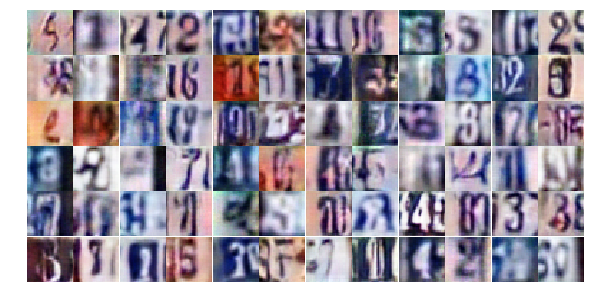

Epoch 23/25... Discriminator Loss: 0.3215... Generator Loss: 1.8067
Epoch 23/25... Discriminator Loss: 0.3622... Generator Loss: 1.9181
Epoch 23/25... Discriminator Loss: 0.4551... Generator Loss: 1.4790
Epoch 23/25... Discriminator Loss: 1.0897... Generator Loss: 0.5974
Epoch 23/25... Discriminator Loss: 0.8199... Generator Loss: 0.9696
Epoch 23/25... Discriminator Loss: 0.8264... Generator Loss: 0.8239
Epoch 23/25... Discriminator Loss: 1.1713... Generator Loss: 0.5869
Epoch 23/25... Discriminator Loss: 0.4407... Generator Loss: 1.5280
Epoch 23/25... Discriminator Loss: 0.3712... Generator Loss: 1.4892
Epoch 23/25... Discriminator Loss: 0.4341... Generator Loss: 1.3036


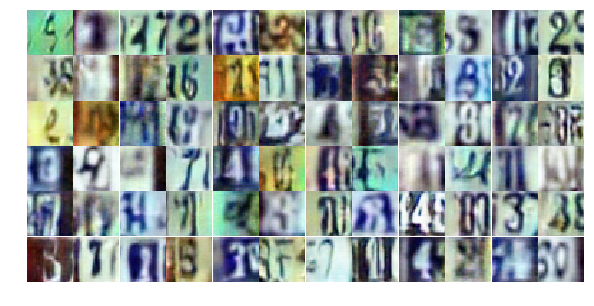

Epoch 23/25... Discriminator Loss: 0.6181... Generator Loss: 1.2952
Epoch 23/25... Discriminator Loss: 0.4580... Generator Loss: 1.4909
Epoch 23/25... Discriminator Loss: 1.0878... Generator Loss: 0.5988
Epoch 23/25... Discriminator Loss: 0.6064... Generator Loss: 1.1669
Epoch 23/25... Discriminator Loss: 0.6259... Generator Loss: 1.1066
Epoch 23/25... Discriminator Loss: 0.8455... Generator Loss: 0.7488
Epoch 23/25... Discriminator Loss: 0.4955... Generator Loss: 1.3251
Epoch 23/25... Discriminator Loss: 1.2131... Generator Loss: 0.5245
Epoch 23/25... Discriminator Loss: 0.5690... Generator Loss: 1.2850
Epoch 23/25... Discriminator Loss: 0.6245... Generator Loss: 1.2157


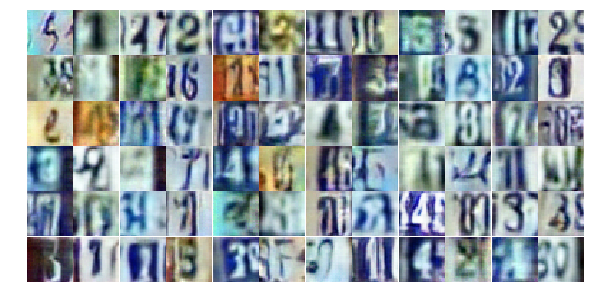

Epoch 23/25... Discriminator Loss: 0.4252... Generator Loss: 1.5060
Epoch 23/25... Discriminator Loss: 1.4993... Generator Loss: 0.4172
Epoch 23/25... Discriminator Loss: 1.6423... Generator Loss: 0.4598
Epoch 23/25... Discriminator Loss: 0.3964... Generator Loss: 1.5037
Epoch 23/25... Discriminator Loss: 1.8108... Generator Loss: 0.3274
Epoch 23/25... Discriminator Loss: 0.6057... Generator Loss: 3.1929
Epoch 23/25... Discriminator Loss: 0.4013... Generator Loss: 1.6866
Epoch 24/25... Discriminator Loss: 1.5223... Generator Loss: 0.4108
Epoch 24/25... Discriminator Loss: 0.5667... Generator Loss: 1.2664
Epoch 24/25... Discriminator Loss: 0.8868... Generator Loss: 0.9793


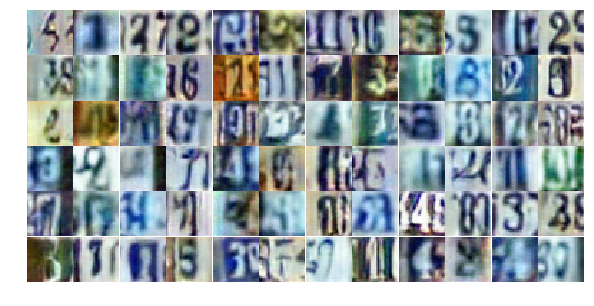

Epoch 24/25... Discriminator Loss: 0.4527... Generator Loss: 1.4599
Epoch 24/25... Discriminator Loss: 0.6299... Generator Loss: 1.1047
Epoch 24/25... Discriminator Loss: 0.4316... Generator Loss: 1.4478
Epoch 24/25... Discriminator Loss: 0.9117... Generator Loss: 0.7511
Epoch 24/25... Discriminator Loss: 0.8794... Generator Loss: 0.7718
Epoch 24/25... Discriminator Loss: 0.4034... Generator Loss: 1.6469
Epoch 24/25... Discriminator Loss: 0.4672... Generator Loss: 1.4096
Epoch 24/25... Discriminator Loss: 1.3627... Generator Loss: 0.5151
Epoch 24/25... Discriminator Loss: 0.3737... Generator Loss: 1.5601
Epoch 24/25... Discriminator Loss: 0.4224... Generator Loss: 1.8869


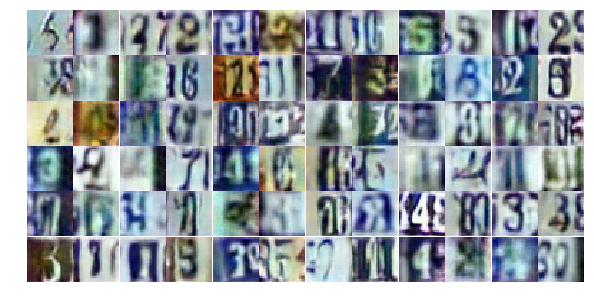

Epoch 24/25... Discriminator Loss: 2.8107... Generator Loss: 0.2647
Epoch 24/25... Discriminator Loss: 1.2518... Generator Loss: 0.5334
Epoch 24/25... Discriminator Loss: 1.5214... Generator Loss: 0.4163
Epoch 24/25... Discriminator Loss: 0.6488... Generator Loss: 0.9619
Epoch 24/25... Discriminator Loss: 0.3862... Generator Loss: 1.8975
Epoch 24/25... Discriminator Loss: 0.8389... Generator Loss: 0.8840
Epoch 24/25... Discriminator Loss: 0.2907... Generator Loss: 2.2644
Epoch 24/25... Discriminator Loss: 0.9857... Generator Loss: 0.7093
Epoch 24/25... Discriminator Loss: 0.7163... Generator Loss: 0.9532
Epoch 24/25... Discriminator Loss: 0.7109... Generator Loss: 0.9840


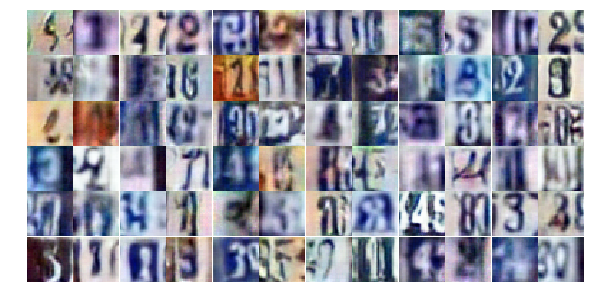

Epoch 24/25... Discriminator Loss: 0.8201... Generator Loss: 0.8431
Epoch 24/25... Discriminator Loss: 0.6303... Generator Loss: 1.0915
Epoch 24/25... Discriminator Loss: 0.5976... Generator Loss: 1.0236
Epoch 24/25... Discriminator Loss: 1.3064... Generator Loss: 0.4809
Epoch 24/25... Discriminator Loss: 0.6964... Generator Loss: 0.9015
Epoch 24/25... Discriminator Loss: 0.5561... Generator Loss: 1.2256
Epoch 24/25... Discriminator Loss: 0.3132... Generator Loss: 1.7892
Epoch 24/25... Discriminator Loss: 0.5806... Generator Loss: 1.1711
Epoch 24/25... Discriminator Loss: 0.5421... Generator Loss: 1.2471
Epoch 24/25... Discriminator Loss: 0.6048... Generator Loss: 1.0666


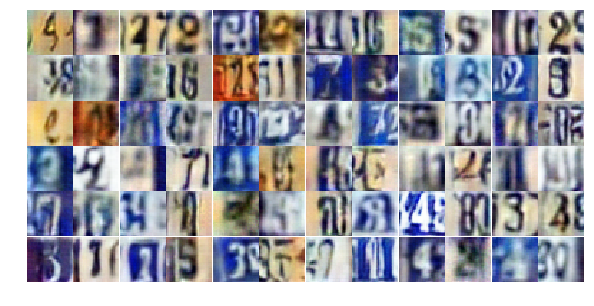

Epoch 24/25... Discriminator Loss: 0.5354... Generator Loss: 1.1580
Epoch 24/25... Discriminator Loss: 0.8034... Generator Loss: 0.9080
Epoch 24/25... Discriminator Loss: 0.7901... Generator Loss: 0.8508
Epoch 24/25... Discriminator Loss: 1.5542... Generator Loss: 0.3617
Epoch 24/25... Discriminator Loss: 0.8179... Generator Loss: 0.8490
Epoch 24/25... Discriminator Loss: 0.5865... Generator Loss: 1.1491
Epoch 24/25... Discriminator Loss: 0.9407... Generator Loss: 0.6916
Epoch 24/25... Discriminator Loss: 0.8661... Generator Loss: 0.7225
Epoch 24/25... Discriminator Loss: 0.7686... Generator Loss: 0.8283
Epoch 24/25... Discriminator Loss: 0.5682... Generator Loss: 2.4054


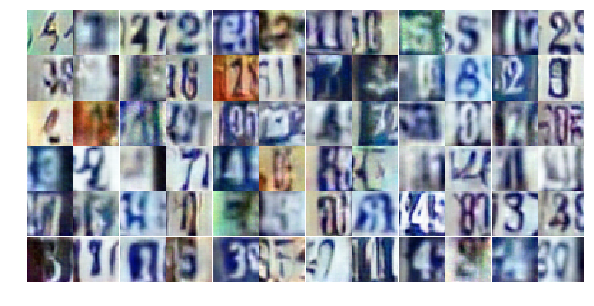

Epoch 24/25... Discriminator Loss: 1.0300... Generator Loss: 0.6812
Epoch 24/25... Discriminator Loss: 1.3870... Generator Loss: 0.4541
Epoch 24/25... Discriminator Loss: 1.4048... Generator Loss: 0.4331
Epoch 24/25... Discriminator Loss: 0.5687... Generator Loss: 1.7537
Epoch 24/25... Discriminator Loss: 1.5691... Generator Loss: 0.3921
Epoch 24/25... Discriminator Loss: 0.5839... Generator Loss: 1.1335
Epoch 24/25... Discriminator Loss: 0.5328... Generator Loss: 1.2993
Epoch 24/25... Discriminator Loss: 0.3559... Generator Loss: 1.6930
Epoch 24/25... Discriminator Loss: 0.6742... Generator Loss: 1.0385
Epoch 24/25... Discriminator Loss: 1.0457... Generator Loss: 0.7121


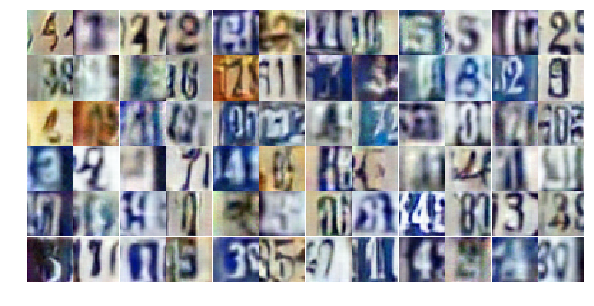

Epoch 24/25... Discriminator Loss: 0.6930... Generator Loss: 0.9311
Epoch 24/25... Discriminator Loss: 1.0567... Generator Loss: 0.5997
Epoch 24/25... Discriminator Loss: 0.8727... Generator Loss: 0.9219
Epoch 24/25... Discriminator Loss: 0.4998... Generator Loss: 1.7979
Epoch 24/25... Discriminator Loss: 1.2483... Generator Loss: 0.5940
Epoch 25/25... Discriminator Loss: 0.8089... Generator Loss: 0.8644
Epoch 25/25... Discriminator Loss: 0.3872... Generator Loss: 2.2094
Epoch 25/25... Discriminator Loss: 0.6532... Generator Loss: 1.0076
Epoch 25/25... Discriminator Loss: 0.6890... Generator Loss: 1.0319
Epoch 25/25... Discriminator Loss: 0.8065... Generator Loss: 0.8353


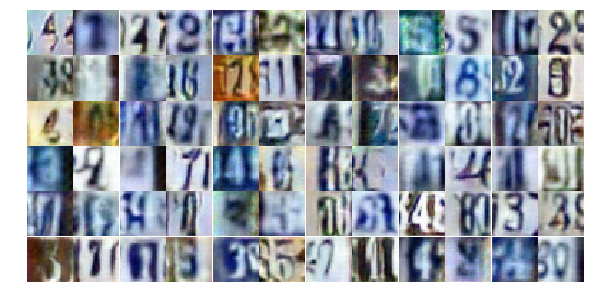

Epoch 25/25... Discriminator Loss: 0.7676... Generator Loss: 0.8425
Epoch 25/25... Discriminator Loss: 1.3036... Generator Loss: 0.5298
Epoch 25/25... Discriminator Loss: 0.9818... Generator Loss: 0.7334
Epoch 25/25... Discriminator Loss: 1.0007... Generator Loss: 0.6542
Epoch 25/25... Discriminator Loss: 0.6111... Generator Loss: 1.5495
Epoch 25/25... Discriminator Loss: 1.4227... Generator Loss: 0.4360
Epoch 25/25... Discriminator Loss: 0.4888... Generator Loss: 2.7090
Epoch 25/25... Discriminator Loss: 3.1653... Generator Loss: 0.1136
Epoch 25/25... Discriminator Loss: 2.3823... Generator Loss: 2.6653
Epoch 25/25... Discriminator Loss: 1.7932... Generator Loss: 0.5892


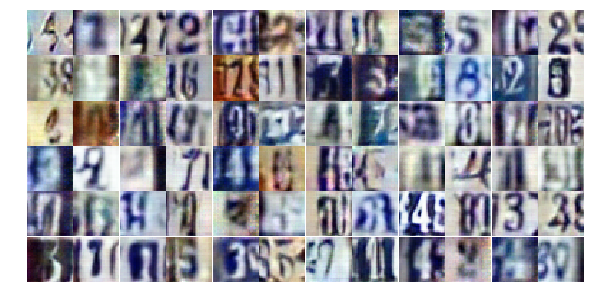

Epoch 25/25... Discriminator Loss: 1.5151... Generator Loss: 0.4632
Epoch 25/25... Discriminator Loss: 0.6601... Generator Loss: 1.2928
Epoch 25/25... Discriminator Loss: 0.8025... Generator Loss: 1.0138
Epoch 25/25... Discriminator Loss: 0.7293... Generator Loss: 1.1770
Epoch 25/25... Discriminator Loss: 0.5763... Generator Loss: 1.2063
Epoch 25/25... Discriminator Loss: 0.5602... Generator Loss: 1.1828
Epoch 25/25... Discriminator Loss: 0.6797... Generator Loss: 1.0626
Epoch 25/25... Discriminator Loss: 0.9977... Generator Loss: 0.6687
Epoch 25/25... Discriminator Loss: 0.4769... Generator Loss: 1.6494
Epoch 25/25... Discriminator Loss: 0.9407... Generator Loss: 0.7629


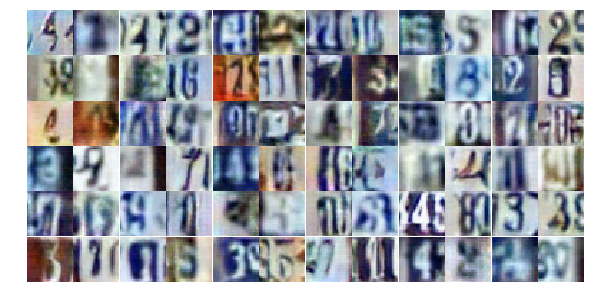

Epoch 25/25... Discriminator Loss: 0.7399... Generator Loss: 0.9492
Epoch 25/25... Discriminator Loss: 0.4844... Generator Loss: 1.3395
Epoch 25/25... Discriminator Loss: 0.9766... Generator Loss: 0.9374
Epoch 25/25... Discriminator Loss: 0.4720... Generator Loss: 1.3837
Epoch 25/25... Discriminator Loss: 0.7364... Generator Loss: 0.9439
Epoch 25/25... Discriminator Loss: 0.4775... Generator Loss: 1.3281
Epoch 25/25... Discriminator Loss: 0.8294... Generator Loss: 0.8091
Epoch 25/25... Discriminator Loss: 0.6058... Generator Loss: 1.1082
Epoch 25/25... Discriminator Loss: 0.8534... Generator Loss: 1.0317
Epoch 25/25... Discriminator Loss: 0.4325... Generator Loss: 1.5422


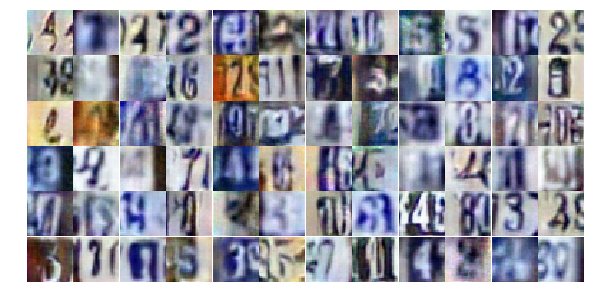

Epoch 25/25... Discriminator Loss: 0.6139... Generator Loss: 1.1595
Epoch 25/25... Discriminator Loss: 0.6222... Generator Loss: 1.0223
Epoch 25/25... Discriminator Loss: 0.4977... Generator Loss: 1.2496
Epoch 25/25... Discriminator Loss: 0.5011... Generator Loss: 1.3554
Epoch 25/25... Discriminator Loss: 1.1397... Generator Loss: 0.6704
Epoch 25/25... Discriminator Loss: 0.6480... Generator Loss: 1.1464
Epoch 25/25... Discriminator Loss: 0.4908... Generator Loss: 1.3559
Epoch 25/25... Discriminator Loss: 0.5650... Generator Loss: 1.1272
Epoch 25/25... Discriminator Loss: 1.3970... Generator Loss: 0.5638
Epoch 25/25... Discriminator Loss: 0.2726... Generator Loss: 1.9298


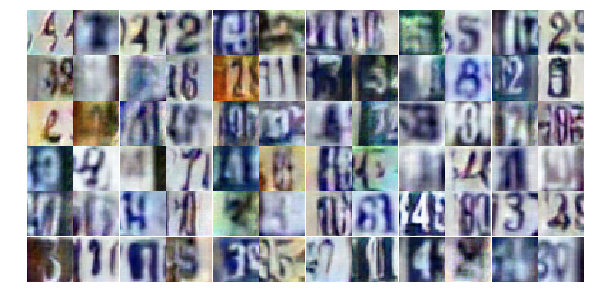

Epoch 25/25... Discriminator Loss: 0.6586... Generator Loss: 1.9110
Epoch 25/25... Discriminator Loss: 0.7842... Generator Loss: 0.8853
Epoch 25/25... Discriminator Loss: 0.6702... Generator Loss: 1.1567
Epoch 25/25... Discriminator Loss: 0.8553... Generator Loss: 0.8248
Epoch 25/25... Discriminator Loss: 0.8141... Generator Loss: 0.8590
Epoch 25/25... Discriminator Loss: 0.6324... Generator Loss: 1.0512
Epoch 25/25... Discriminator Loss: 0.6408... Generator Loss: 1.2827
Epoch 25/25... Discriminator Loss: 0.4681... Generator Loss: 1.4092
Epoch 25/25... Discriminator Loss: 0.8207... Generator Loss: 0.8185
Epoch 25/25... Discriminator Loss: 1.2459... Generator Loss: 0.6150


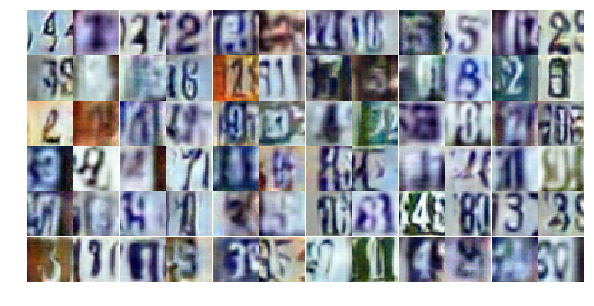

Epoch 25/25... Discriminator Loss: 1.1576... Generator Loss: 0.6553
Epoch 25/25... Discriminator Loss: 1.1741... Generator Loss: 0.5583


In [131]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

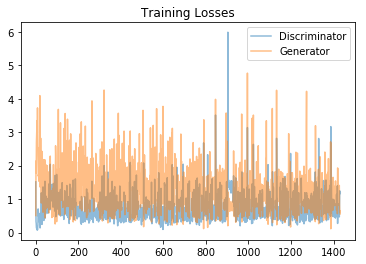

In [136]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

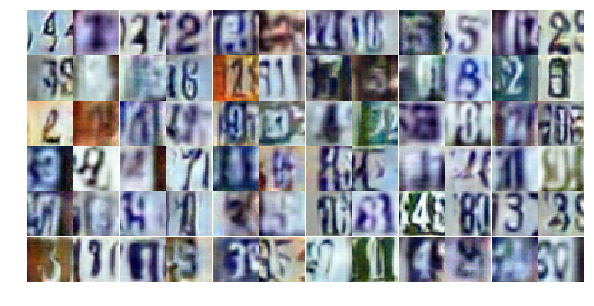

In [139]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))